## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'agriVision-full' 
TRANSFORM = 'learned'
CHANNEL = ''

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
learned_full_agriVision.ipynb


In [3]:
import git
from pathlib import Path
import os

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/agriVision/full/learned'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))
nonskewed_df = pd.read_csv(os.path.join(ROOT_DIR, 'learned-filters', 'nonskewed_filter_idxs_df.csv')).set_index(['dataset', 'num_images', 'num_bootstrap'])
nonskewed_filter_idxs = eval(nonskewed_df.loc[DATA_NAME].sort_values('num_images', ascending=False)['nonskewed_filter_idxs'].iloc[0])
filter_group_map = pd.read_pickle(os.path.join(ROOT_DIR, 'learned-filters', 'filter_group_map.pickle'))

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 786432000,
 1: 786432000,
 2: 786432000,
 3: 786432000,
 4: 786432000,
 5: 786432000,
 6: 786432000,
 7: 786432000,
 8: 786432000,
 9: 786432000,
 10: 786432000,
 11: 786432000,
 12: 786432000,
 13: 786432000,
 14: 786432000,
 15: 786432000,
 16: 786432000,
 17: 786432000,
 18: 786432000,
 19: 786432000,
 20: 786432000,
 21: 786432000,
 22: 786432000,
 23: 786432000,
 24: 786432000,
 25: 786432000,
 26: 786432000,
 27: 786432000,
 28: 786432000,
 29: 786432000,
 30: 786432000,
 31: 786432000,
 32: 786432000,
 33: 786432000,
 34: 786432000,
 35: 786432000,
 36: 786432000,
 37: 786432000,
 38: 786432000,
 39: 786432000,
 40: 786432000,
 41: 786432000,
 42: 786432000,
 43: 786432000,
 44: 786432000,
 45: 786432000,
 46: 786432000,
 47: 786432000,
 48: 786432000,
 49: 786432000,
 50: 786432000,
 51: 786432000,
 52: 786432000,
 53: 786432000,
 54: 786432000,
 55: 786432000,
 56: 786432000,
 57: 786432000,
 58: 786432000,
 59: 786432000,
 60: 786432000,
 61: 786432000,
 62: 786432000,
 6

Running 12760 CDFs


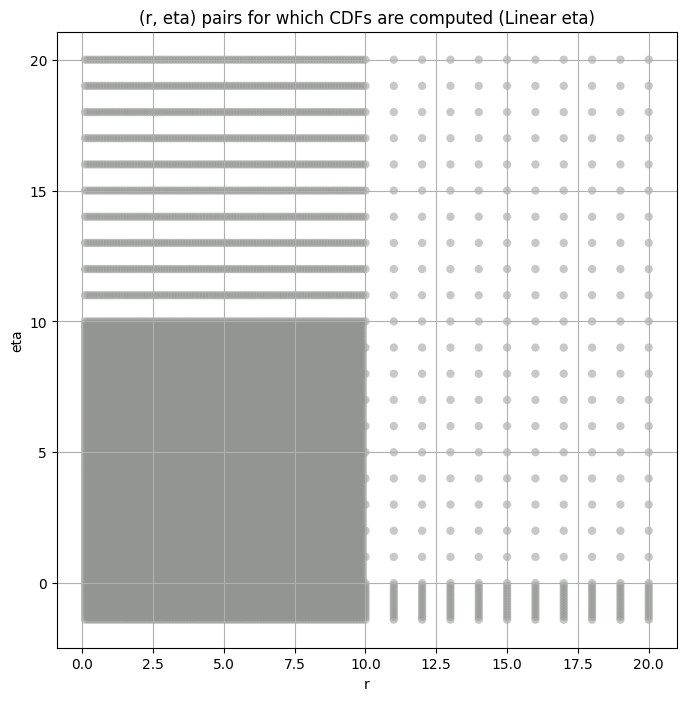

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = filter_group_map[group]

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 42


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 43


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 44


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 45


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 46


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 47


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 48


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 49


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 50


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 52


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 54


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 55


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 56


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 57


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 58


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 59


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 60


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 61


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 62


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 63


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,102.855110,34.849758,997.697198,1502.615755,7.320611,862.964342,786432000.0,dual_color
2,139.086423,48.057759,1221.082277,1361.038621,5.617098,888.334774,786432000.0,dual_color
3,59.225396,17.890088,677.785535,4588.658273,14.044662,919.821907,786432000.0,single_edge
4,147.182613,50.443288,1229.274555,1431.721726,6.789153,824.932666,786432000.0,dual_color
5,61.703786,18.847785,682.077717,2256.644242,8.930134,918.159627,786432000.0,dual_color
6,53.870009,16.817911,754.619495,3445.876441,7.006285,909.048889,786432000.0,single_edge
7,73.311829,24.301443,517.953978,864.939042,6.691776,794.740489,786432000.0,inside_out
8,2.374744,0.544201,65.257886,9343.251562,9.472070,970.760321,786432000.0,misc
9,21.870066,3.657099,637.020372,13315.085018,13.594812,969.358189,786432000.0,multi_edge


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,102.855110,102.855110,52.647196,45.186614,38.766630
2,139.086423,139.086423,70.227221,60.437111,52.607101
3,59.225396,59.225396,29.103594,24.780590,20.296453
4,147.182613,147.182613,73.045761,63.512264,55.148499
5,61.703786,61.703786,29.085961,25.009219,21.285562
6,53.870009,53.870009,25.549352,22.185090,19.276955
7,73.311829,73.311829,38.122552,31.992101,26.857150
8,2.374744,2.374744,0.831110,0.709418,0.605454
9,21.870066,21.870066,6.147859,5.198428,4.339409


####
Filter_idx  0


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.022533080357146643 102.85510963770844


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.007562268027558772 52.647196095982366


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.004123617234080723 45.18661416598332


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.0035318399181399895 38.76662969623278
Number of samples: 100000, Without approximation : 786432000.0


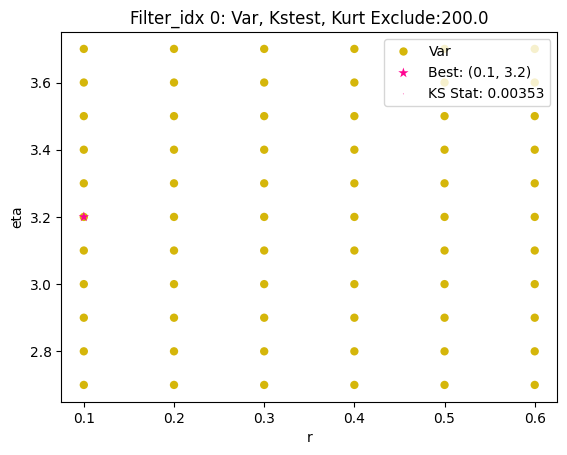

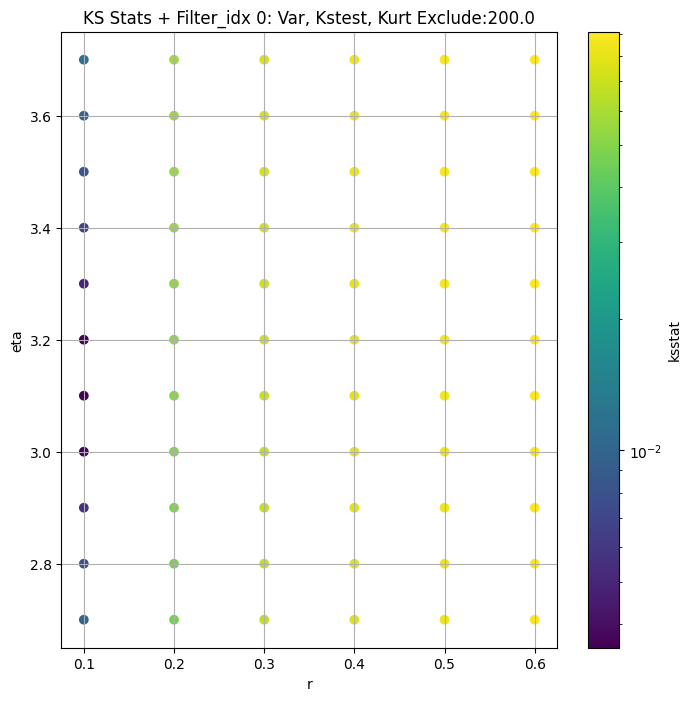

####
Filter_idx  2


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.02126846004439642 139.0864226108086


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.0049036949246716866 70.22722095402338


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.0024957968588637525 60.43711063366751


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.0027495071617689238 52.60710132359016
Number of samples: 100000, Without approximation : 786432000.0


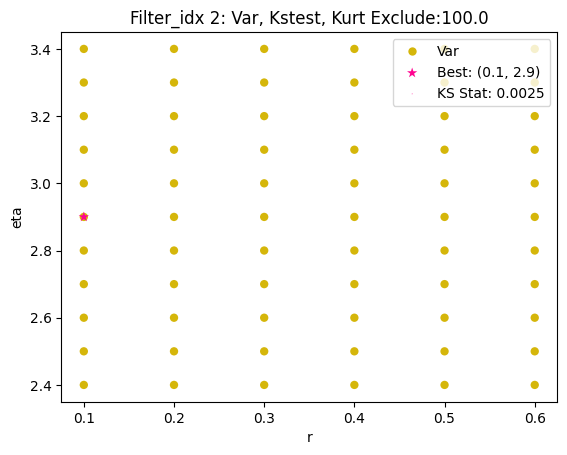

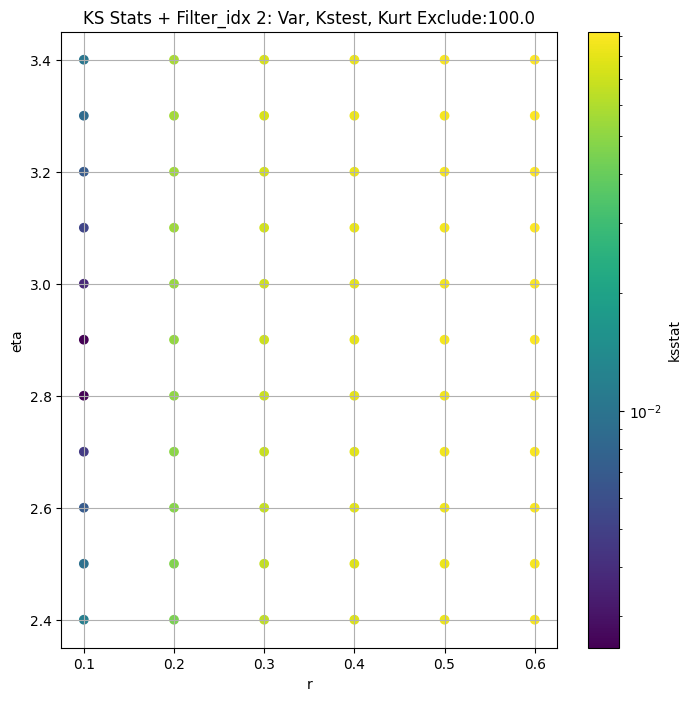

####
Filter_idx  3


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.027973823231155492 59.22539565741237


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.014802033742602888 29.103593612541836


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.01089774850369829 24.780589584797596


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.006372205256850866 20.296452552289775
Number of samples: 100000, Without approximation : 786432000.0


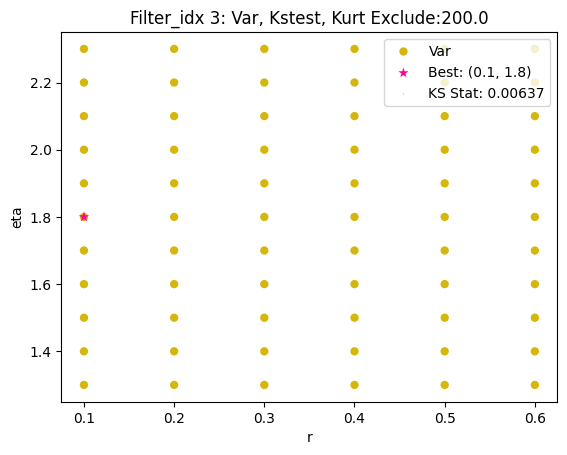

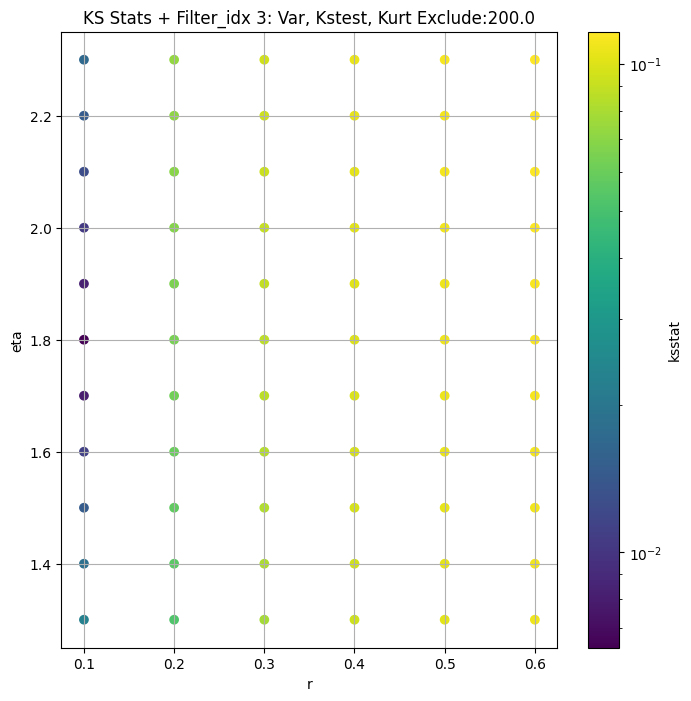

####
Filter_idx  4


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.01881694017705951 147.18261314105916


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.0025426889299347416 73.04576133868224


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.00281458006123092 63.51226421872081


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.002732328322825328 55.14849856484925
Number of samples: 100000, Without approximation : 786432000.0


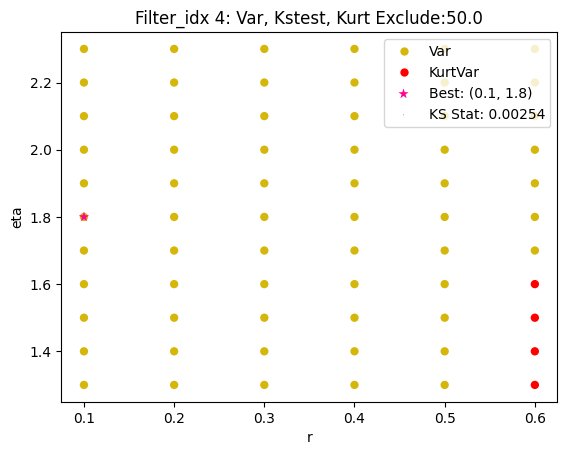

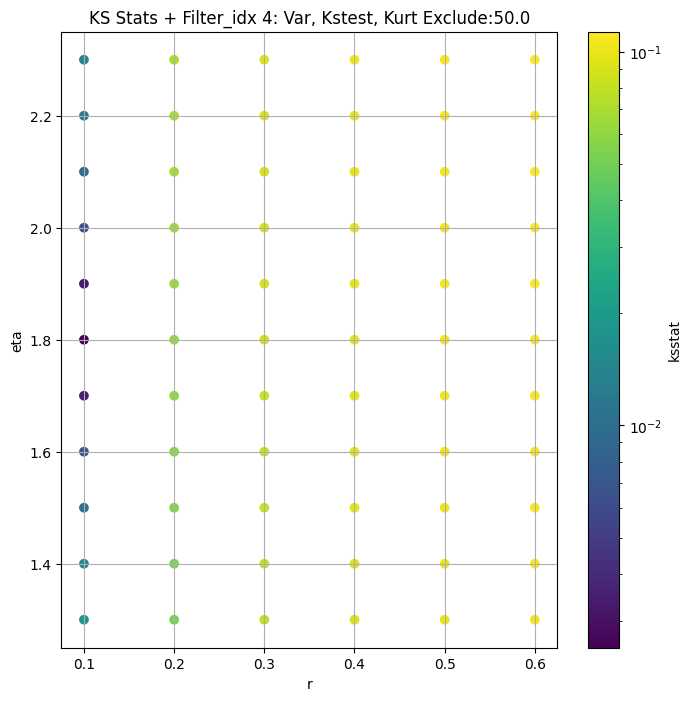

####
Filter_idx  5


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.024883909408864868 61.70378578565901


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.006850049102730682 29.08596138761576


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.004665316754480009 25.009218833407765


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.004818650694729643 21.285562458954402
Number of samples: 100000, Without approximation : 786432000.0


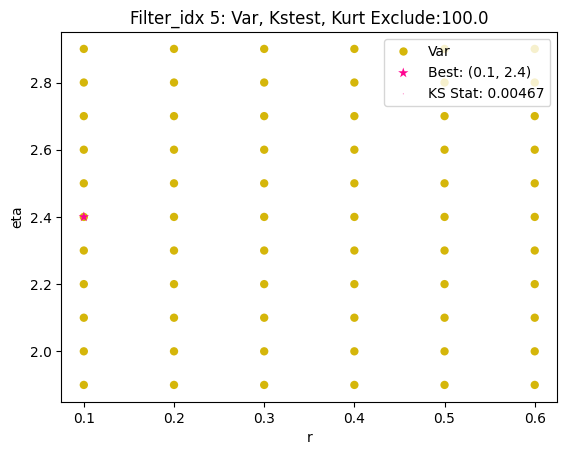

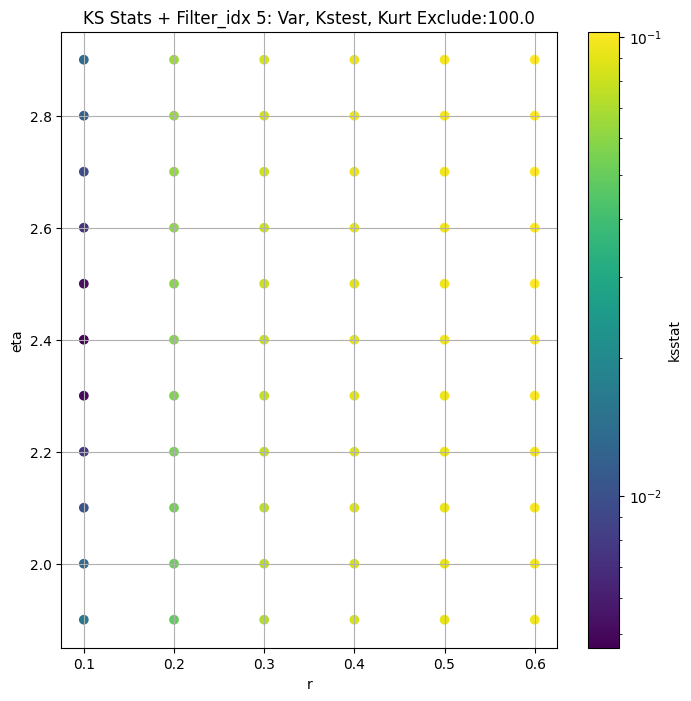

####
Filter_idx  6


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.02326908149985152 53.870008960325436


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.0071560015886846795 25.54935233985663


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.004394073554554706 22.1850899029067


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.003903568240633013 19.276955463434465
Number of samples: 100000, Without approximation : 786432000.0


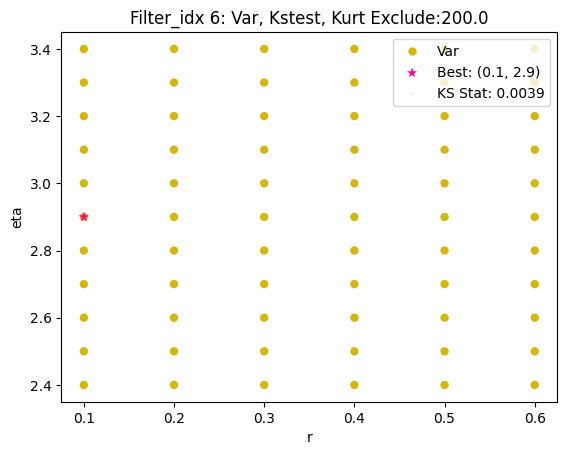

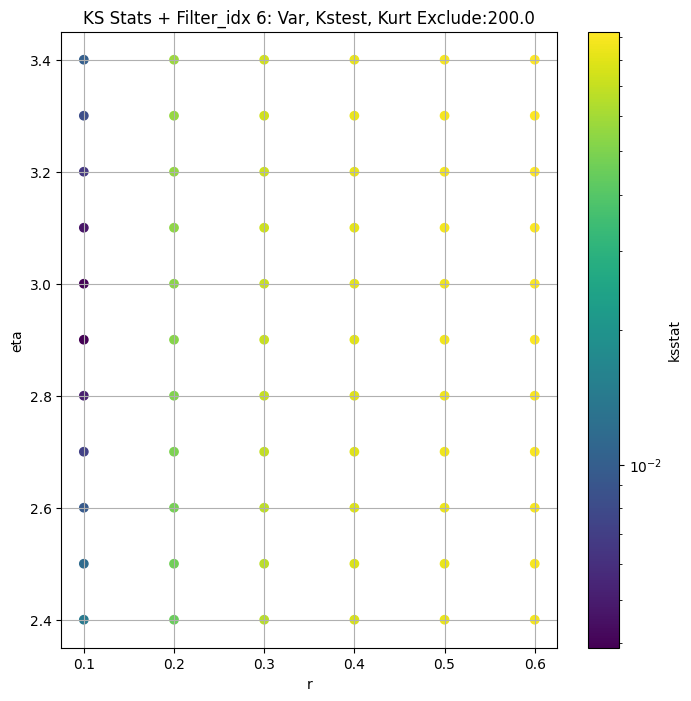

####
Filter_idx  7


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.035431046795778076 73.31182903561383


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.021087593030586438 38.12255212730225


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.018750609507171945 31.99210100452963


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.018666089915658213 26.857149663915628
Number of samples: 100000, Without approximation : 786432000.0


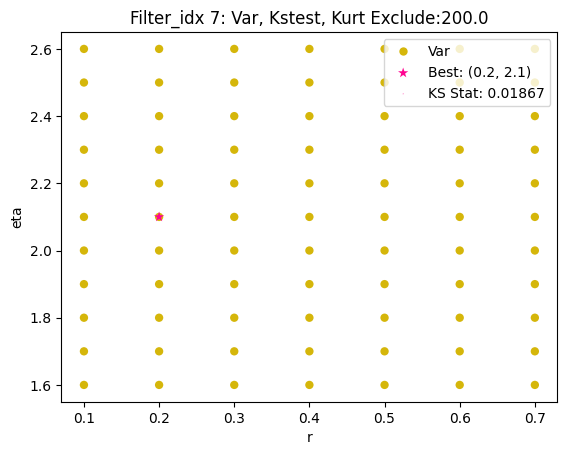

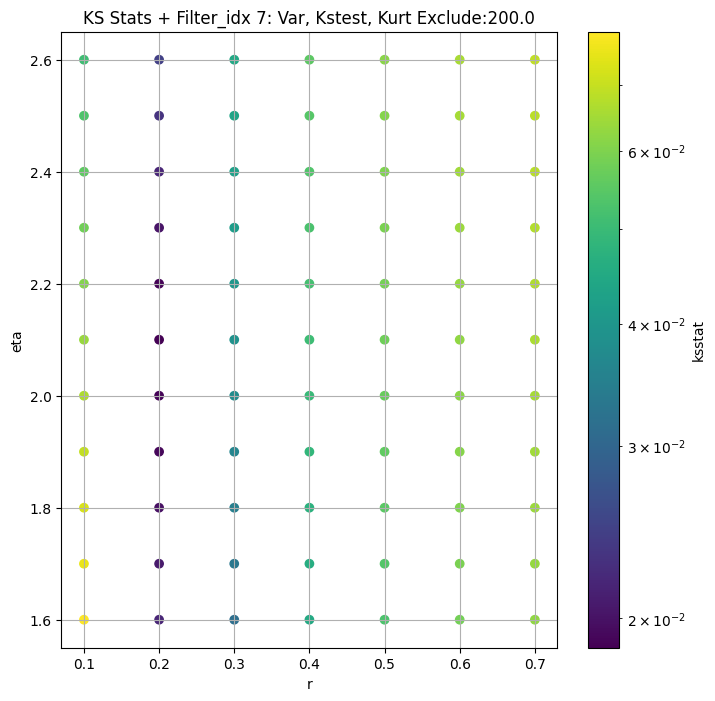

####
Filter_idx  8


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.04010406999181687 2.3747436709899032


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.02150468238816594 0.8311102067140198


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.01856655614563485 0.7094179322705357


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.017401600349595536 0.6054542869293476
Number of samples: 100000, Without approximation : 786432000.0


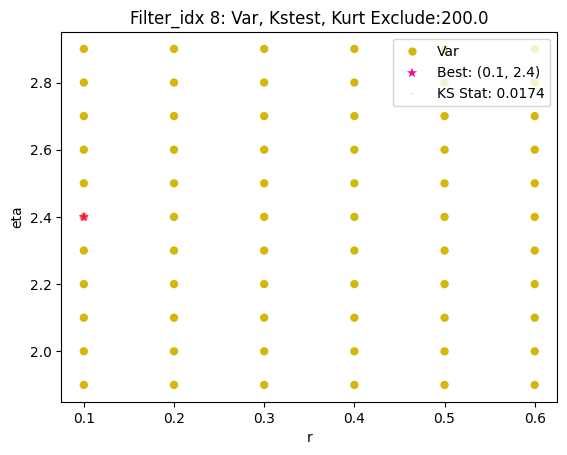

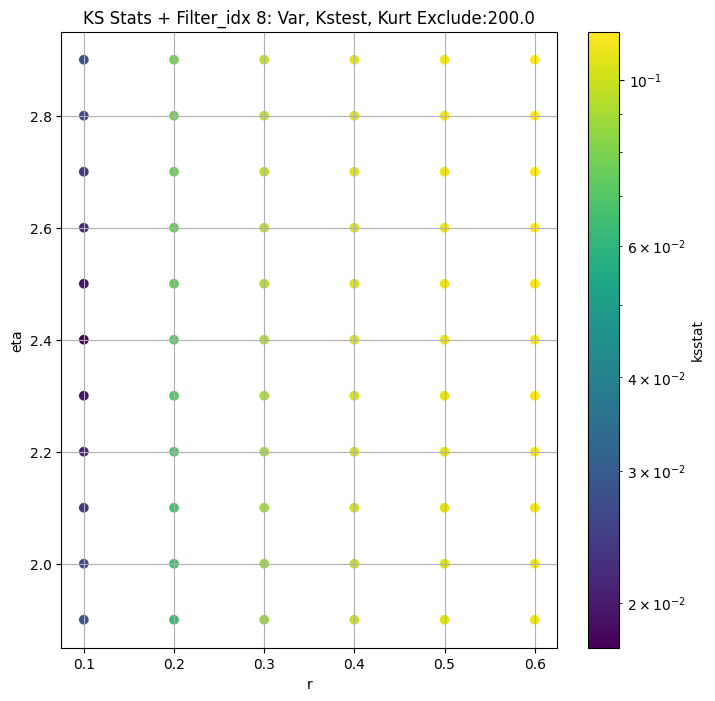

####
Filter_idx  9


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.03493568271844516 21.8700662114683


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.019442017035578574 6.147859288816573


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.015477979343945236 5.19842766873801


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.014394979806065133 4.339408738127907
Number of samples: 100000, Without approximation : 786432000.0


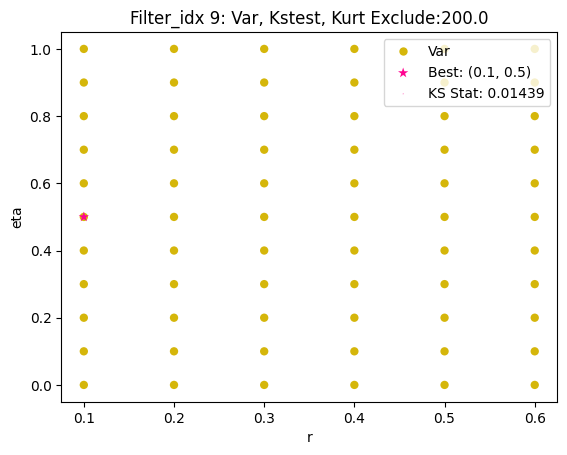

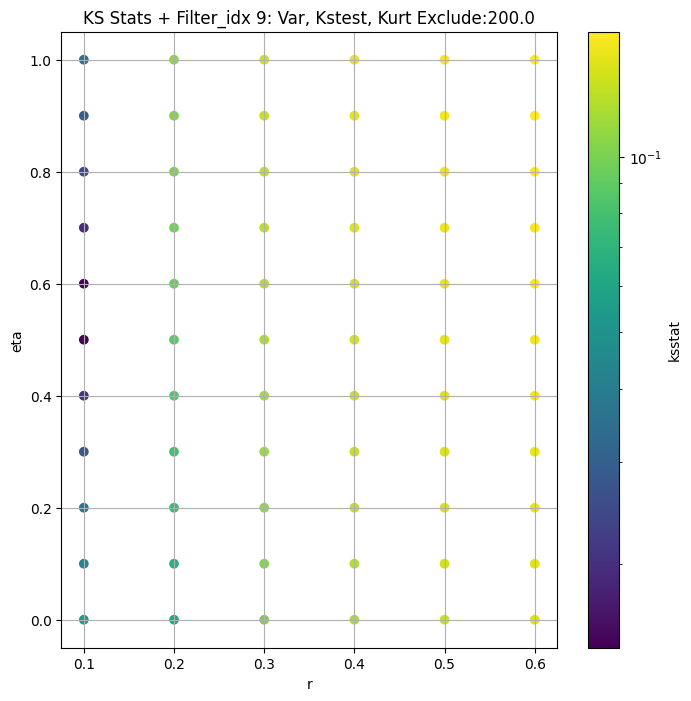

####
Filter_idx  10


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.024454657149412584 53.7346487626277


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.008585494394500182 26.62428209941383


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.006259666388926027 23.298543216485637


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.004815906514164803 20.176316043728065
Number of samples: 100000, Without approximation : 786432000.0


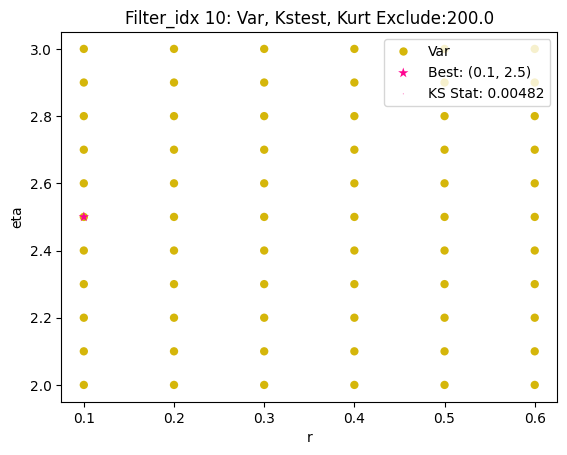

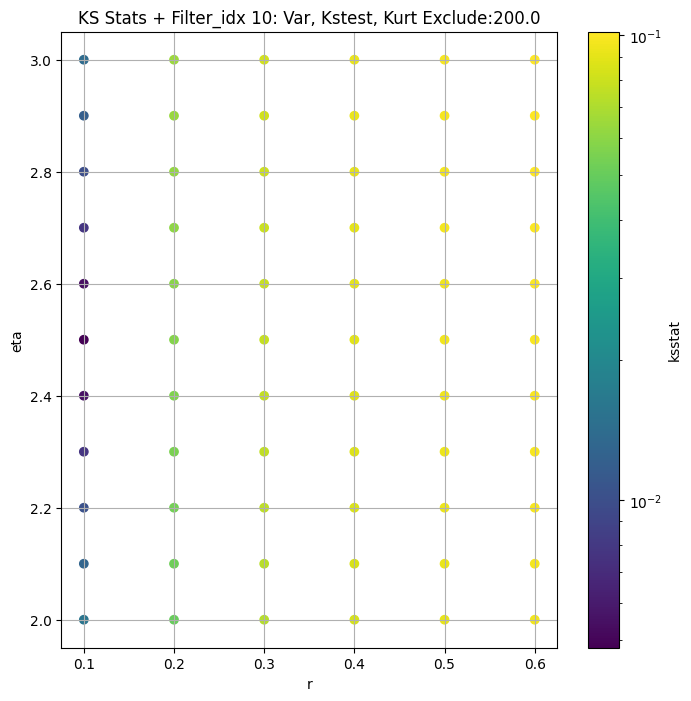

####
Filter_idx  11


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.021386877302677132 51.949739070721606


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.005676478068084245 22.524334885563036


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.0025007058625495793 19.536994272808094


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.00408255100973165 16.914191973299015
Number of samples: 100000, Without approximation : 786432000.0


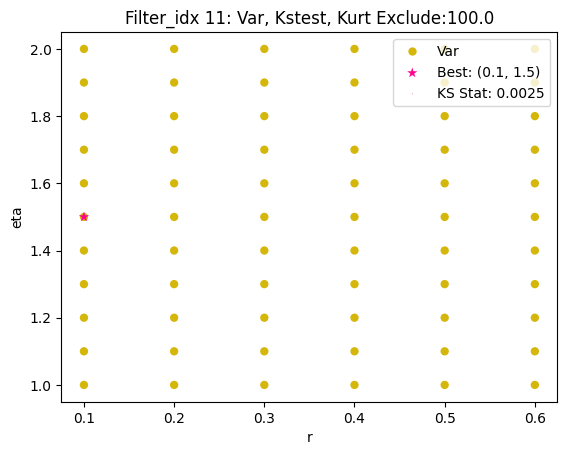

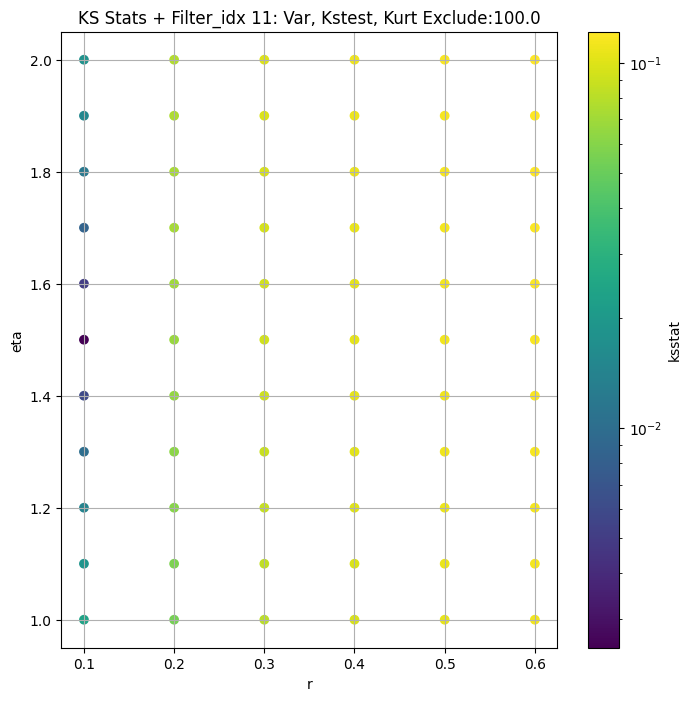

####
Filter_idx  12


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.026685171021608445 43.7757787892894


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.012151890726813774 21.13044619130863


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.01004258818101822 18.525486125654783


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.007206203679119949 16.071298067109094
Number of samples: 100000, Without approximation : 786432000.0


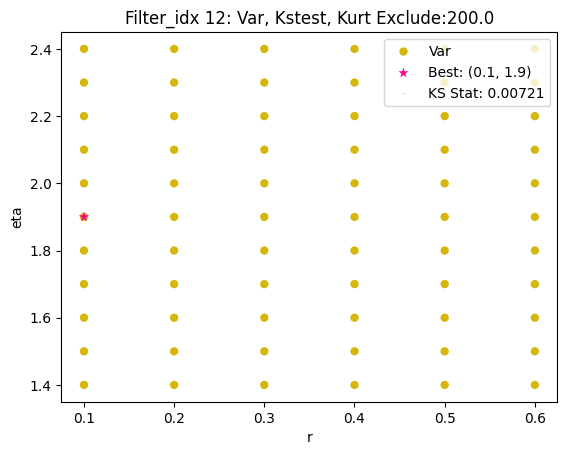

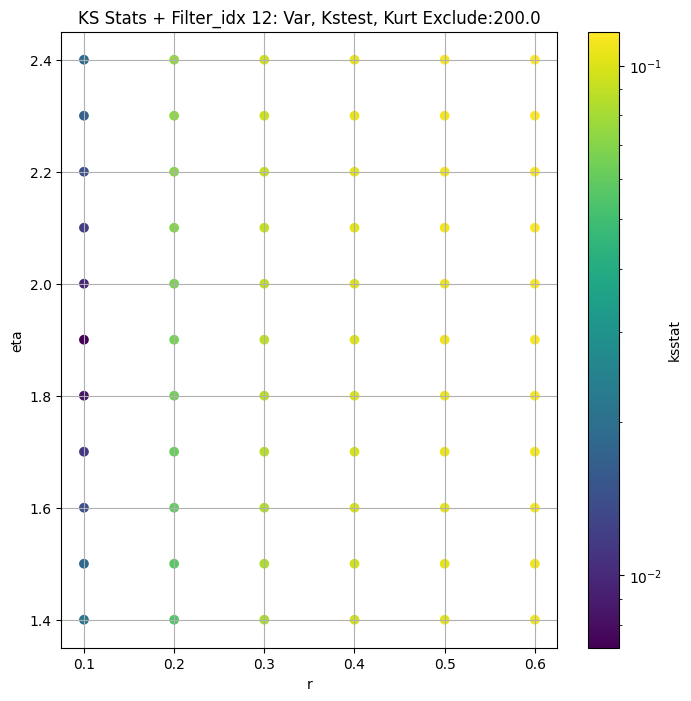

####
Filter_idx  13


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.02326666910752795 57.70173043358049


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.010784281651143202 31.3238261843043


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.008549946869127134 27.01697157637875


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.004544245152459436 22.712321323833752
Number of samples: 100000, Without approximation : 786432000.0


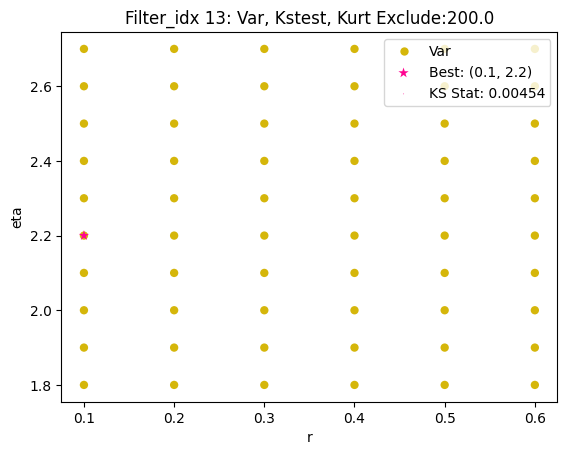

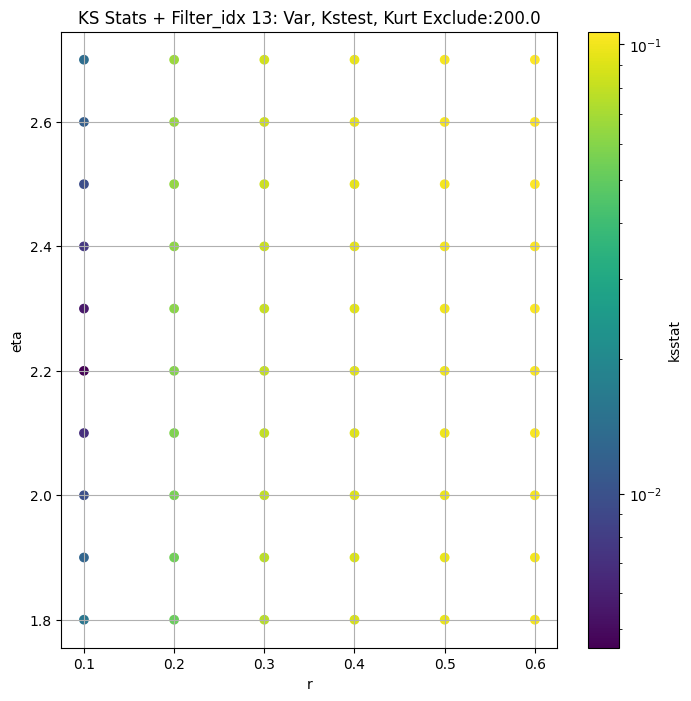

####
Filter_idx  14


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.02190630598537735 73.57652949378839


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.006457766320287606 34.933171479883654


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.005446679521986297 30.72851488208976


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.005065728222271582 26.56730491237001
Number of samples: 100000, Without approximation : 786432000.0


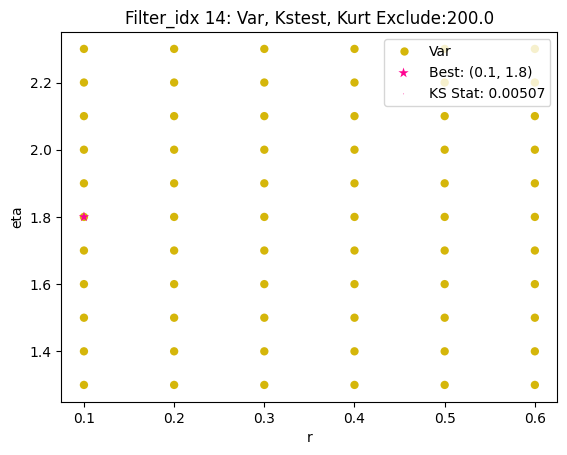

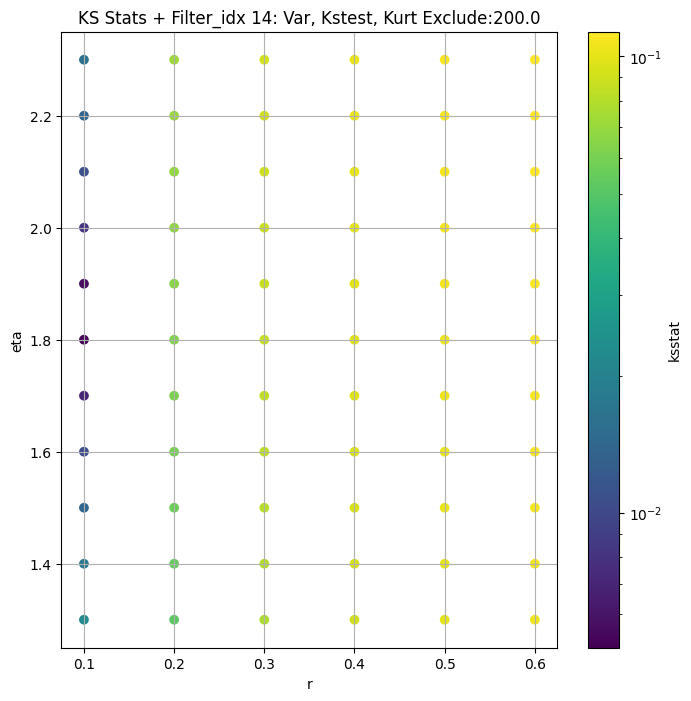

####
Filter_idx  15


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.03332504480916865 66.48025636243204


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.016143668565689828 35.08159881072456


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.011620158062328634 30.263913821786485


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.007132925082302011 25.94207737900375
Number of samples: 100000, Without approximation : 786432000.0


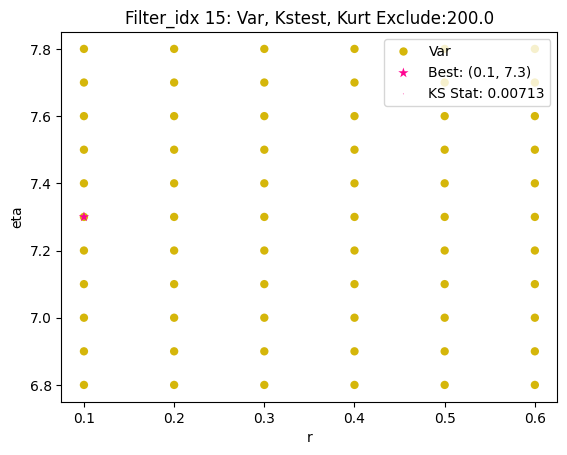

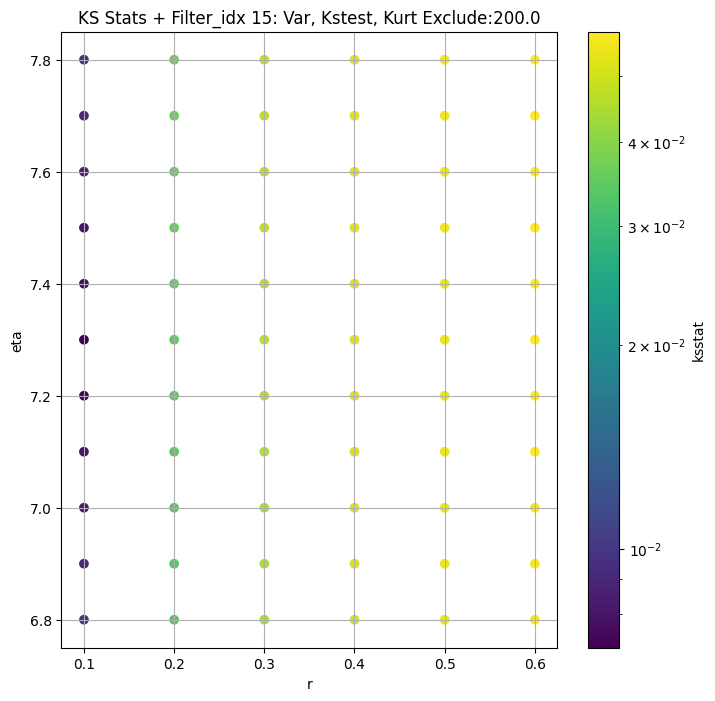

####
Filter_idx  16


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.02769461073985713 39.81625953003626


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.012511663465769873 18.66109141789193


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.010600816875419777 16.449059863658203


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.0074638916179002035 14.18695963017607
Number of samples: 100000, Without approximation : 786432000.0


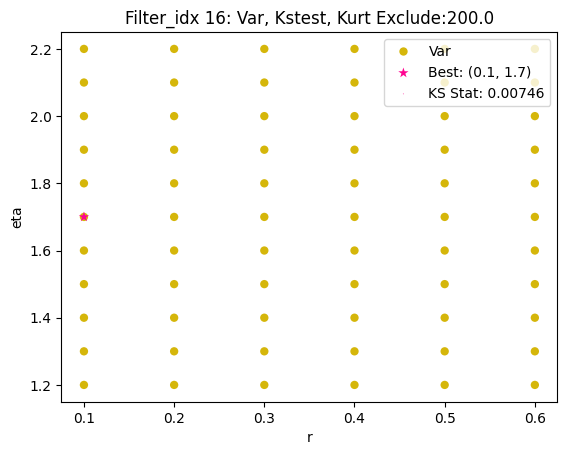

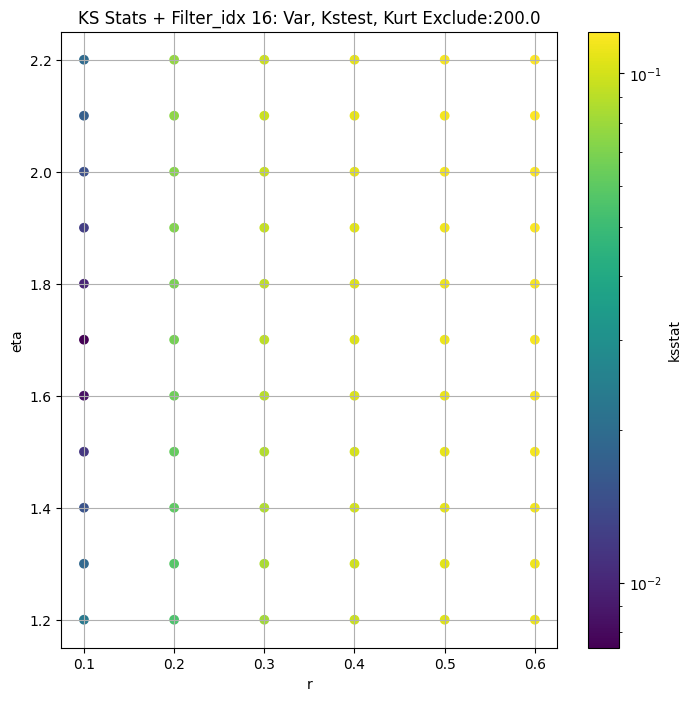

####
Filter_idx  17


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.017498854189592516 51.375847680329656


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.0057994215041556885 18.082917919695774


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.006813471661963999 15.446796711073453


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.00963879846414012 13.267741906554305
Number of samples: 100000, Without approximation : 786432000.0


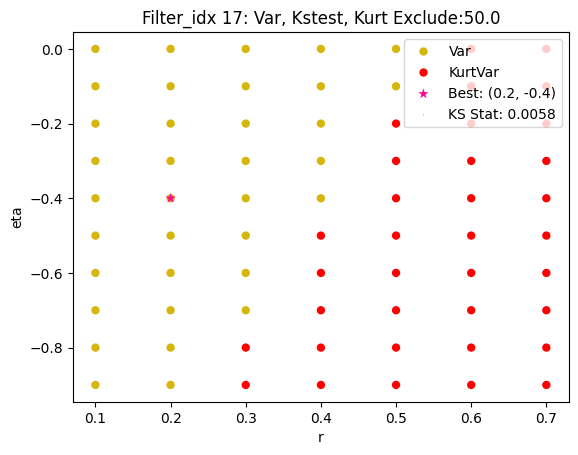

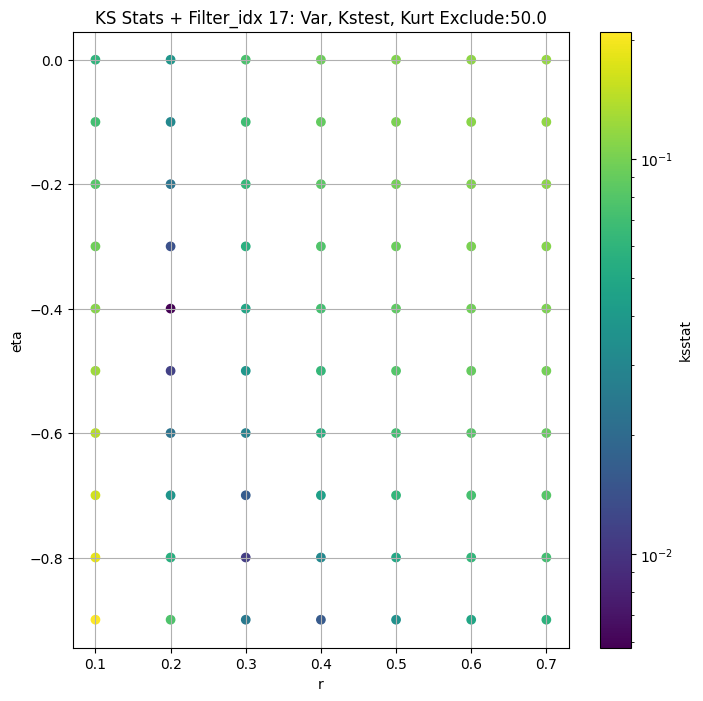

####
Filter_idx  18


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.02564609080739505 30.840882292221217


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.01432158877621903 15.103094412212268


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.012223152174147711 13.343051273826125


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.009890655839316254 11.57250352262966
Number of samples: 100000, Without approximation : 786432000.0


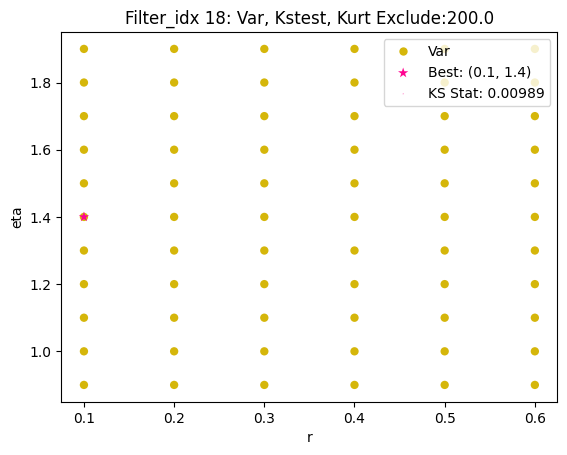

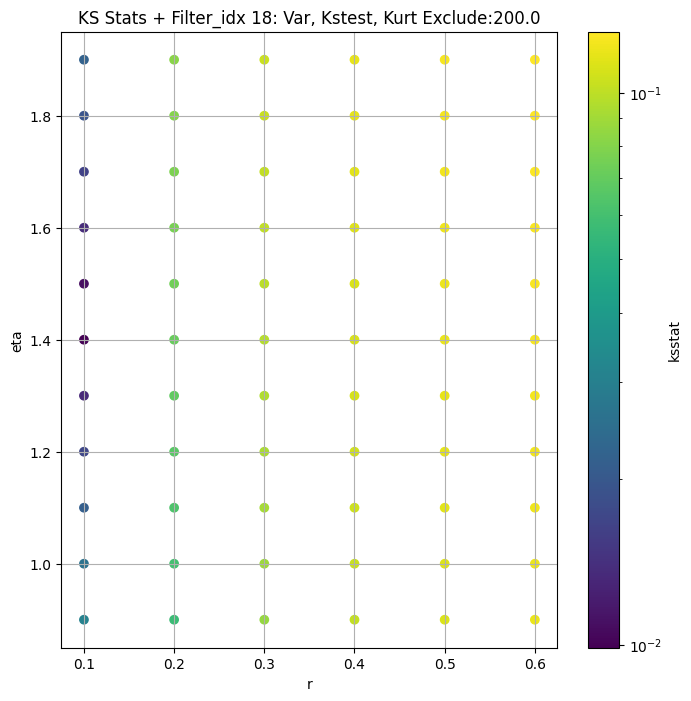

####
Filter_idx  19


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.03105073621446234 125.34102424633394


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.016604672347085625 66.5539736219986


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.016351886626536527 56.95761295843295


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.016223785561111925 48.84674882998806
Number of samples: 100000, Without approximation : 786432000.0


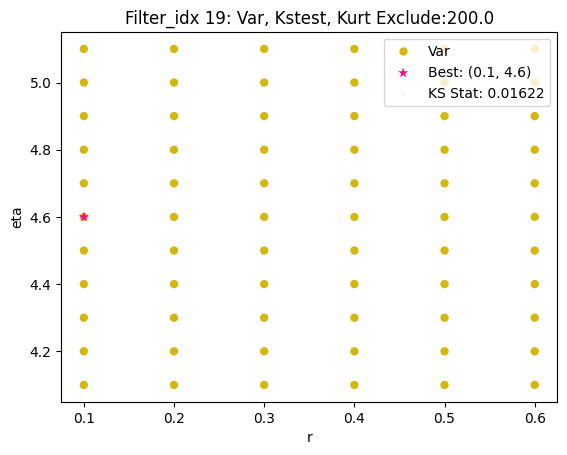

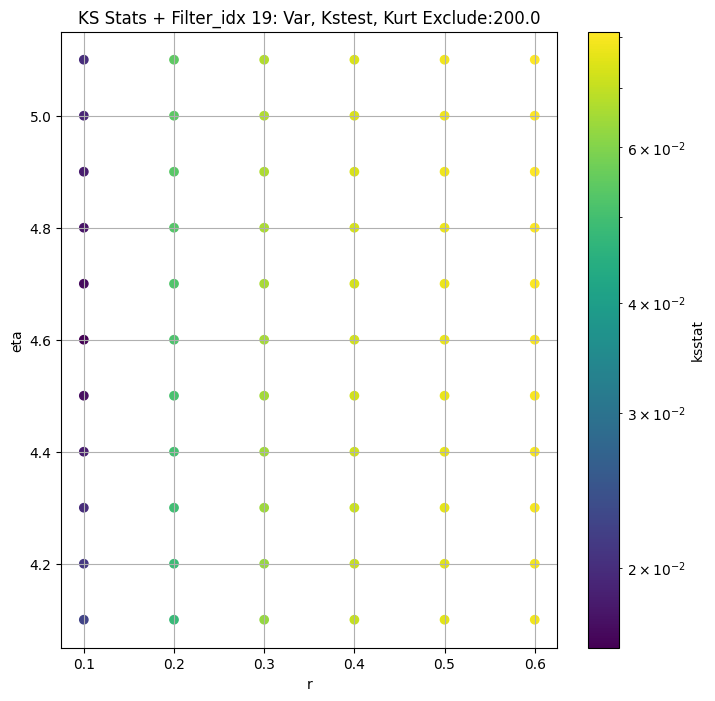

####
Filter_idx  20


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.024253106811737757 202.79353810868494


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.0088659378037379 100.64097665795693


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.004856907670421684 86.66838985986297


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.0032035511854187383 74.1993536128733
Number of samples: 100000, Without approximation : 786432000.0


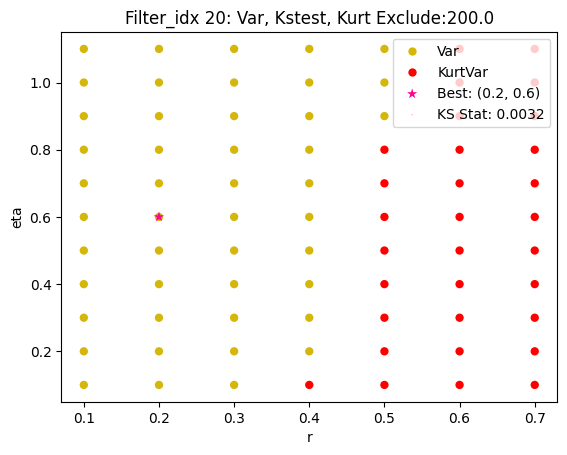

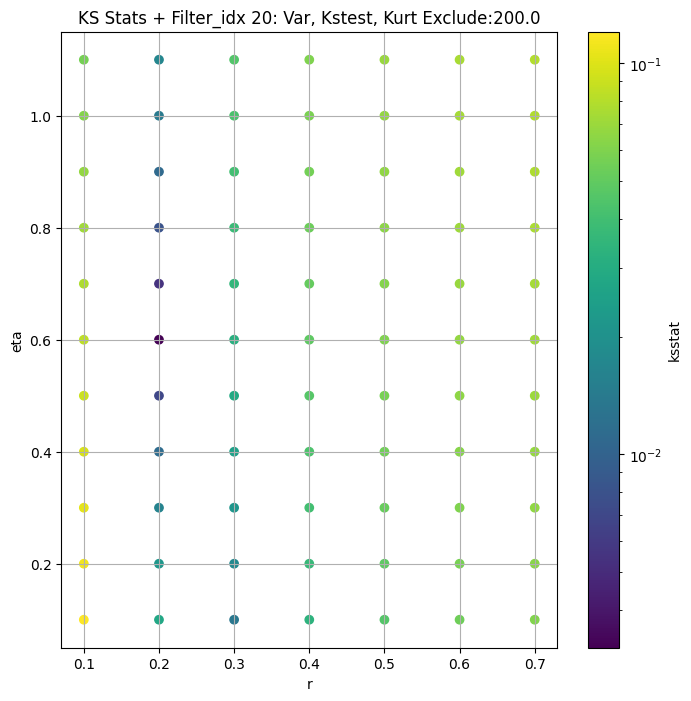

####
Filter_idx  21


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.03976159706627014 358.8567113552143


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.030659390674494913 195.3513337035832


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.03066598760146172 167.85740946455658


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.030658741147748414 143.36982461875687
Number of samples: 100000, Without approximation : 786432000.0


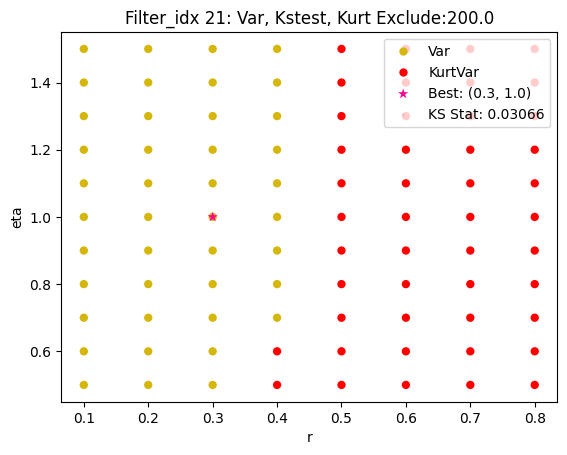

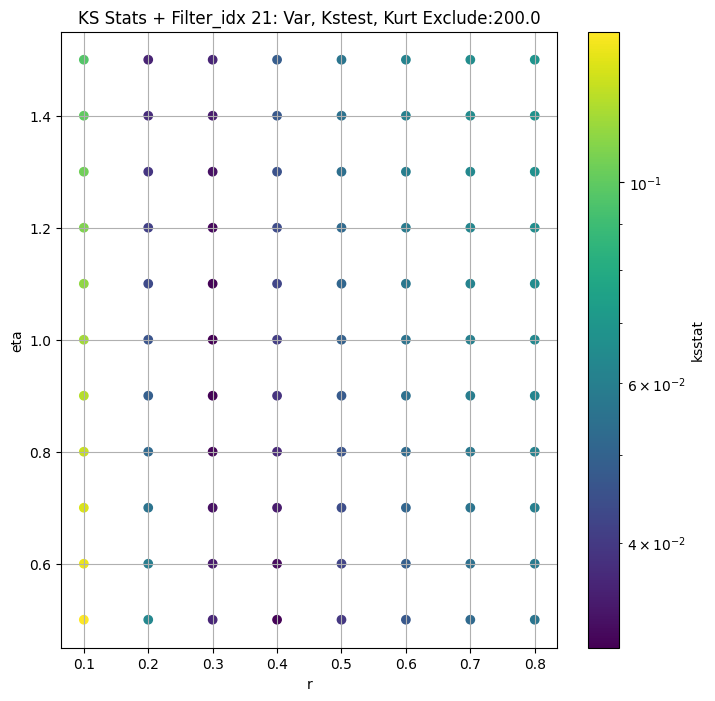

####
Filter_idx  22


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.026535489745937224 54.76933152268656


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.01380250490176503 29.226501710380212


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.010239117868502068 24.238805616154625


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.006423632031333587 19.444271592239705
Number of samples: 100000, Without approximation : 786432000.0


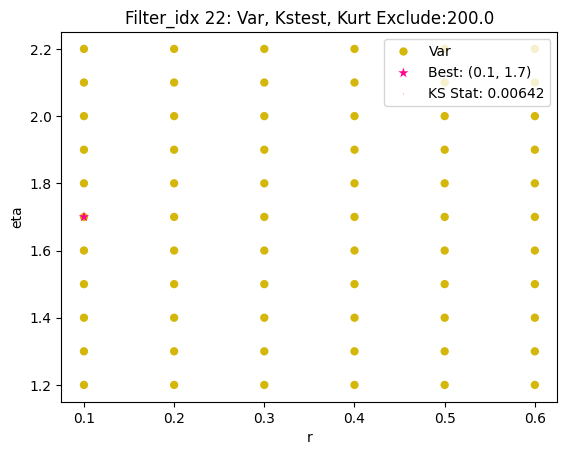

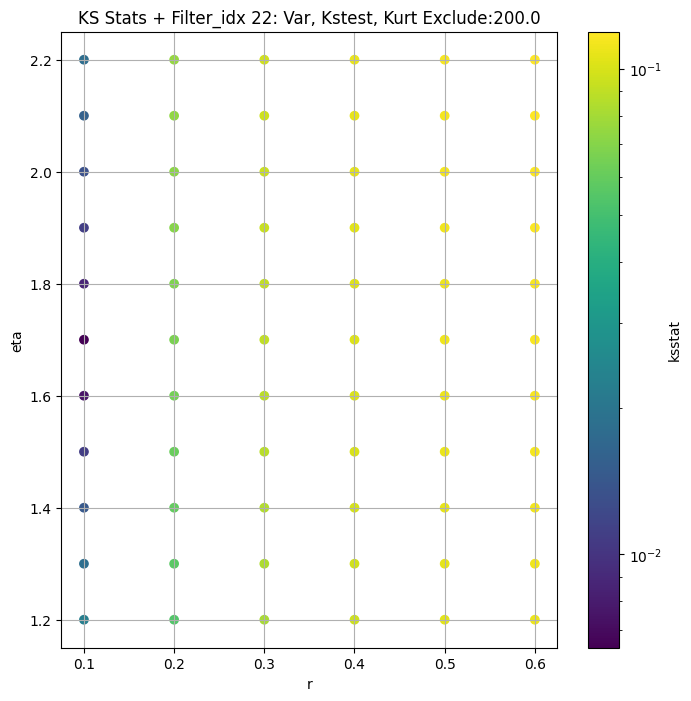

####
Filter_idx  23


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.025578072547814634 117.53452822376494


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.009847384358796174 44.39115100471943


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.005293092879111505 35.74420196668687


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.00599006166645577 29.996217025276714
Number of samples: 100000, Without approximation : 786432000.0


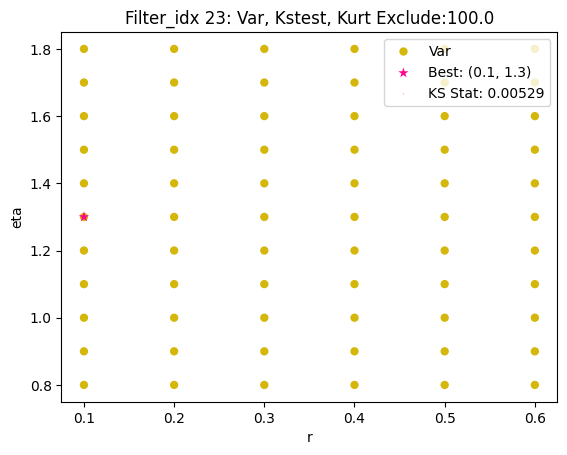

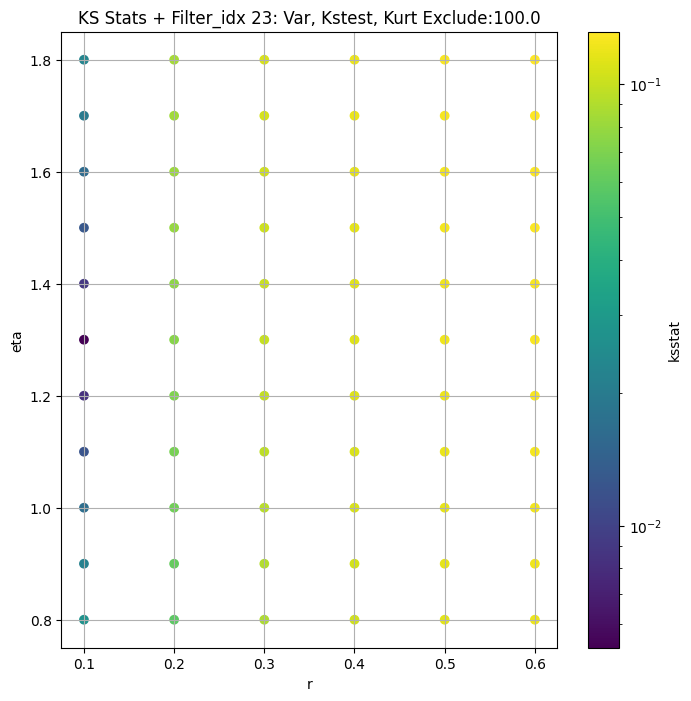

####
Filter_idx  24


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.03359742075376139 76.26686254770968


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.01789387279115498 31.432841421799786


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.014638527619246111 25.66307074574034


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.01170711922162826 20.62244499549186
Number of samples: 100000, Without approximation : 786432000.0


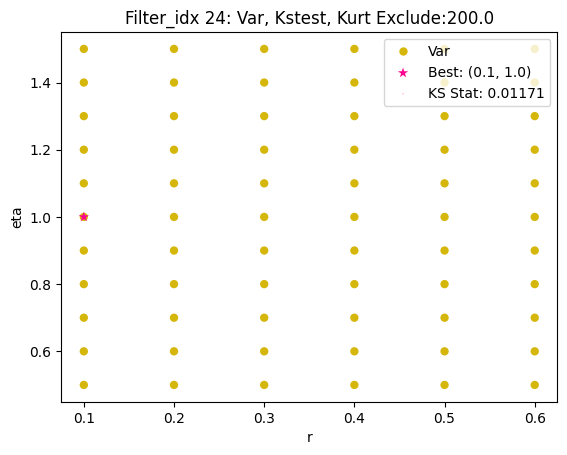

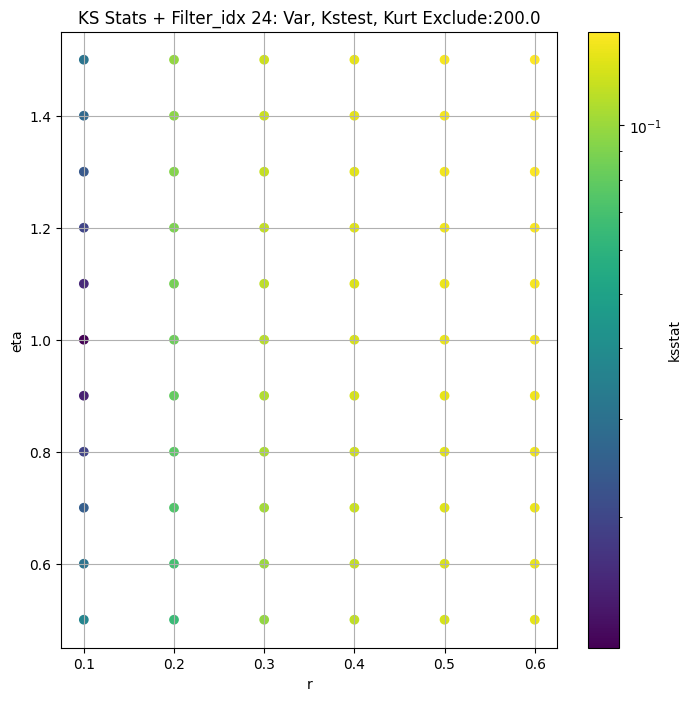

####
Filter_idx  25


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.03447228275703251 25.834456608715737


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.016188246798502948 9.444948950935398


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.013148245652143842 7.968234403626827


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.009294670765942703 6.397225975967124
Number of samples: 100000, Without approximation : 786432000.0


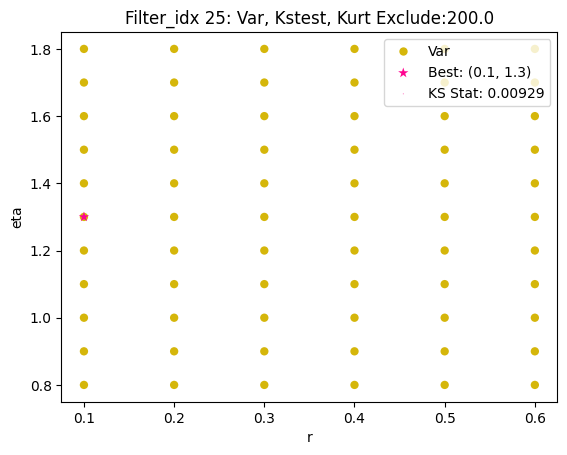

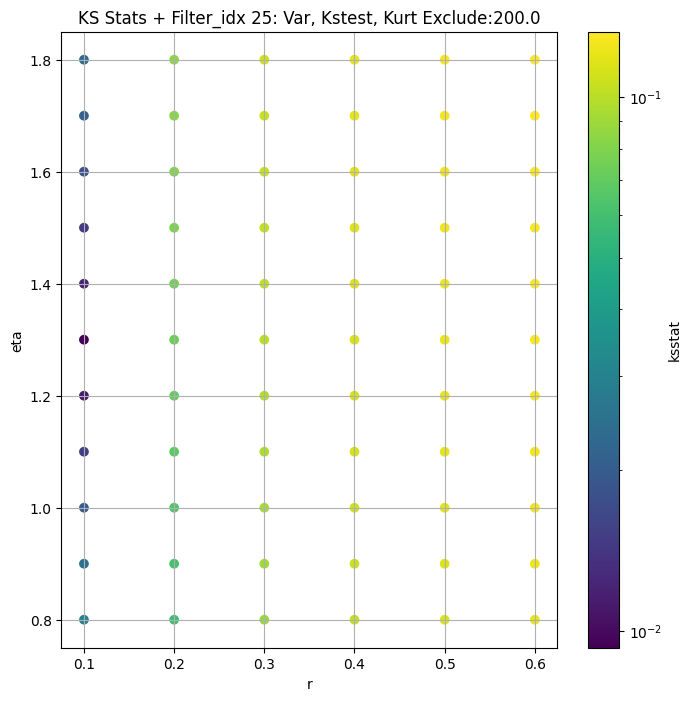

####
Filter_idx  26


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.02530469830803378 45.715241034255584


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.008541016849229685 21.19544448728593


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.00686036023468406 18.359772493288403


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.006745698295894886 15.968500444760334
Number of samples: 100000, Without approximation : 786432000.0


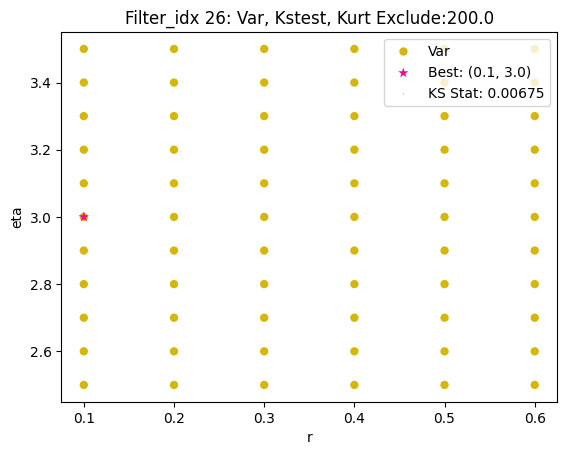

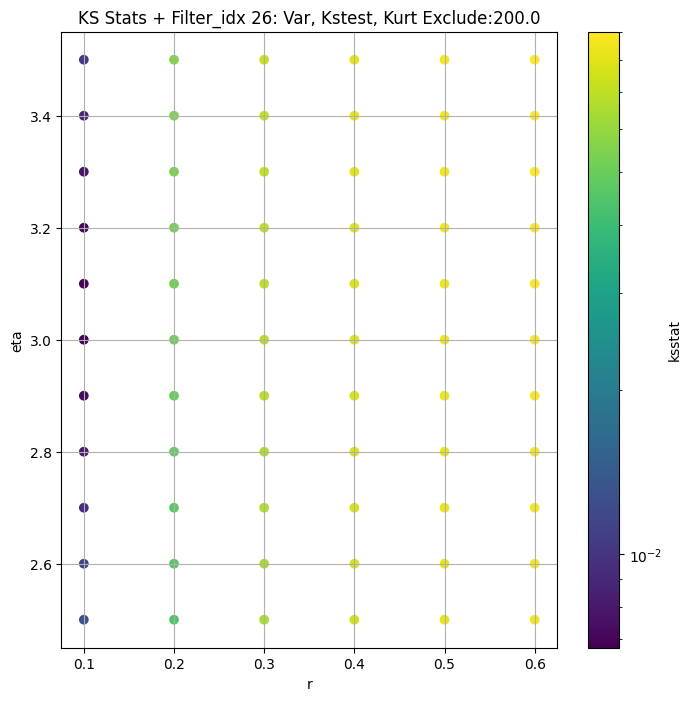

####
Filter_idx  27


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.03250540136337385 21.712620396877238


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.019292889856464657 7.201788756672803


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.017902338699281983 6.15501654494234


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.014937072030885179 5.179114556912315
Number of samples: 100000, Without approximation : 786432000.0


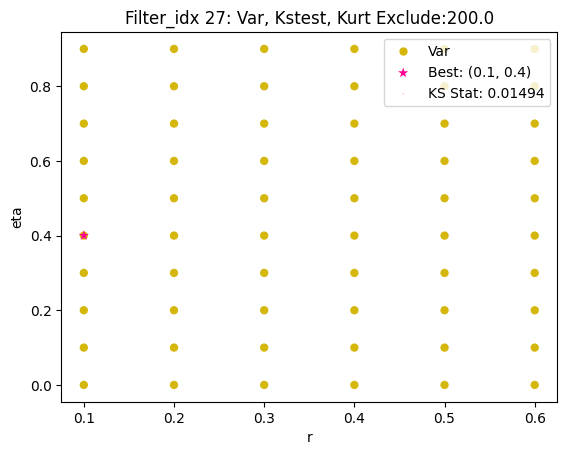

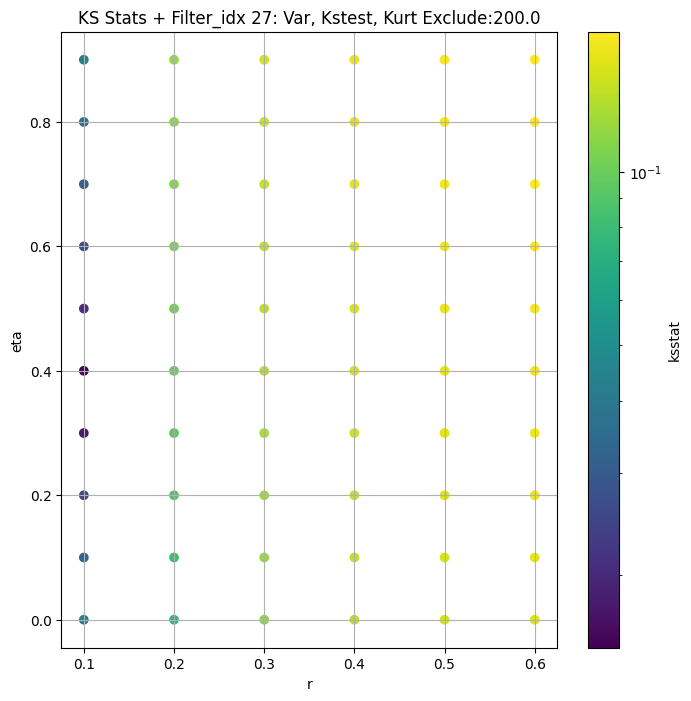

####
Filter_idx  28


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.032690101453638154 100.72586283288246


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.01945010311004114 40.876214517538756


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.016264904164879135 32.85758265038139


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.012667121704698414 26.13089588747634
Number of samples: 100000, Without approximation : 786432000.0


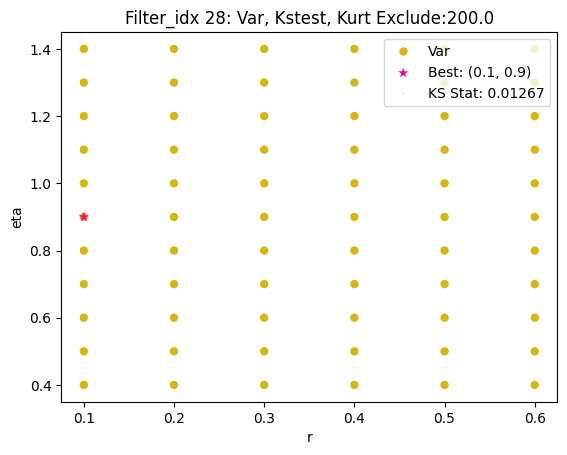

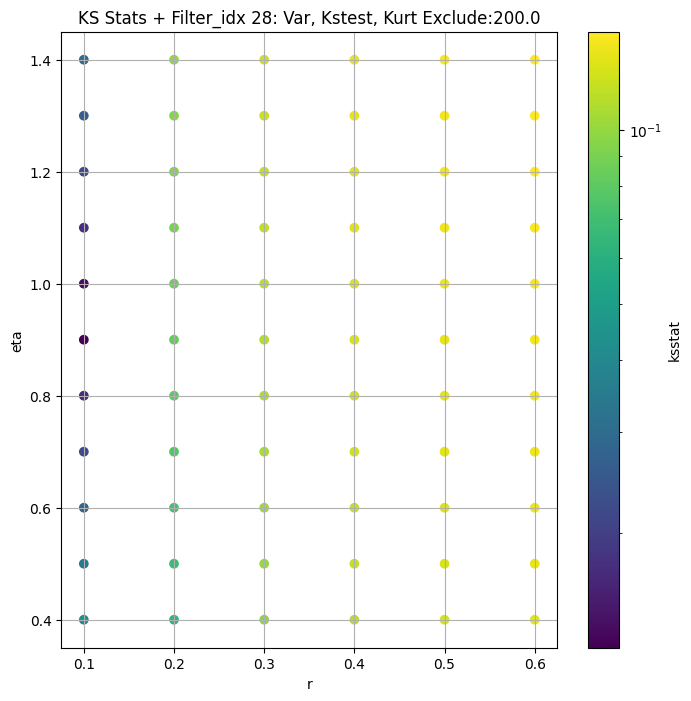

####
Filter_idx  29


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.022612091759951936 77.96544811499017


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.010576640578777385 29.141955664858973


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.009537895581671174 24.51001374711341


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.008652612827839246 20.673992702744265
Number of samples: 100000, Without approximation : 786432000.0


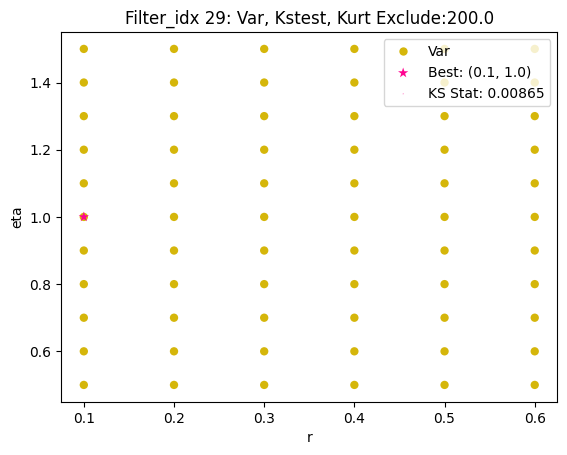

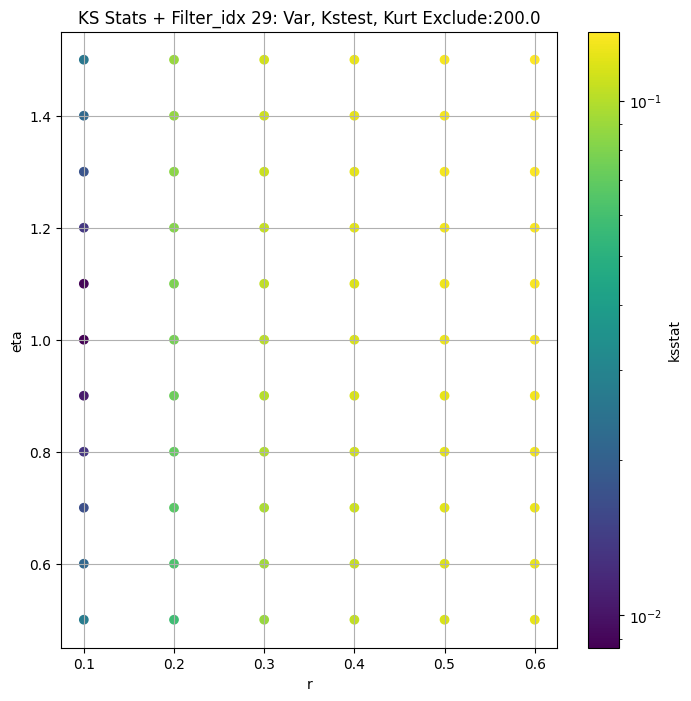

####
Filter_idx  30


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.029134886459222797 67.45143271626793


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.01655454558542091 27.343196138924224


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.012785972690539216 22.352798073379642


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.010166488645657057 18.19748793398733
Number of samples: 100000, Without approximation : 786432000.0


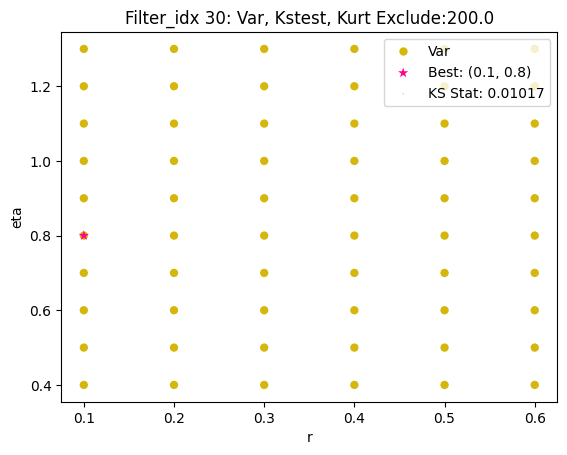

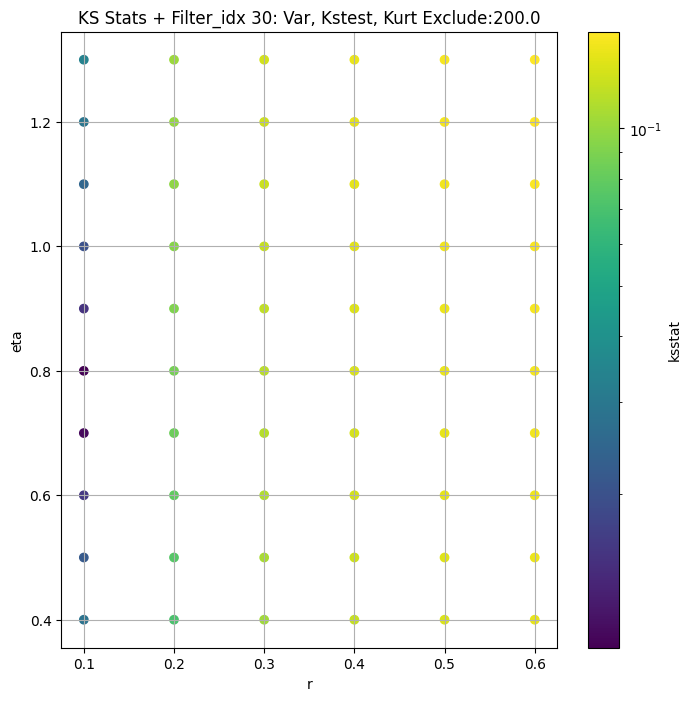

####
Filter_idx  31


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.029565678336575973 71.19441775195031


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.018882805106616163 37.20448057759213


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.018282882135761624 31.666257381355123


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.018282158407504745 27.28798144842038
Number of samples: 100000, Without approximation : 786432000.0


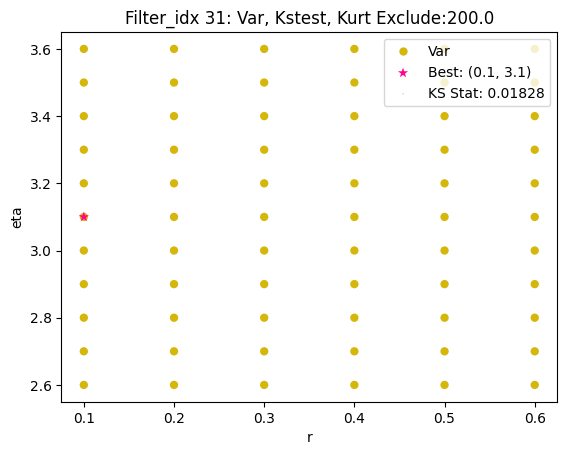

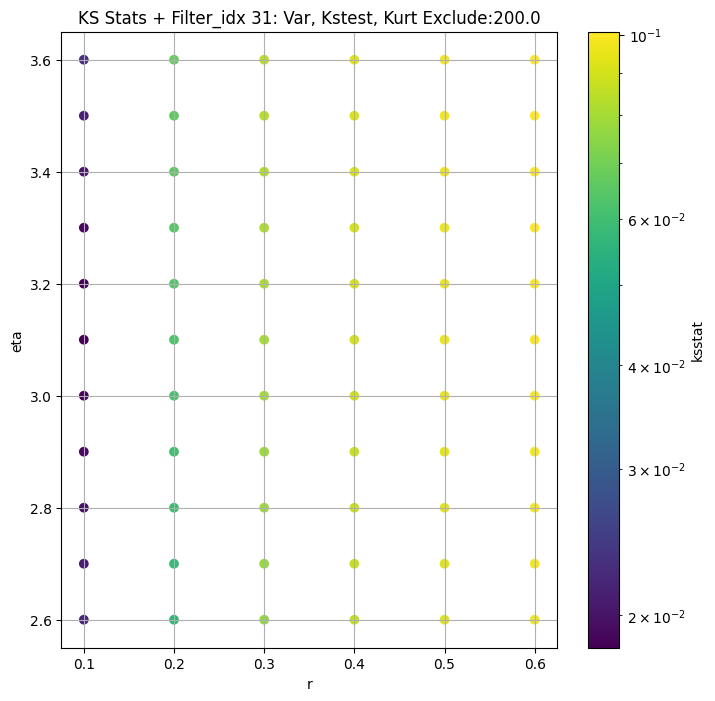

####
Filter_idx  32


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.023174996899583022 91.04241165945001


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.008185692500271846 39.52081905068928


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.0063599663304403364 32.61604738549685


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.005261320914334289 27.615445139508022
Number of samples: 100000, Without approximation : 786432000.0


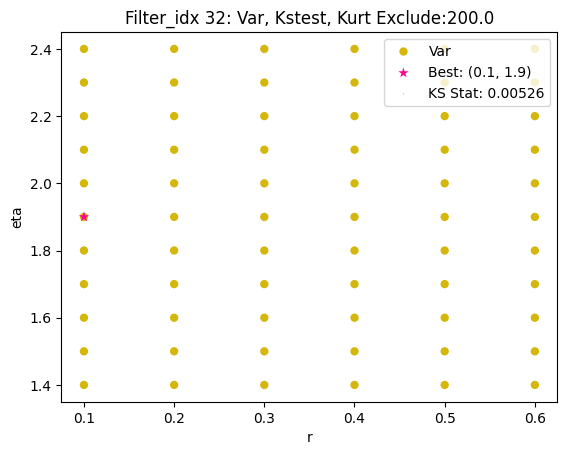

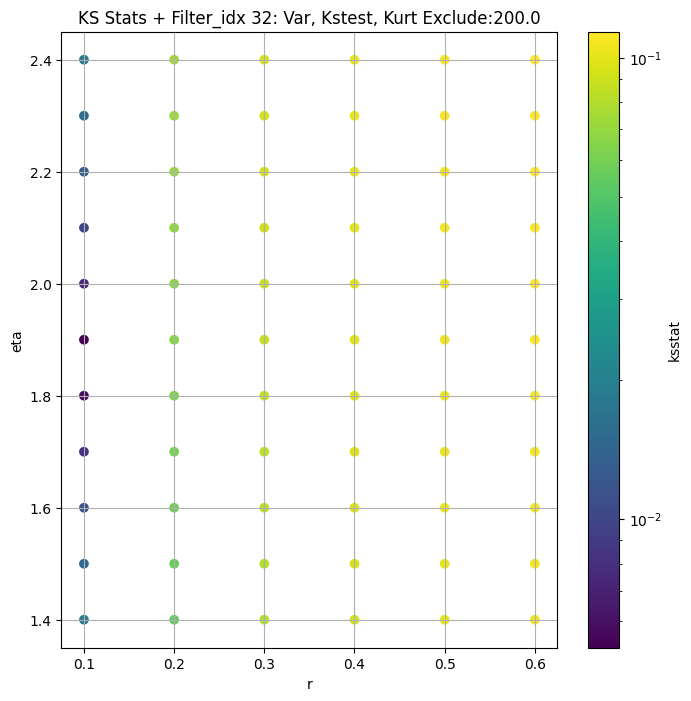

####
Filter_idx  33


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.029125563296508464 20.24661139122456


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.014599598070739628 9.157987012635715


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.013074046240995618 8.014939443824746


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.0098526523356387 6.9312090934442
Number of samples: 100000, Without approximation : 786432000.0


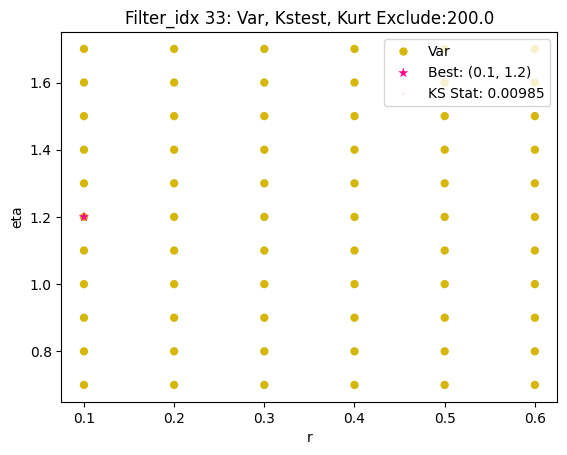

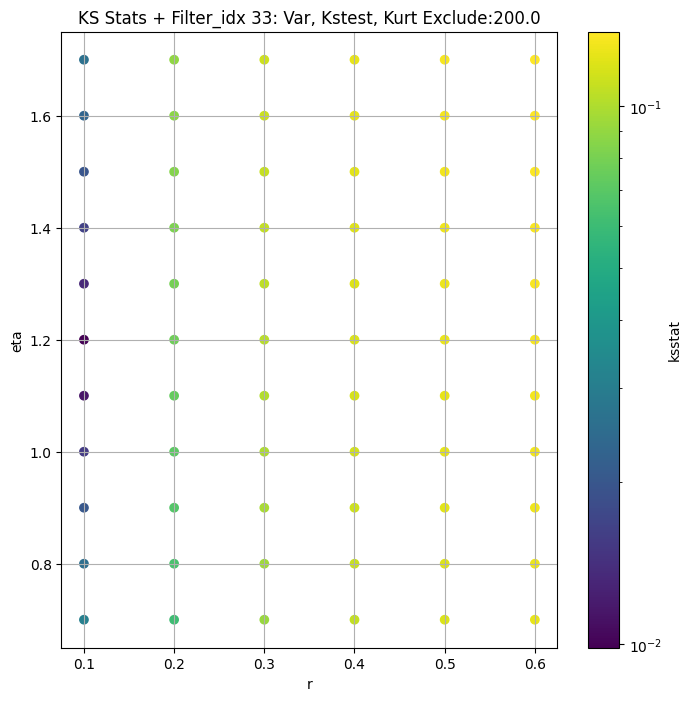

####
Filter_idx  34


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.032724968224305276 77.76665852296958


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.015826066950958645 29.170480352162123


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.012311426158855054 24.09007487153377


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.009716530499860876 19.78407982157889
Number of samples: 100000, Without approximation : 786432000.0


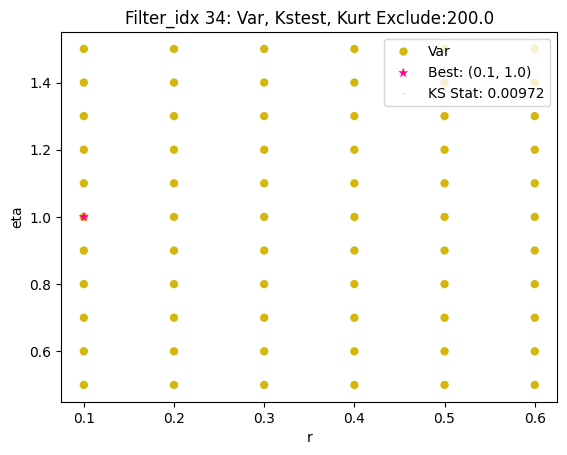

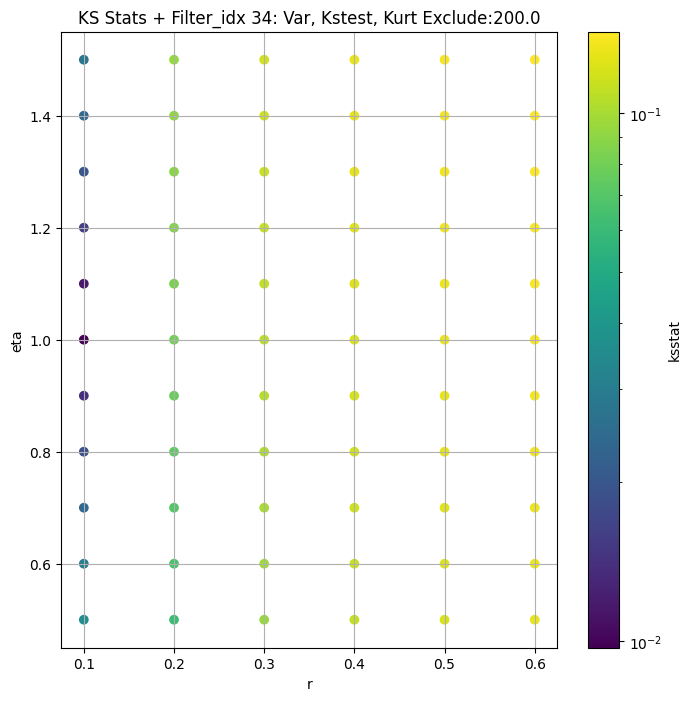

####
Filter_idx  35


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.03610425783668669 238.75010999302893


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.031572459399322905 129.73262423157993


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.03158502443702088 110.77477570232665


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.031565543067907986 93.16853230957283
Number of samples: 100000, Without approximation : 786432000.0


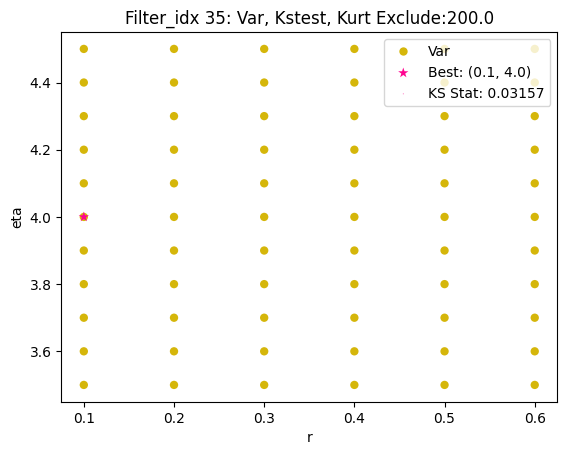

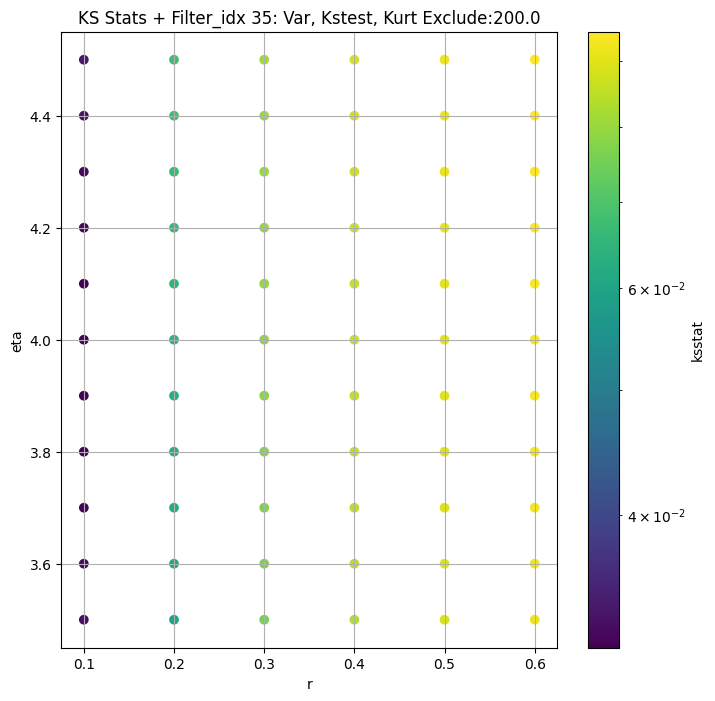

####
Filter_idx  37


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.03735526344375756 346.7015064887285


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.028767643354215333 192.71808415330992


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.028749660773943975 165.85113745950818


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.028751224095167616 141.76445783010524
Number of samples: 100000, Without approximation : 786432000.0


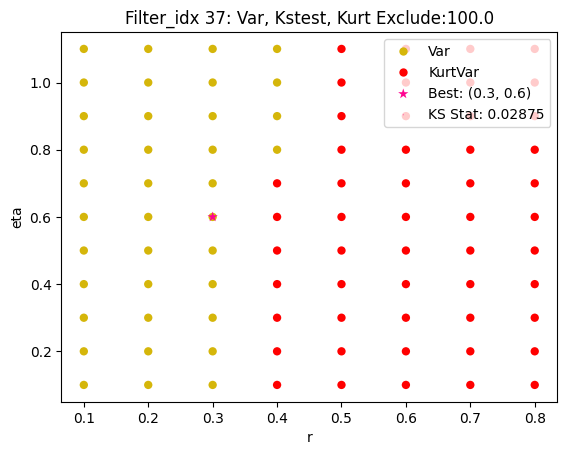

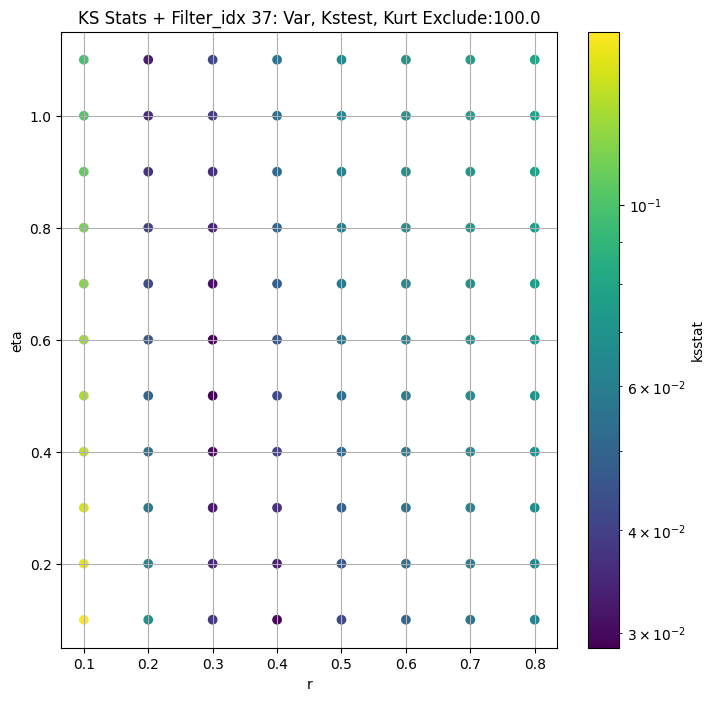

####
Filter_idx  38


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.02301019465389456 97.3616978858935


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.006330656830882353 47.04820714596129


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.0026933213821351693 40.52359351588062


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.002958952297112738 34.78398905170788
Number of samples: 100000, Without approximation : 786432000.0


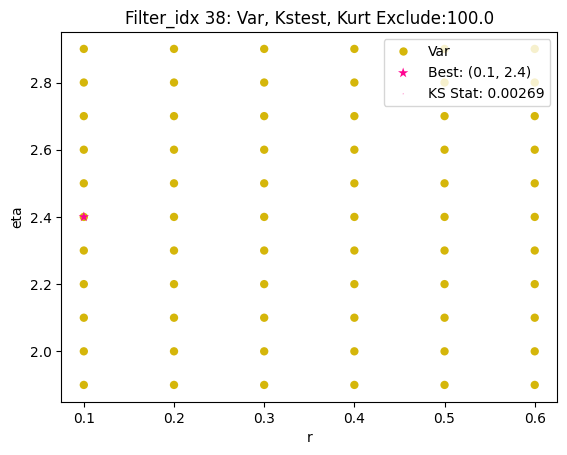

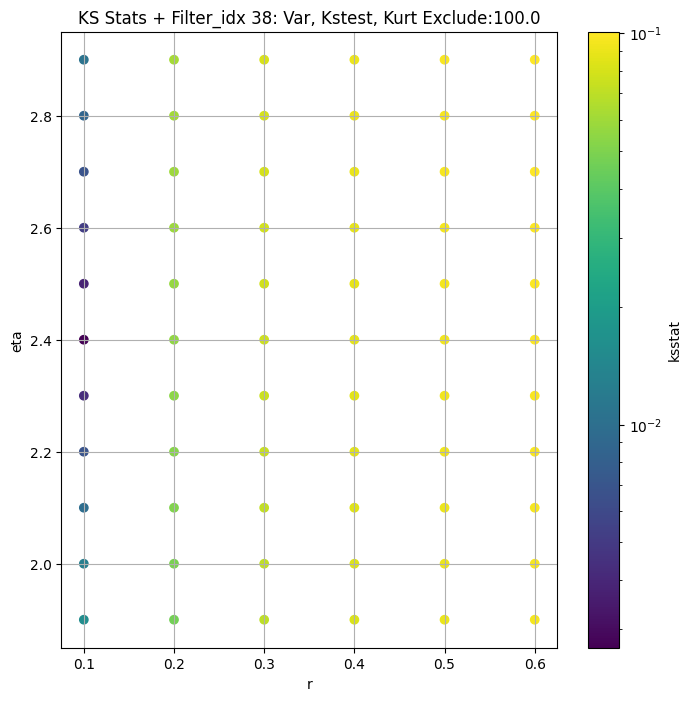

####
Filter_idx  39


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.034281954979268225 92.99726287600075


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.022509975170571517 45.268459952738226


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.021311385777564973 38.28108111732041


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.021315181355717694 32.79884513874081
Number of samples: 100000, Without approximation : 786432000.0


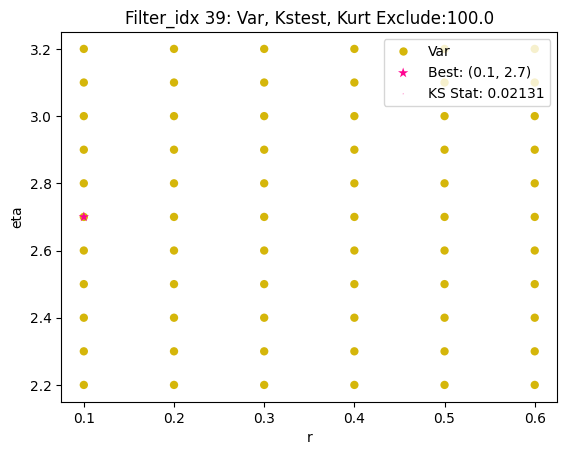

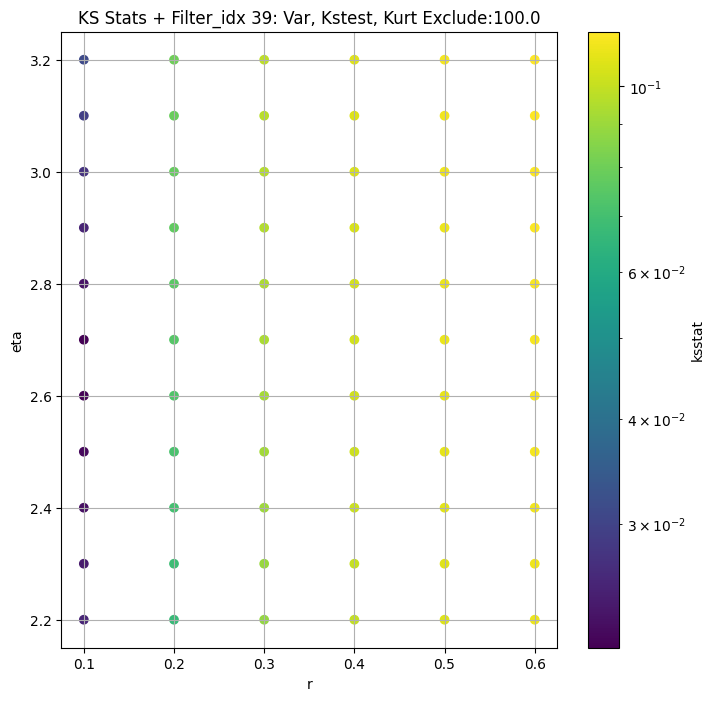

####
Filter_idx  40


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.03312591241288754 66.21320774973643


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.017003922652455872 36.582138117355065


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.013071265969805013 31.900558912520882


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.009334465916074453 27.639523525539214
Number of samples: 100000, Without approximation : 786432000.0


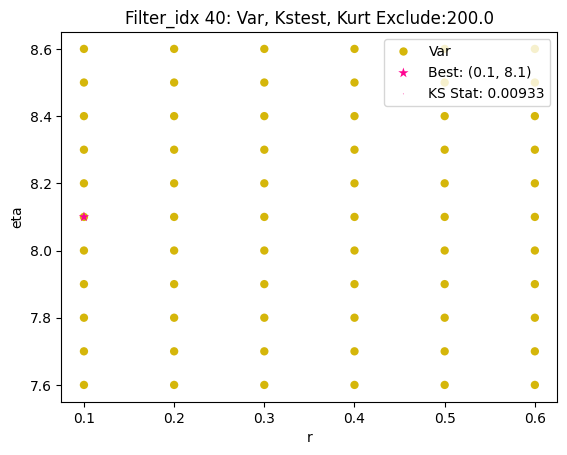

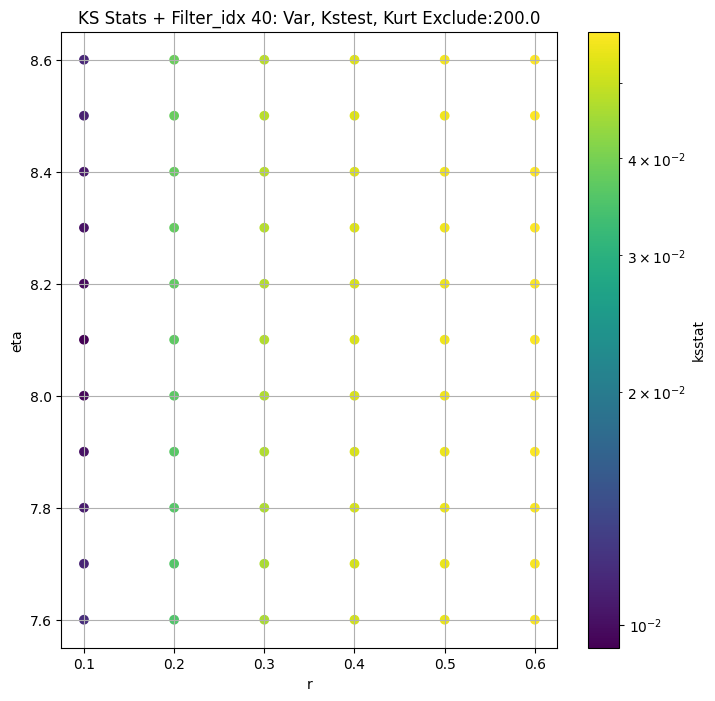

####
Filter_idx  41


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.025532701639719768 35.86369997511561


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.01227267966225598 17.392564944120956


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.009867218196908722 15.267777949669501


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.007184167679853415 13.225834705872938
Number of samples: 100000, Without approximation : 786432000.0


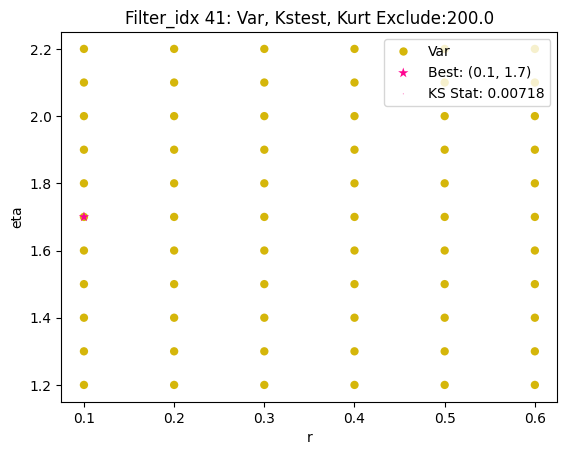

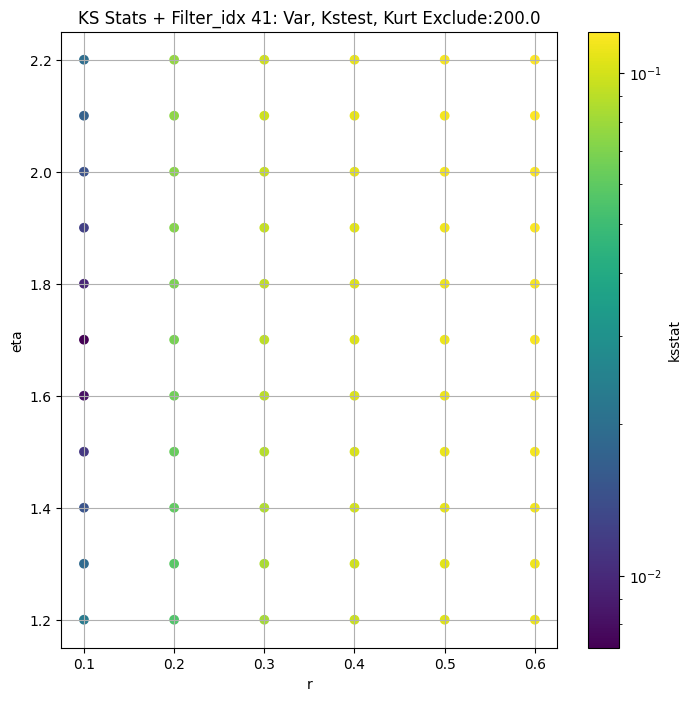

####
Filter_idx  42


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 0 0.024990245122463284 122.86762645260158


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 50 0.006370241336867699 53.819600343005526


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 100 0.002070465109701769 46.69382309607271


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
42 200 0.0028403660846131554 40.578674690326906
Number of samples: 100000, Without approximation : 786432000.0


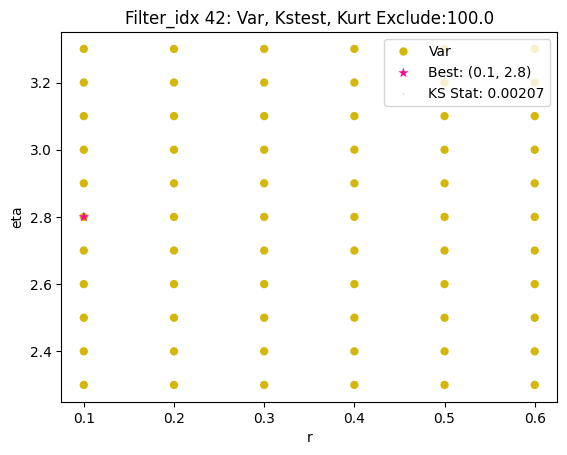

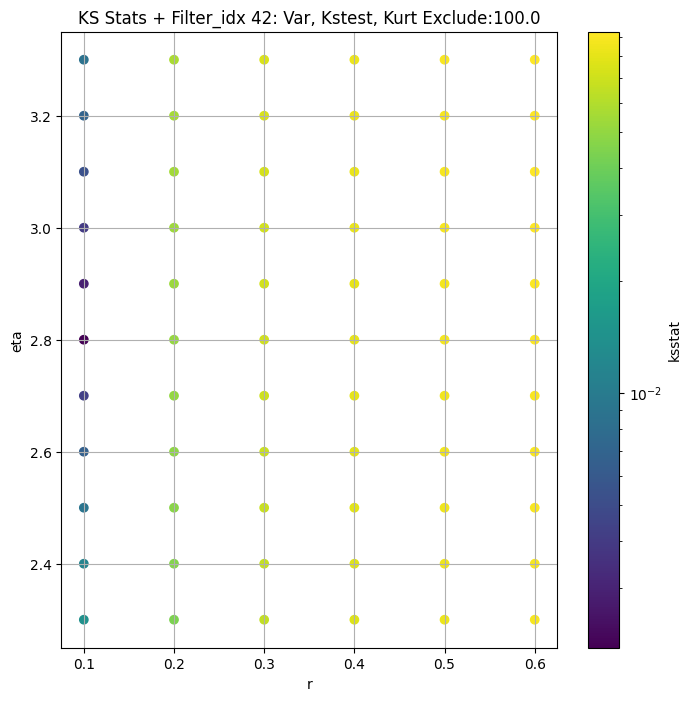

####
Filter_idx  43


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 0 0.02243067951402572 42.07373496727608


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 50 0.005167564302416272 19.121343045646032


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 100 0.0030114577669281273 16.71229838930892


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
43 200 0.004823636410669407 14.6182522286494
Number of samples: 100000, Without approximation : 786432000.0


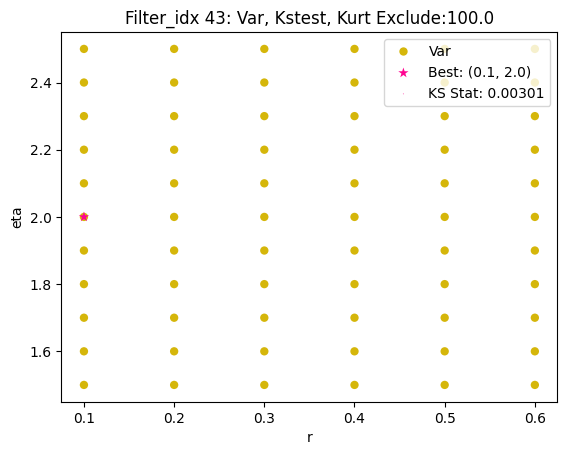

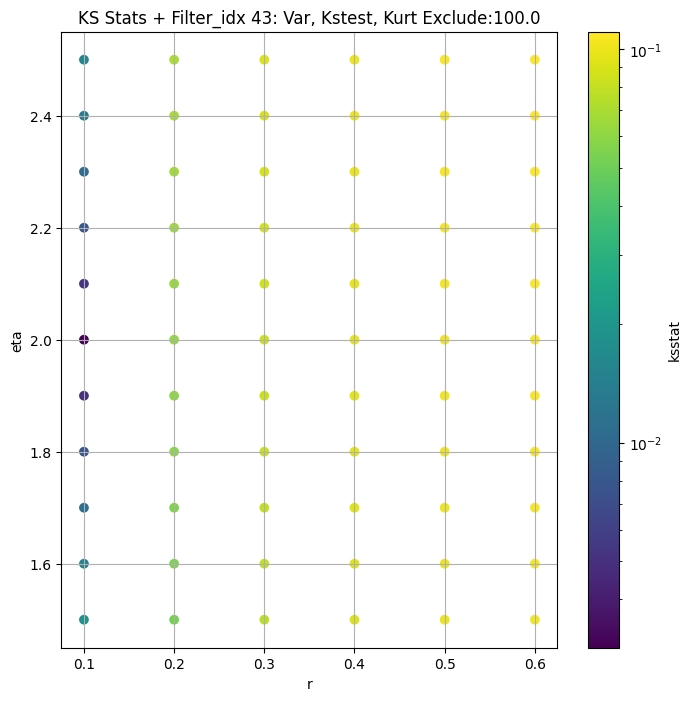

####
Filter_idx  44


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 0 0.020231852591180655 129.22281369823193


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 50 0.005005999212704726 67.44550022318028


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 100 0.0020169234578280015 58.16300887848578


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
44 200 0.0034310925680591693 50.102586927146724
Number of samples: 100000, Without approximation : 786432000.0


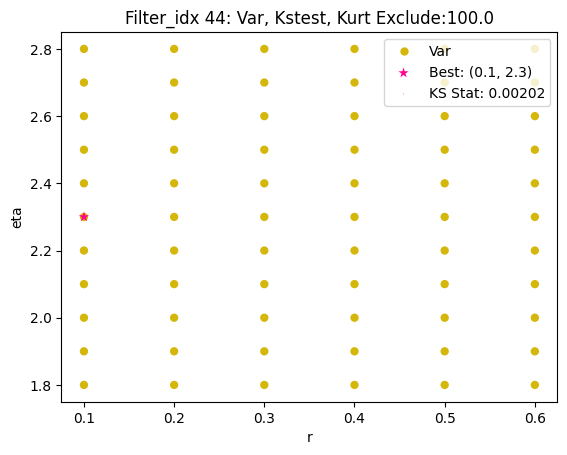

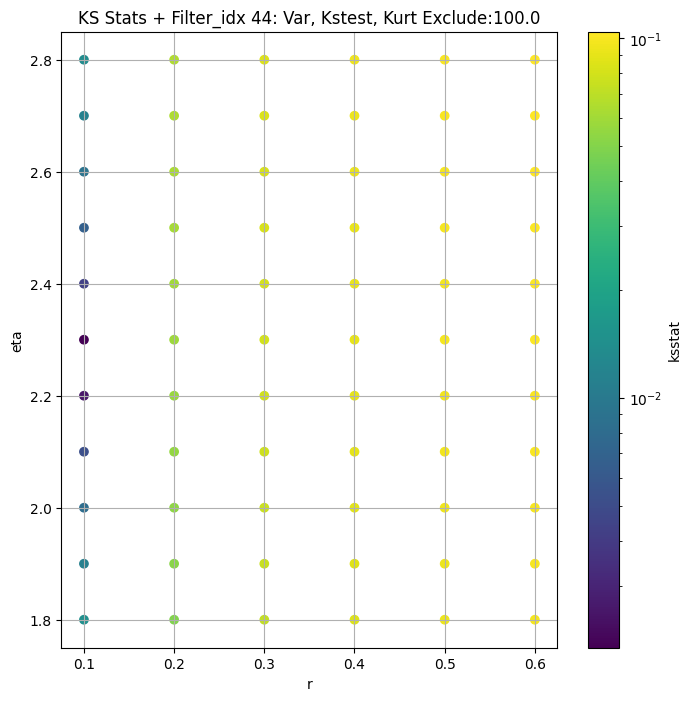

####
Filter_idx  45


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 0 0.023369671632475386 66.14061102250322


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 50 0.00878055386012927 32.1468200417068


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 100 0.005486562704155817 27.246376435317217


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
45 200 0.004751794643740204 23.412529676480904
Number of samples: 100000, Without approximation : 786432000.0


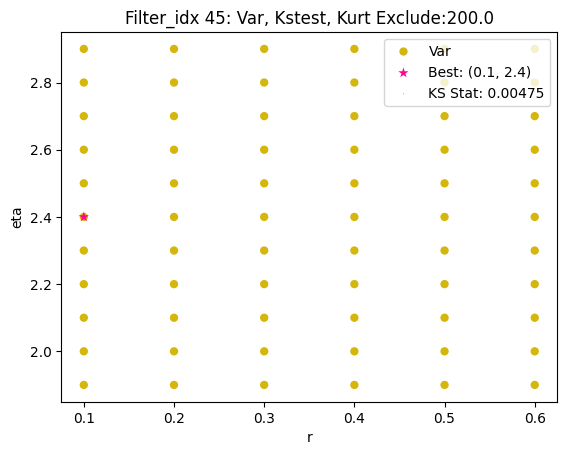

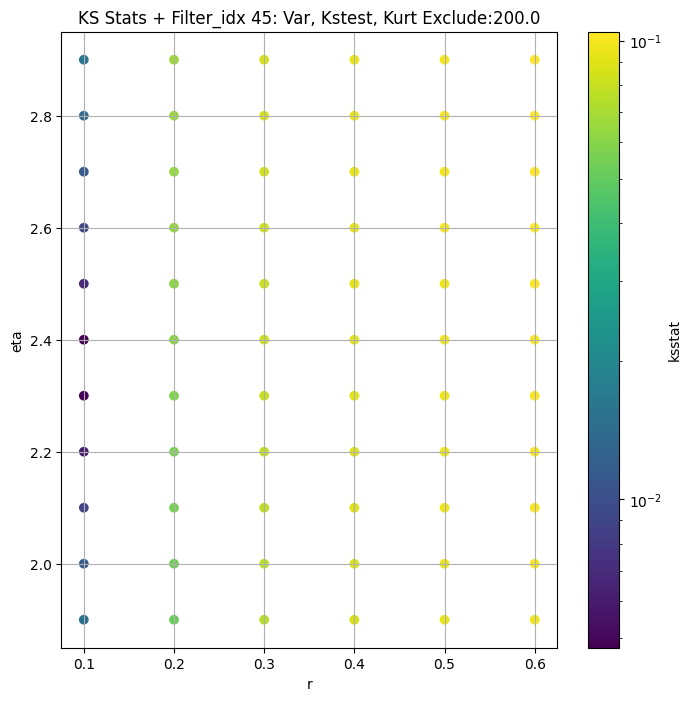

####
Filter_idx  46


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 0 0.029259684789491536 34.67245929741784


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 50 0.015520804875538141 19.277886038265834


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 100 0.01357408162376178 16.555427635790334


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
46 200 0.013479376496550732 14.246562635723775
Number of samples: 100000, Without approximation : 786432000.0


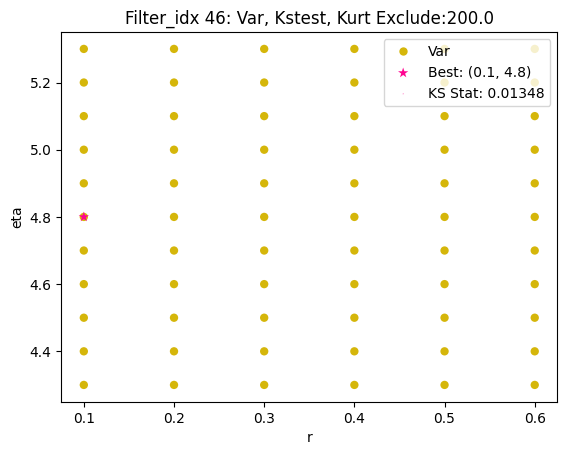

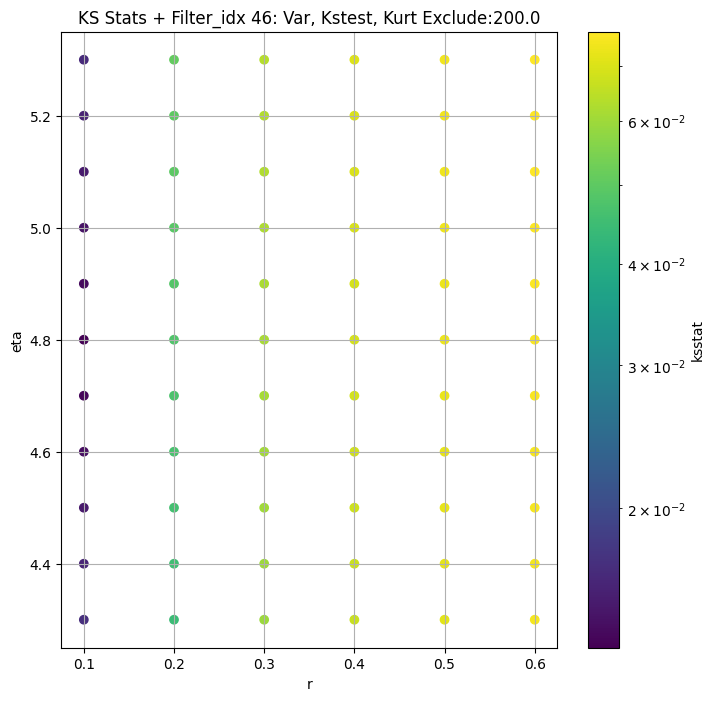

####
Filter_idx  47


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 0 0.021746808398686035 51.103251617939364


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 50 0.005117369979486766 24.05117683912482


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 100 0.002716561349833446 20.639943504793028


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
47 200 0.002828641985716529 17.540739992436777
Number of samples: 100000, Without approximation : 786432000.0


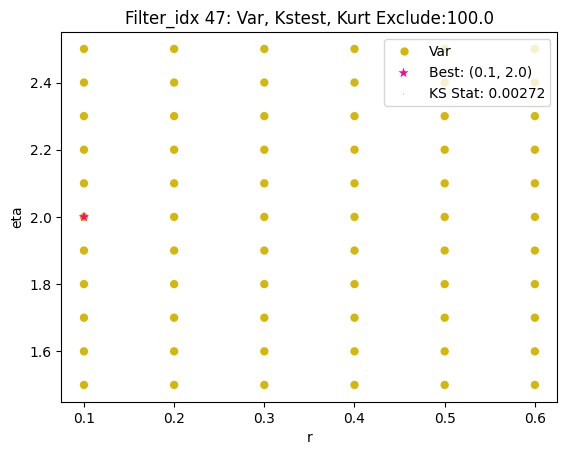

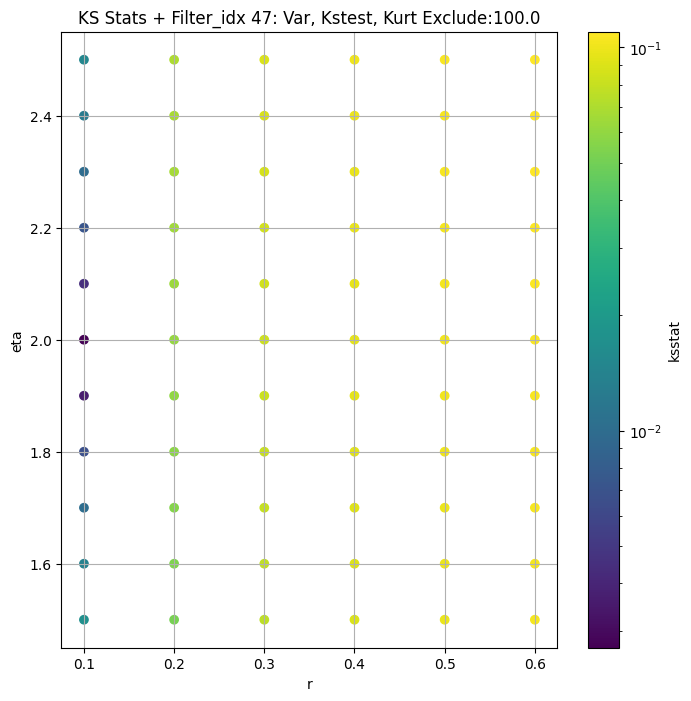

####
Filter_idx  48


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 0 0.022693581425406423 34.059639149915235


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 50 0.011466339827954142 19.107136221508778


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 100 0.009096437306455818 16.464510756708137


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
48 200 0.007200280761601535 13.837379690607387
Number of samples: 100000, Without approximation : 786432000.0


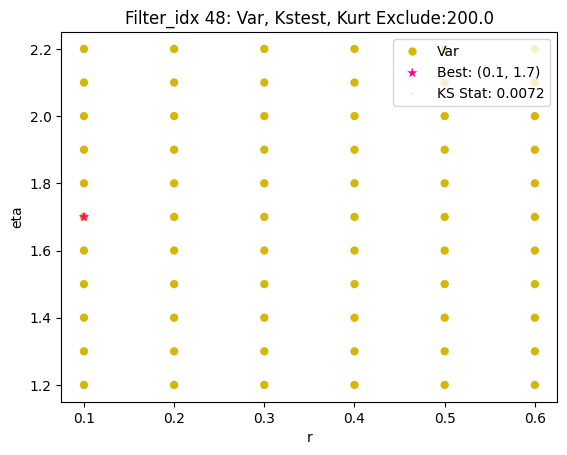

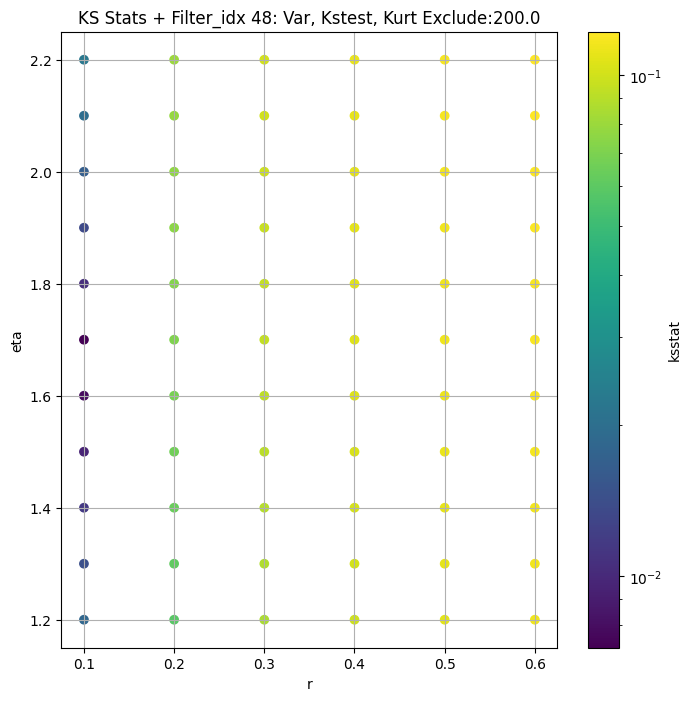

####
Filter_idx  49


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 0 0.020715277255684006 127.86488372385871


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 50 0.004897176304154871 63.65726978321403


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 100 0.002463066838689132 55.57433613503895


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
49 200 0.003733610078305874 48.80672015587818
Number of samples: 100000, Without approximation : 786432000.0


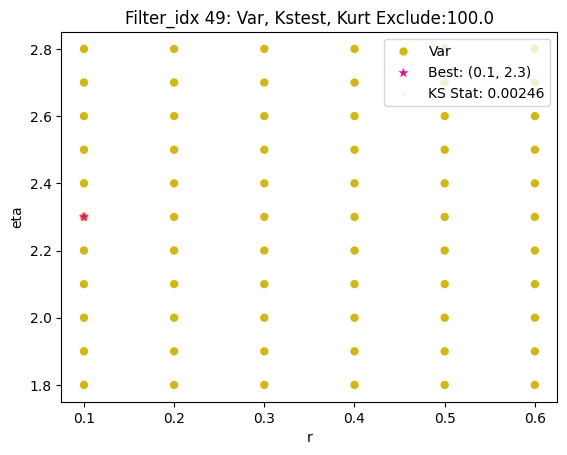

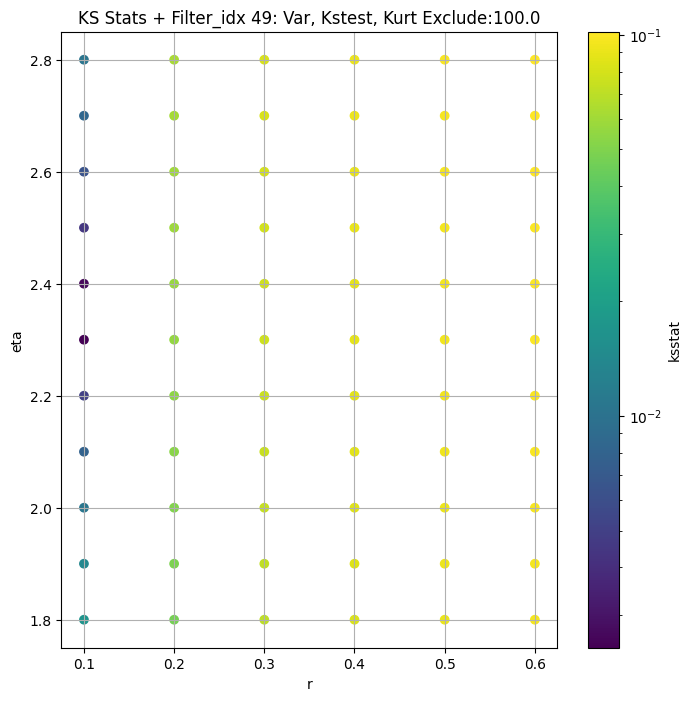

####
Filter_idx  50


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 0 0.023494667600958197 65.95109188413258


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 50 0.007298097189059882 29.451941685960396


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 100 0.00487475637364615 25.570455009011273


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
50 200 0.004943015528880823 22.243735446195927
Number of samples: 100000, Without approximation : 786432000.0


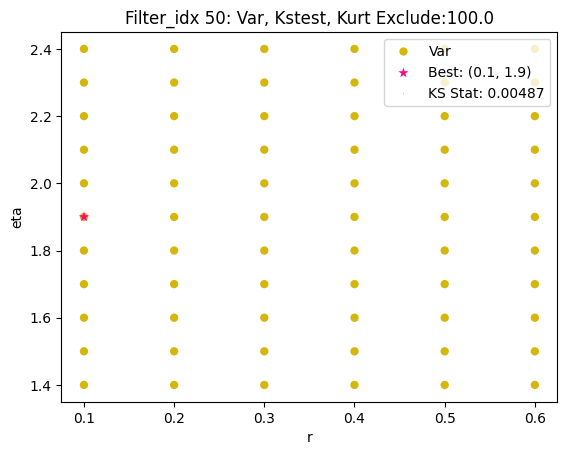

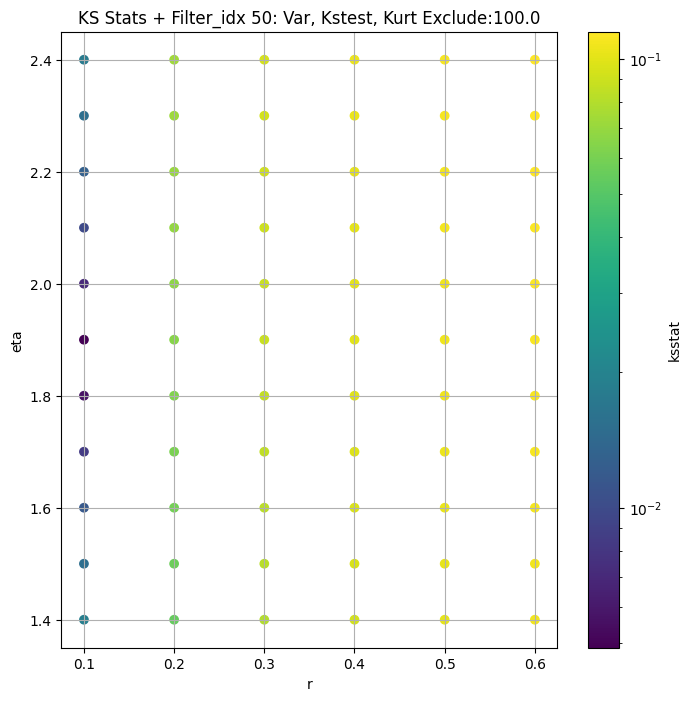

####
Filter_idx  52


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 0 0.03197169548299328 68.56524931020044


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 50 0.016565847854641658 38.01005514976738


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 100 0.012388044466373524 32.808175415526335


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
52 200 0.008328746055784667 28.324950424559876
Number of samples: 100000, Without approximation : 786432000.0


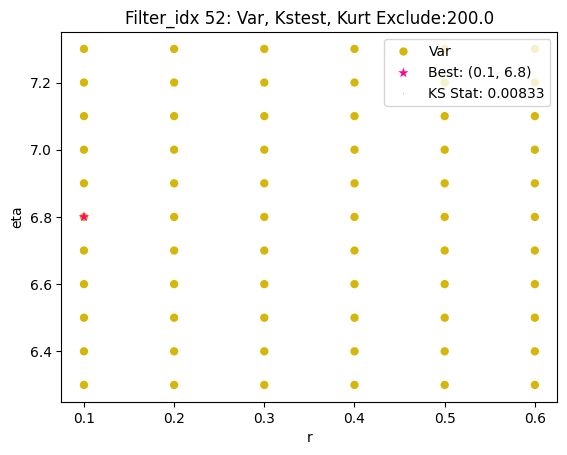

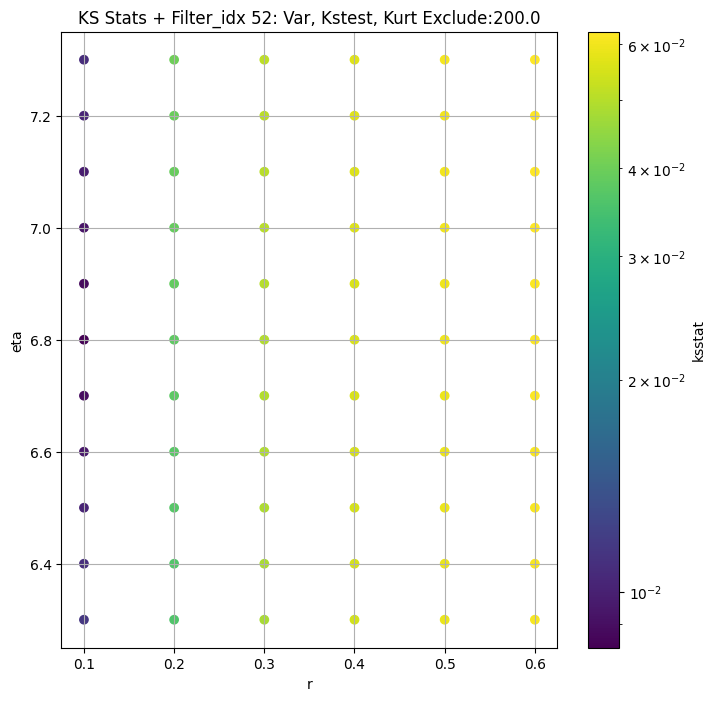

####
Filter_idx  54


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 0 0.034519874814630105 19.843015711038905


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 50 0.017518464049979754 6.580064871139735


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 100 0.012744498717754474 5.389885470482396


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
54 200 0.008297577996706301 4.221179762426768
Number of samples: 100000, Without approximation : 786432000.0


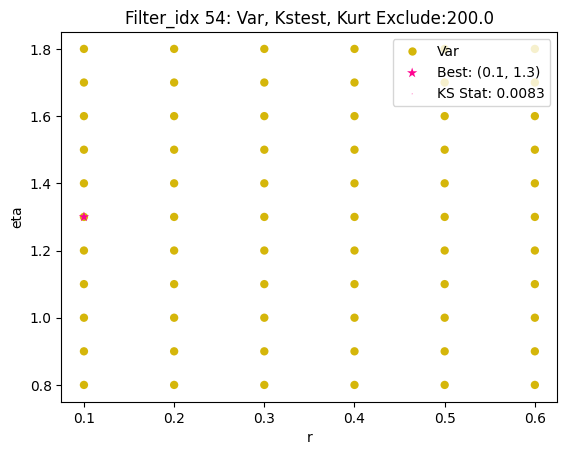

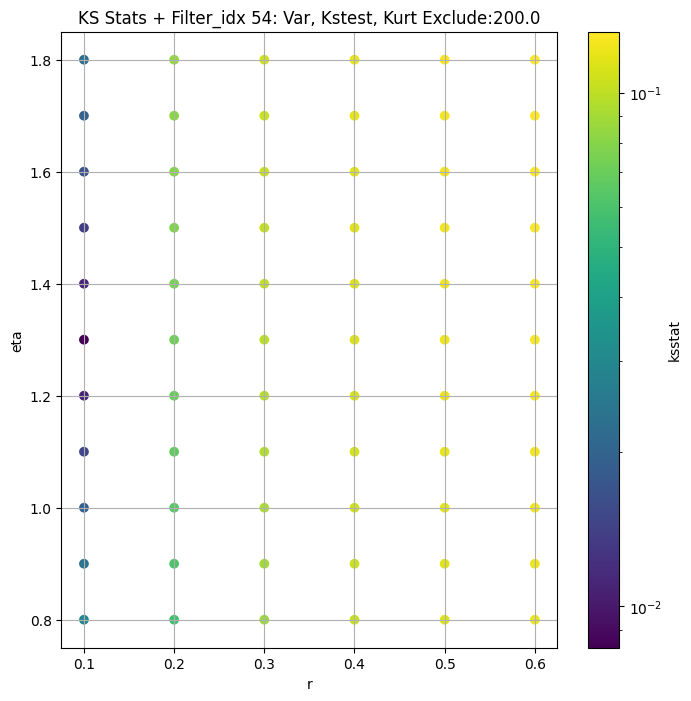

####
Filter_idx  55


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 0 0.023120538065443716 44.32252053089933


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 50 0.009091977906974705 22.07867610021727


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 100 0.007181283562392754 19.2442265873234


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
55 200 0.003913297486088849 16.584547809915186
Number of samples: 100000, Without approximation : 786432000.0


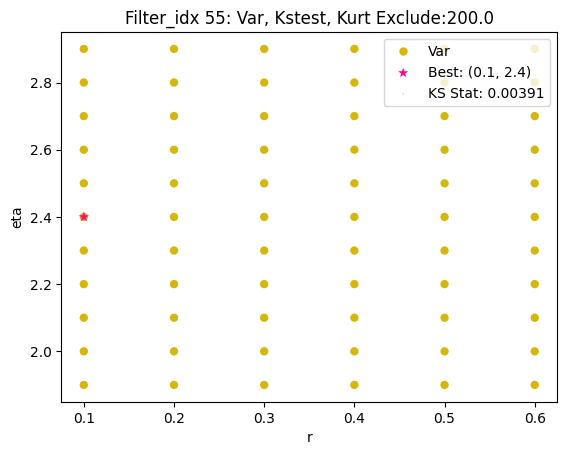

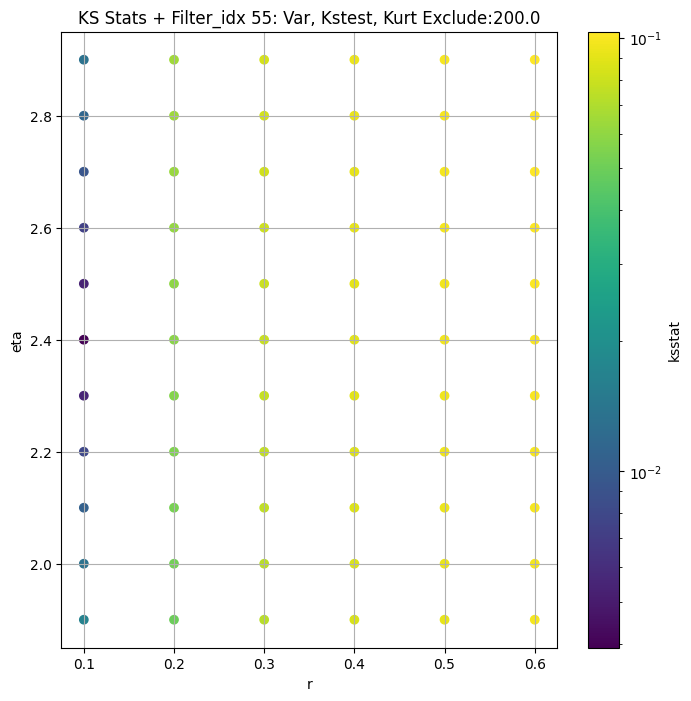

####
Filter_idx  56


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 0 0.0173330255612235 80.94409186083045


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 50 0.00318109514710474 36.604603638022695


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 100 0.004150211816846272 31.624292402179606


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
56 200 0.005124472484841158 27.228572761155334
Number of samples: 100000, Without approximation : 786432000.0


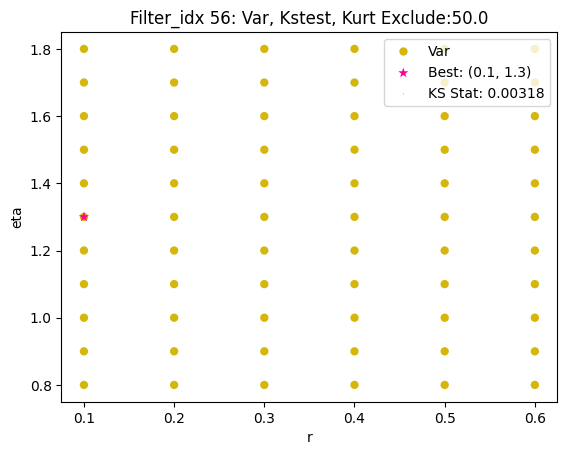

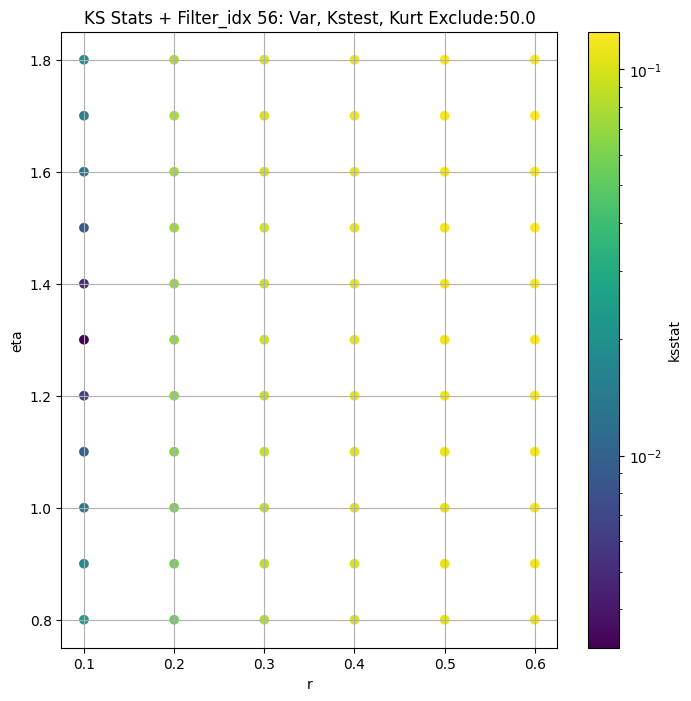

####
Filter_idx  57


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 0 0.022220453554593858 48.81226848482479


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 50 0.00915262833227104 25.73311167537041


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 100 0.006504544030907833 22.51019487155128


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
57 200 0.004083421466257731 19.66077560086873
Number of samples: 100000, Without approximation : 786432000.0


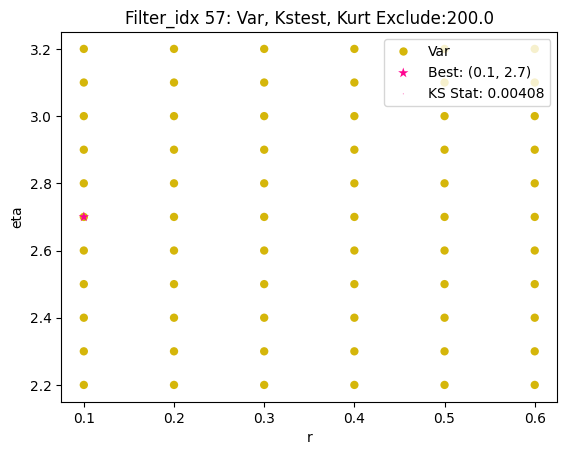

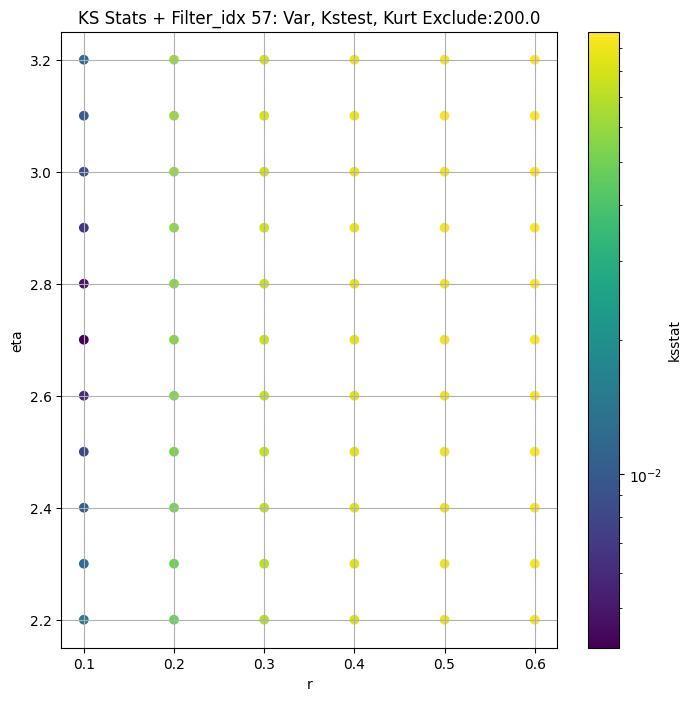

####
Filter_idx  58


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 0 0.033054683259879376 43.24300222539841


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 50 0.0175503864396942 22.291532432881834


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 100 0.014682429656833917 19.25573640764299


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
58 200 0.012357239517666097 16.680156179255277
Number of samples: 100000, Without approximation : 786432000.0


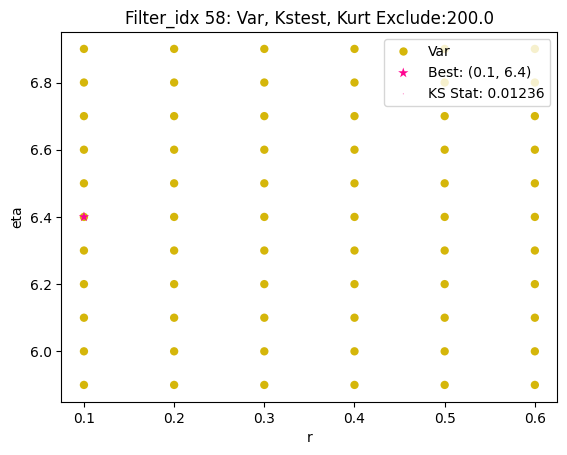

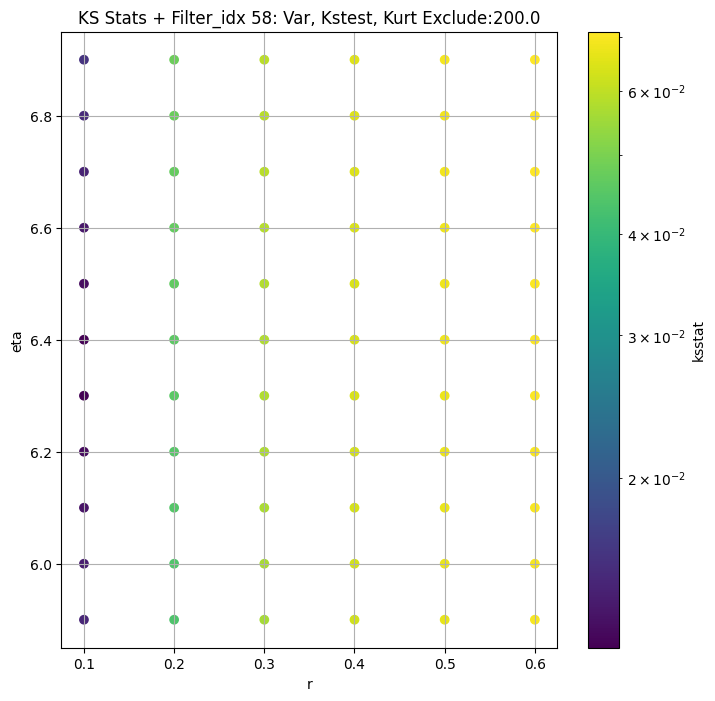

####
Filter_idx  59


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 0 0.02539675095786098 98.21557298868706


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 50 0.004831572107135085 38.558463226735434


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 100 0.0015769020841573944 33.35019965587266


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
59 200 0.0028682589853606943 28.987559489945752
Number of samples: 100000, Without approximation : 786432000.0


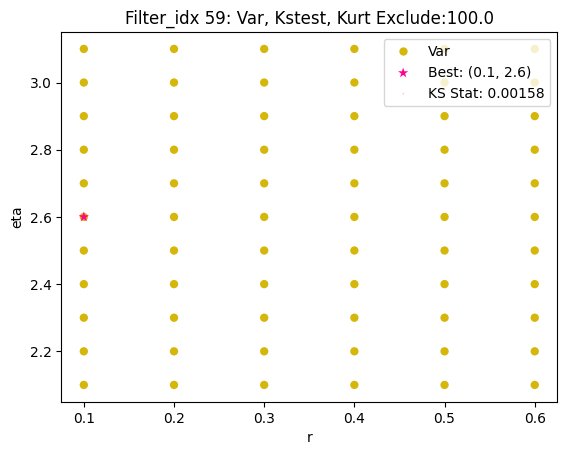

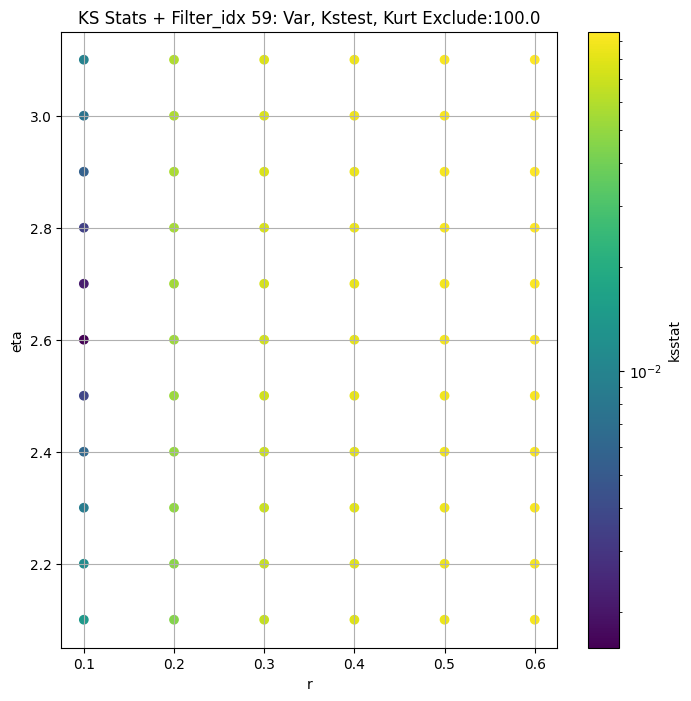

####
Filter_idx  60


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 0 0.0372916748082589 5.679019685201715


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 50 0.020469306273927845 2.4894750547570266


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 100 0.017567415025282362 2.1377710227404005


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
60 200 0.015449093980608564 1.8195571497476375
Number of samples: 100000, Without approximation : 786432000.0


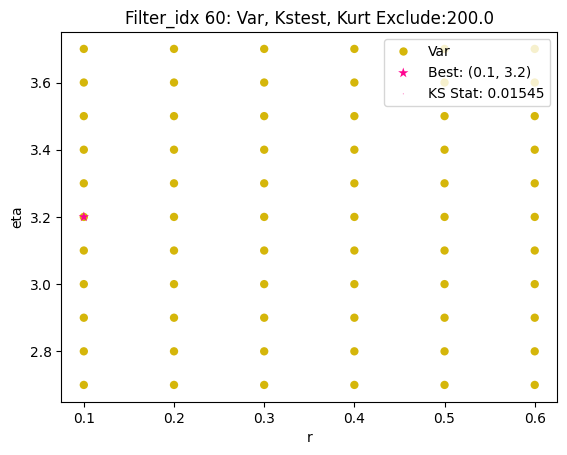

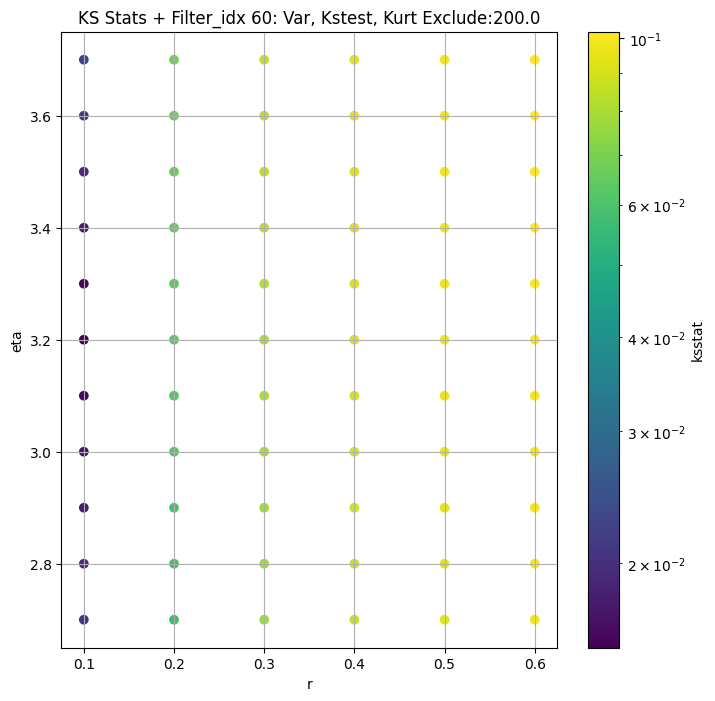

####
Filter_idx  61


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 0 0.0222900457233266 38.84864213369093


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 50 0.008688305621734727 20.23753424733006


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 100 0.005962278745791028 17.654236741836712


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
61 200 0.003723315281771722 15.10109018073086
Number of samples: 100000, Without approximation : 786432000.0


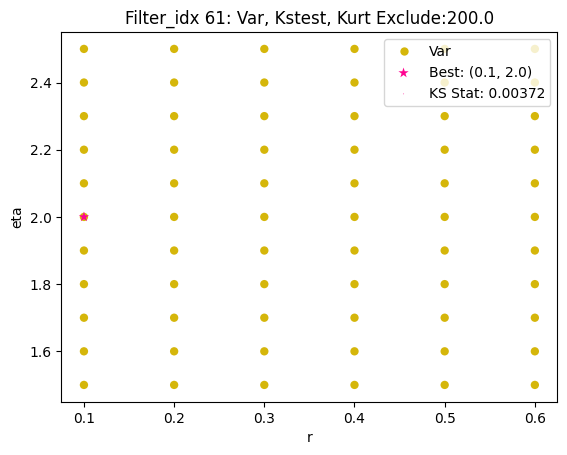

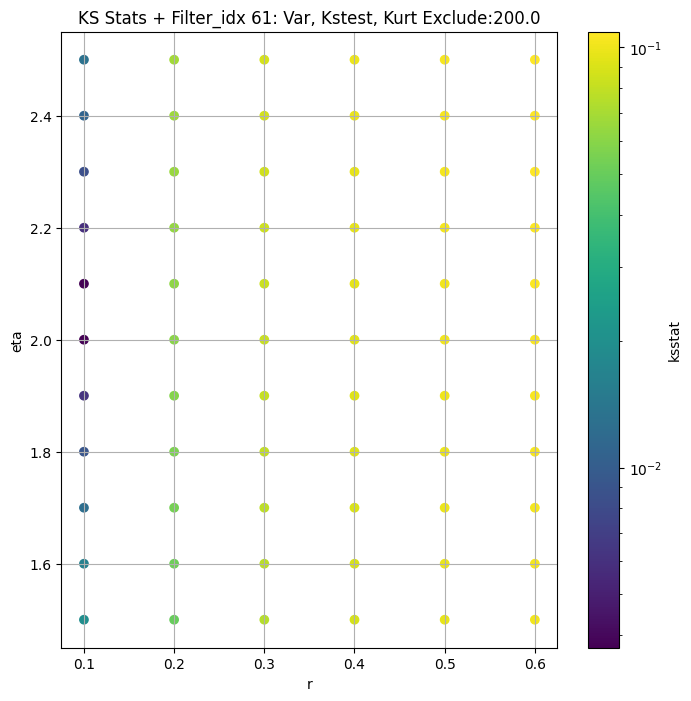

####
Filter_idx  62


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 0 0.024907699917236542 59.548783829845355


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 50 0.005861729370705726 23.67488317878983


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 100 0.004503441438467259 20.311188179250713


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
62 200 0.0043509550508269434 17.380491371664693
Number of samples: 100000, Without approximation : 786432000.0


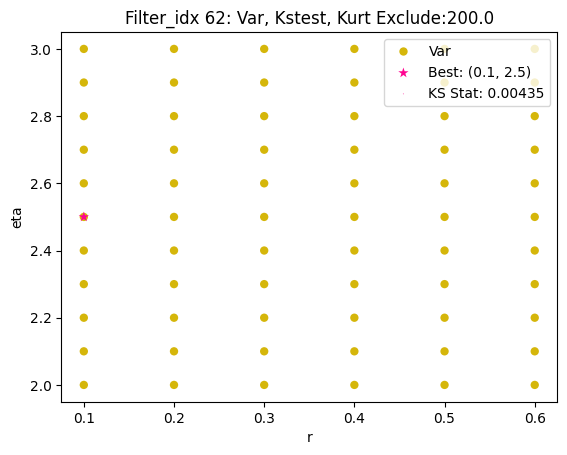

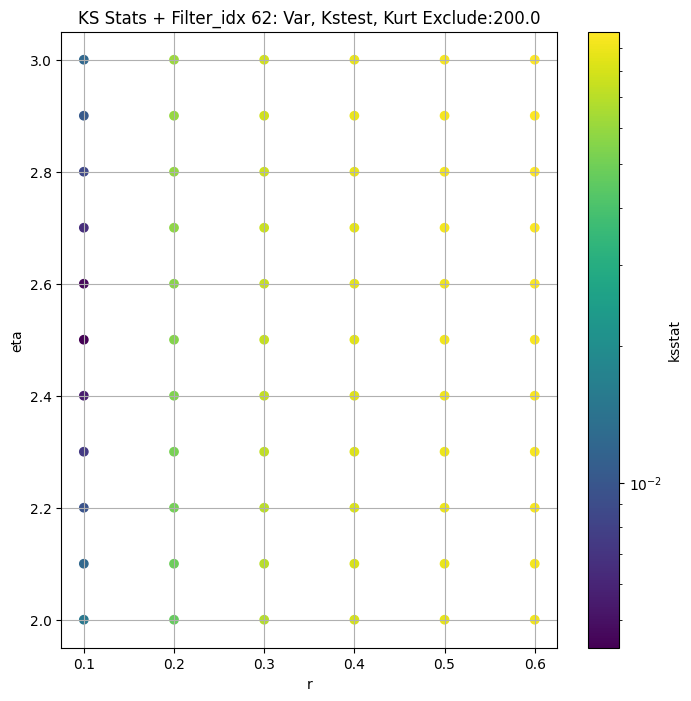

####
Filter_idx  63


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 0 0.027691016901925436 18.61854636292228


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 50 0.01308009382908698 7.814190876783737


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 100 0.011091189851662797 6.802578077439762


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
63 200 0.007846593262894719 5.805831317995545
Number of samples: 100000, Without approximation : 786432000.0


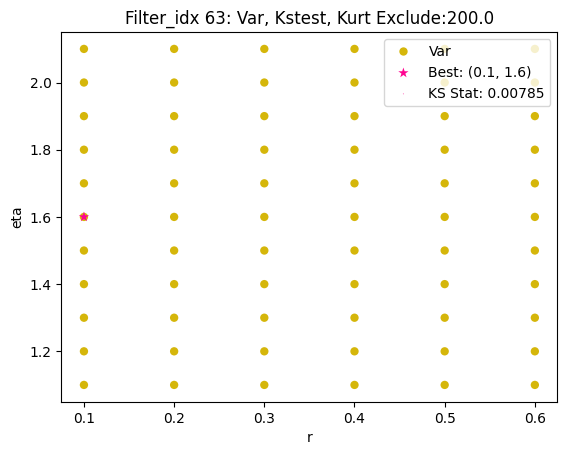

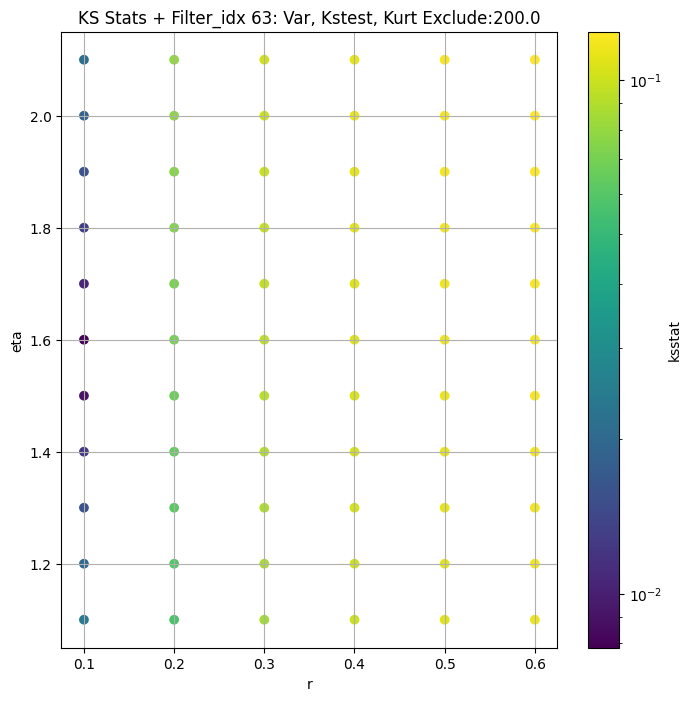

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,
0,102.855110,34.849758,997.697198,1502.615755,7.320611,862.964342,786432000.0,dual_color,0.003532,0.1,3.2,3.000261e-16,200.0,38.766630,0.000048
2,139.086423,48.057759,1221.082277,1361.038621,5.617098,888.334774,786432000.0,dual_color,0.002496,0.1,2.9,8.541342e-16,100.0,60.437111,0.000048
3,59.225396,17.890088,677.785535,4588.658273,14.044662,919.821907,786432000.0,single_edge,0.006372,0.1,1.8,3.801138e-15,200.0,20.296453,0.000048
4,147.182613,50.443288,1229.274555,1431.721726,6.789153,824.932666,786432000.0,dual_color,0.002543,0.1,1.8,1.368008e-14,50.0,73.045761,0.000048
5,61.703786,18.847785,682.077717,2256.644242,8.930134,918.159627,786432000.0,dual_color,0.004665,0.1,2.4,1.053687e-15,100.0,25.009219,0.000048
6,53.870009,16.817911,754.619495,3445.876441,7.006285,909.048889,786432000.0,single_edge,0.003904,0.1,2.9,2.724337e-16,200.0,19.276955,0.000048
7,73.311829,24.301443,517.953978,864.939042,6.691776,794.740489,786432000.0,inside_out,0.018666,0.2,2.1,8.498883e-06,200.0,26.857150,0.000048
8,2.374744,0.544201,65.257886,9343.251562,9.472070,970.760321,786432000.0,misc,0.017402,0.1,2.4,2.550898e-17,200.0,0.605454,0.000048
9,21.870066,3.657099,637.020372,13315.085018,13.594812,969.358189,786432000.0,multi_edge,0.014395,0.1,0.5,5.970165e-14,200.0,4.339409,0.000048


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()} ", group)
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + 100 = 300, ksstat: 0.005615852206328764, var: 35.42335496922591


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + 75 = 275, ksstat: 0.005158140985822568, var: 36.12477244436984


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + 50 = 250, ksstat: 0.004616289648873839, var: 36.90156008318758


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + 25 = 225, ksstat: 0.0040570639542366616, var: 37.77294631800896


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + 0 = 200, ksstat: 0.0035318399181399895, var: 38.76662969623278


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + -25 = 175, ksstat: 0.002946361314146273, var: 39.92306139259902


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + -50 = 150, ksstat: 0.0028533448945929907, var: 41.30241107666642


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + -75 = 125, ksstat: 0.003190809728750188, var: 43.00145434878316


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 0, 200.0 + -100 = 100, ksstat: 0.004054696631787591, var: 45.18661416598332
Number of samples: 100000, Without approximation : 786432000.0


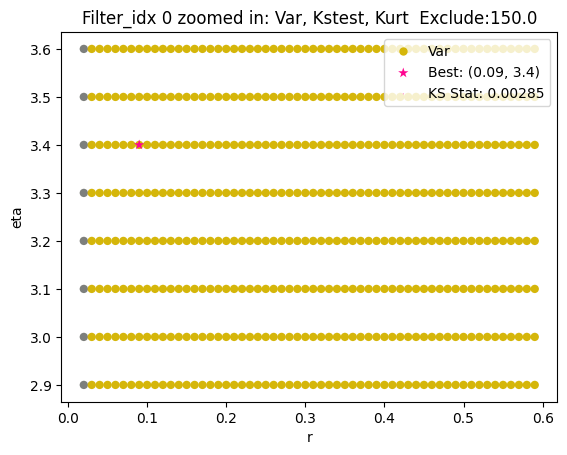

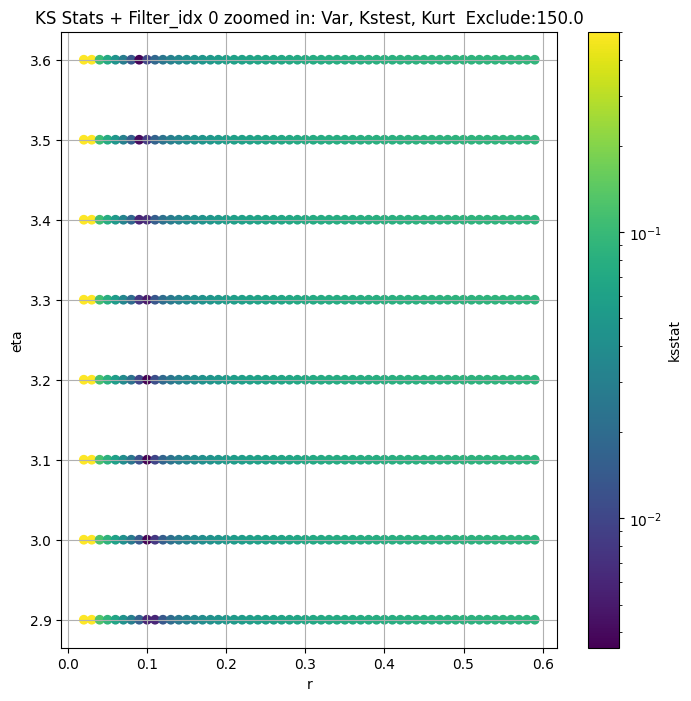

Filter_idx 2


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + 100 = 200, ksstat: 0.004056204120189616, var: 52.60710132359016


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + 75 = 175, ksstat: 0.0031146474748510733, var: 53.99849524263106


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + 50 = 150, ksstat: 0.0029998815969276005, var: 55.66277415349407


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + 25 = 125, ksstat: 0.0023313637786849806, var: 57.731410963167


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + 0 = 100, ksstat: 0.0024957968588637525, var: 60.43711063366751


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + -25 = 75, ksstat: 0.0021042618467665974, var: 64.24367979395448


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + -50 = 50, ksstat: 0.004388445632846127, var: 70.22722095402338


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + -75 = 25, ksstat: 0.007817938360969556, var: 81.5792090579233


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 2, 100.0 + -100 = 0, ksstat: 0.018590438630500583, var: 139.0864226108086
Number of samples: 100000, Without approximation : 786432000.0


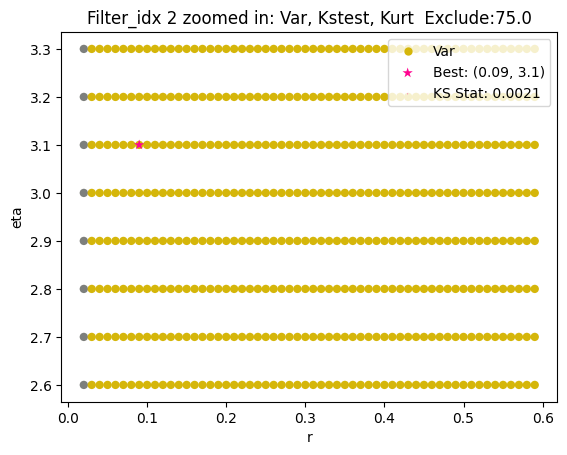

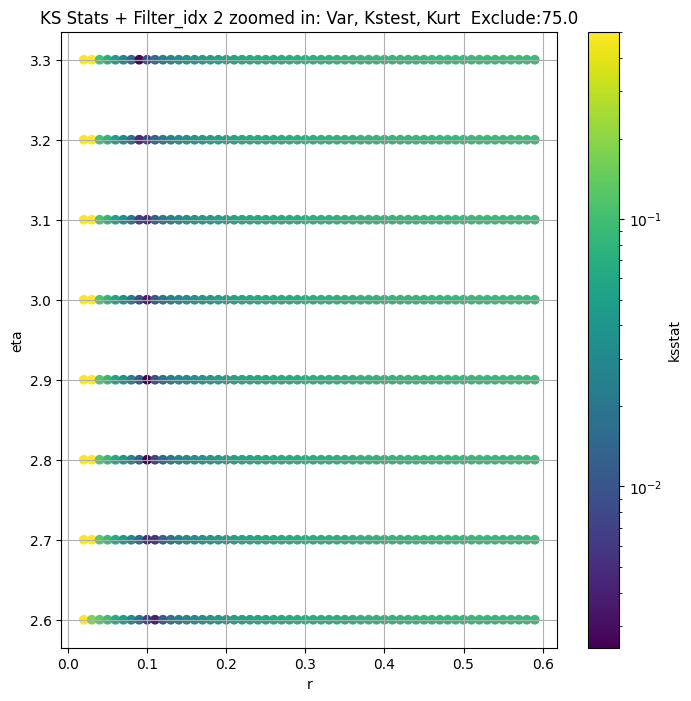

Filter_idx 3


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + 100 = 300, ksstat: 0.004730694765994192, var: 17.801022330879352


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + 75 = 275, ksstat: 0.004367232029049095, var: 18.323851387222742


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + 50 = 250, ksstat: 0.005131725972518292, var: 18.904840774757467


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + 25 = 225, ksstat: 0.005278471762915904, var: 19.556730290203827


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + 0 = 200, ksstat: 0.006157257326336263, var: 20.296452552289775


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + -25 = 175, ksstat: 0.007231056539609426, var: 21.147481582344504


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + -50 = 150, ksstat: 0.008218829621704615, var: 22.142700252577768


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + -75 = 125, ksstat: 0.008483631463462316, var: 23.329010086700976


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 3, 200.0 + -100 = 100, ksstat: 0.009362223743270823, var: 24.780589584797596
Number of samples: 100000, Without approximation : 786432000.0


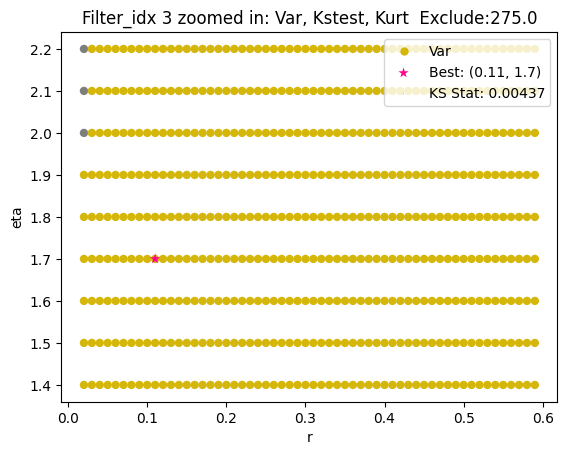

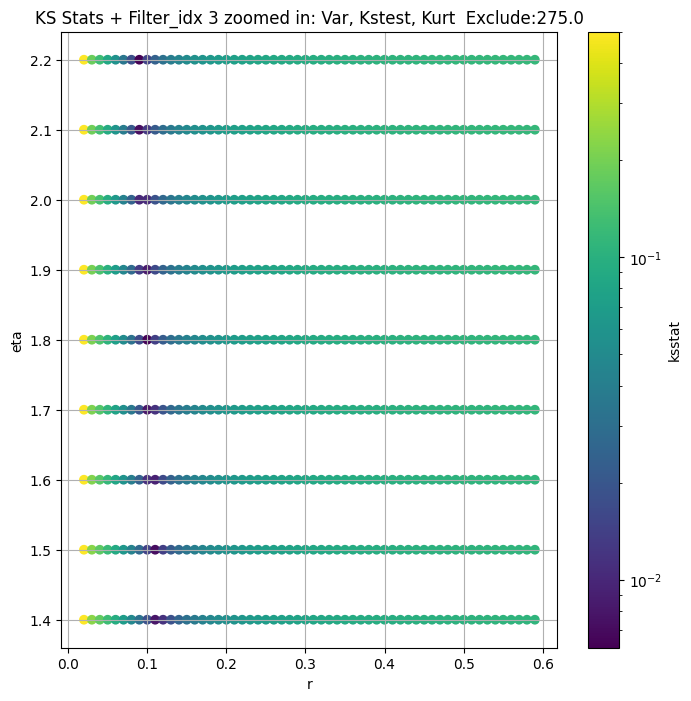

Filter_idx 4


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 50.0 + 100 = 150, ksstat: 0.003600942431797538, var: 58.49584725590287


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 50.0 + 75 = 125, ksstat: 0.002772100826156476, var: 60.70535447231043


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 50.0 + 50 = 100, ksstat: 0.002292088375779655, var: 63.51226421872081


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 50.0 + 25 = 75, ksstat: 0.0013422641445708927, var: 67.31136219535883


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 50.0 + 0 = 50, ksstat: 0.002368326666590849, var: 73.04576133868224


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 50.0 + -25 = 25, ksstat: 0.004999003405306429, var: 83.83030218419043


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 4, 50.0 + -50 = 0, ksstat: 0.016198281620528207, var: 147.18261314105916
Number of samples: 100000, Without approximation : 786432000.0


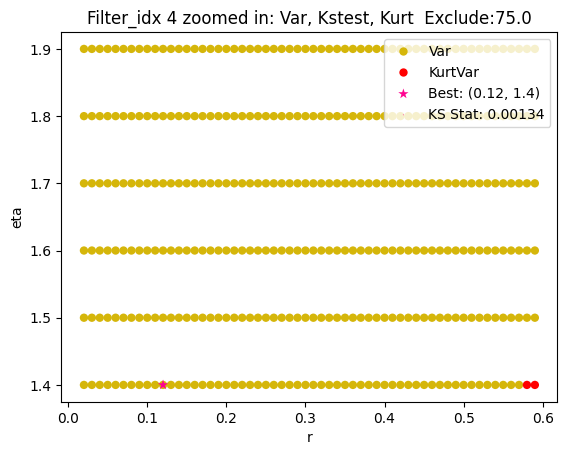

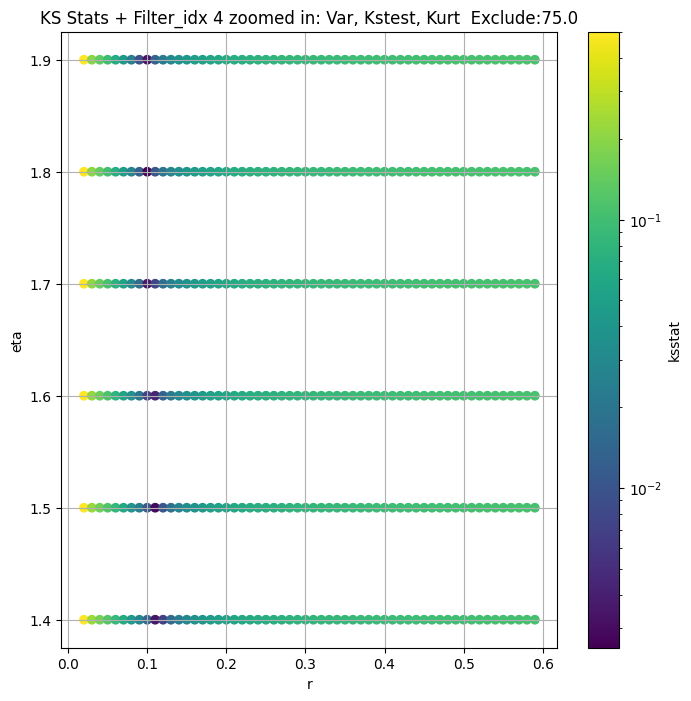

Filter_idx 5


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + 100 = 200, ksstat: 0.004602764937706838, var: 21.285562458954402


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + 75 = 175, ksstat: 0.0046467944939270756, var: 21.970562274124518


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + 50 = 150, ksstat: 0.004578214662851354, var: 22.780789190500013


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + 25 = 125, ksstat: 0.004585704740048657, var: 23.765604429020097


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + 0 = 100, ksstat: 0.004653276333872913, var: 25.009218833407765


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + -25 = 75, ksstat: 0.004837633228535698, var: 26.66809903322438


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + -50 = 50, ksstat: 0.006502335871688136, var: 29.08596138761576


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + -75 = 25, ksstat: 0.00988418784760714, var: 33.331471562178926


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 5, 100.0 + -100 = 0, ksstat: 0.022033242322795354, var: 61.70378578565901
Number of samples: 100000, Without approximation : 786432000.0


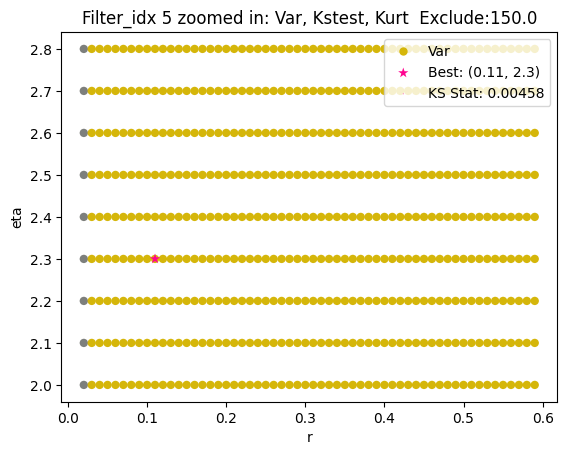

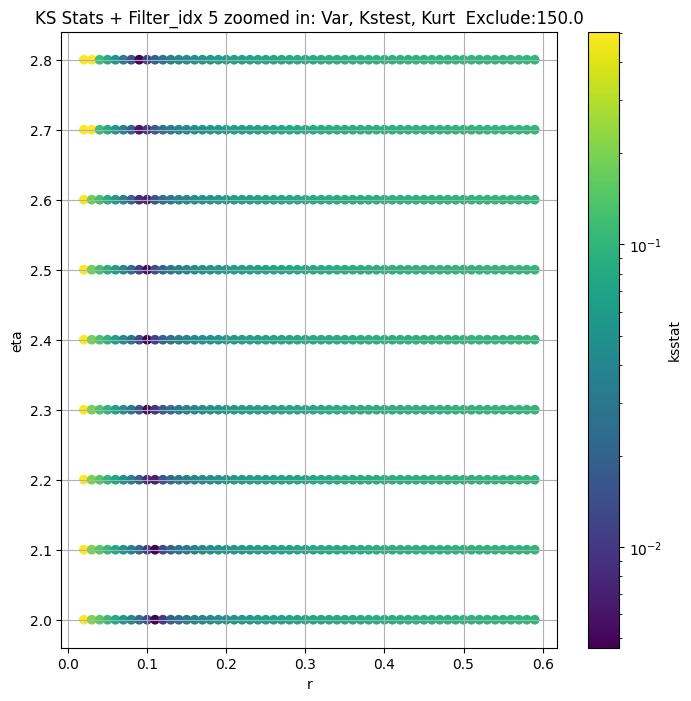

Filter_idx 6


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + 100 = 300, ksstat: 0.005884358813230548, var: 17.692459416850223


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + 75 = 275, ksstat: 0.005379593915192438, var: 18.03048274375727


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + 50 = 250, ksstat: 0.0049085434862873485, var: 18.401403527464353


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + 25 = 225, ksstat: 0.0043470465546791535, var: 18.813097247799742


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + 0 = 200, ksstat: 0.0038078096679562447, var: 19.276955463434465


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + -25 = 175, ksstat: 0.0034380458847040885, var: 19.80979528425703


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + -50 = 150, ksstat: 0.003396790327692467, var: 20.437651059565347


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + -75 = 125, ksstat: 0.003397651481576114, var: 21.20384466976483


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 6, 200.0 + -100 = 100, ksstat: 0.004323047915897216, var: 22.1850899029067
Number of samples: 100000, Without approximation : 786432000.0


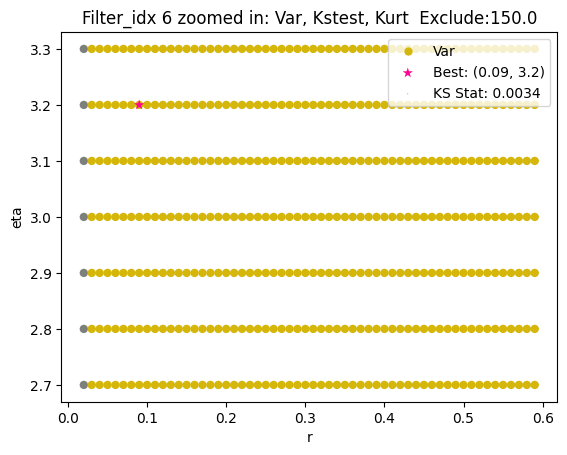

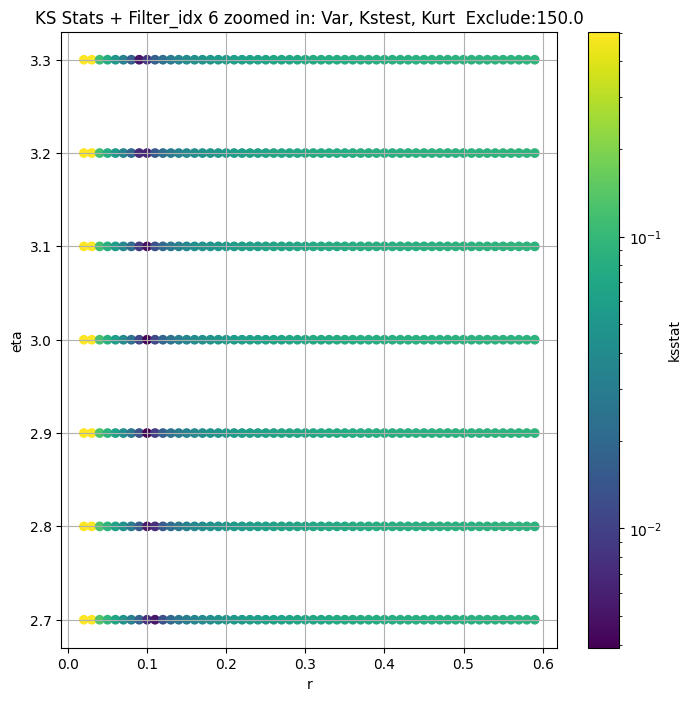

Filter_idx 7


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + 100 = 300, ksstat: 0.01866137027437087, var: 24.46994121222779


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + 75 = 275, ksstat: 0.01866748385131256, var: 24.953233787842084


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + 50 = 250, ksstat: 0.018660478937060354, var: 25.498732887908634


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + 25 = 225, ksstat: 0.018664815634480747, var: 26.124076380127118


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + 0 = 200, ksstat: 0.018666089915658213, var: 26.857149663915628


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + -25 = 175, ksstat: 0.018667438406784476, var: 27.73872770392311


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + -50 = 150, ksstat: 0.018660960628771928, var: 28.820117272778415


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + -75 = 125, ksstat: 0.018663331800175764, var: 30.18334356929417


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 7, 200.0 + -100 = 100, ksstat: 0.019076952649115297, var: 31.99210100452963
Number of samples: 100000, Without approximation : 786432000.0


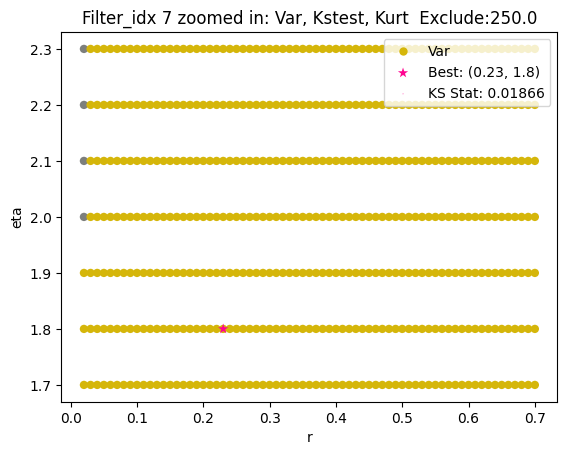

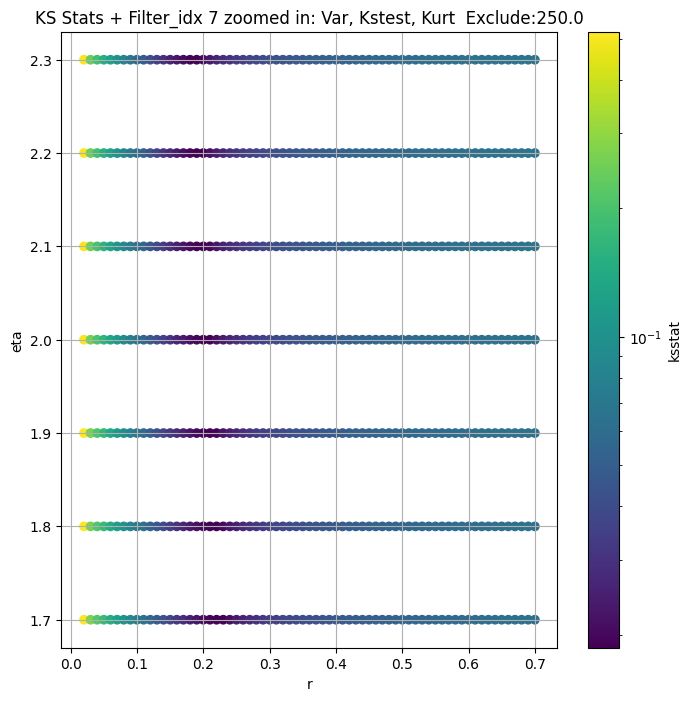

Filter_idx 8


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 100 = 300, ksstat: 0.01664075785571828, var: 0.5488267256107914


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 75 = 275, ksstat: 0.01722635832646291, var: 0.5609015353441372


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 50 = 250, ksstat: 0.017455658718481648, var: 0.5741490857253462


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 25 = 225, ksstat: 0.017198655372557936, var: 0.5888782558404162


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + 0 = 200, ksstat: 0.017401600349595536, var: 0.6054542869293476


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -25 = 175, ksstat: 0.01781076242928159, var: 0.6245013034679613


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -50 = 150, ksstat: 0.01812986201566058, var: 0.6469664794635781


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -75 = 125, ksstat: 0.018578640840297422, var: 0.6743652615648115


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 8, 200.0 + -100 = 100, ksstat: 0.01856655614563485, var: 0.7094179322705357
Number of samples: 100000, Without approximation : 786432000.0


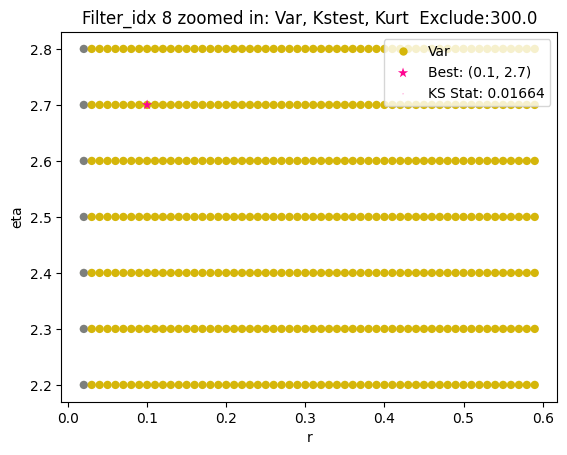

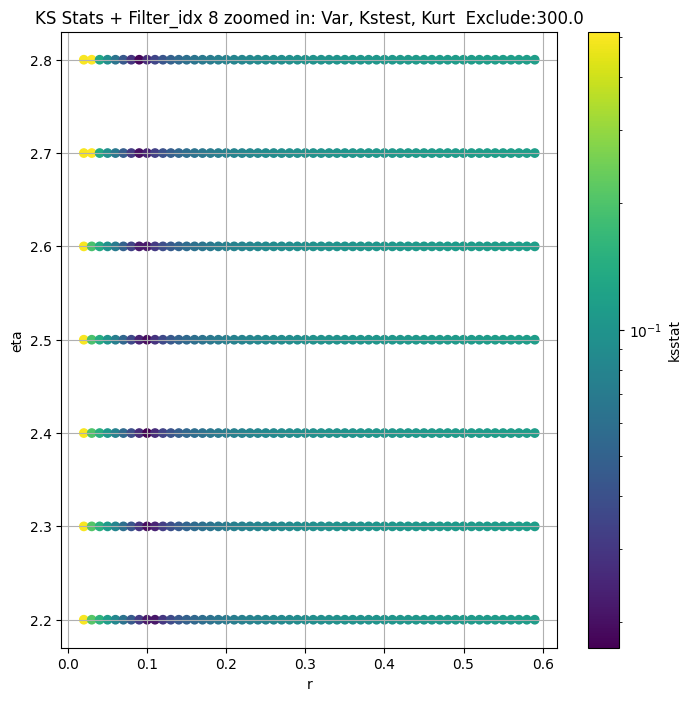

Filter_idx 9


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 100 = 300, ksstat: 0.011359625718923572, var: 3.8590909528708948


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 75 = 275, ksstat: 0.010499006016754686, var: 3.9620285912375635


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 50 = 250, ksstat: 0.011609107208740976, var: 4.074751134468433


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 25 = 225, ksstat: 0.012290609674117325, var: 4.199485737186419


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + 0 = 200, ksstat: 0.011309687468132212, var: 4.339408738127907


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -25 = 175, ksstat: 0.012951507529517292, var: 4.499180145516059


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -50 = 150, ksstat: 0.013096034769489173, var: 4.686138152480263


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -75 = 125, ksstat: 0.014579980364439638, var: 4.912140248894849


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 9, 200.0 + -100 = 100, ksstat: 0.013240819325780251, var: 5.19842766873801
Number of samples: 100000, Without approximation : 786432000.0


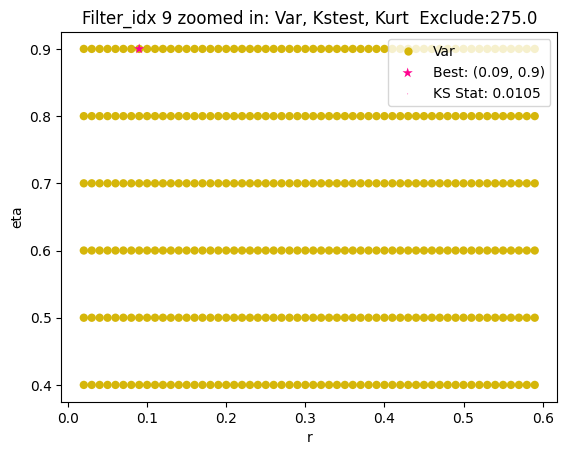

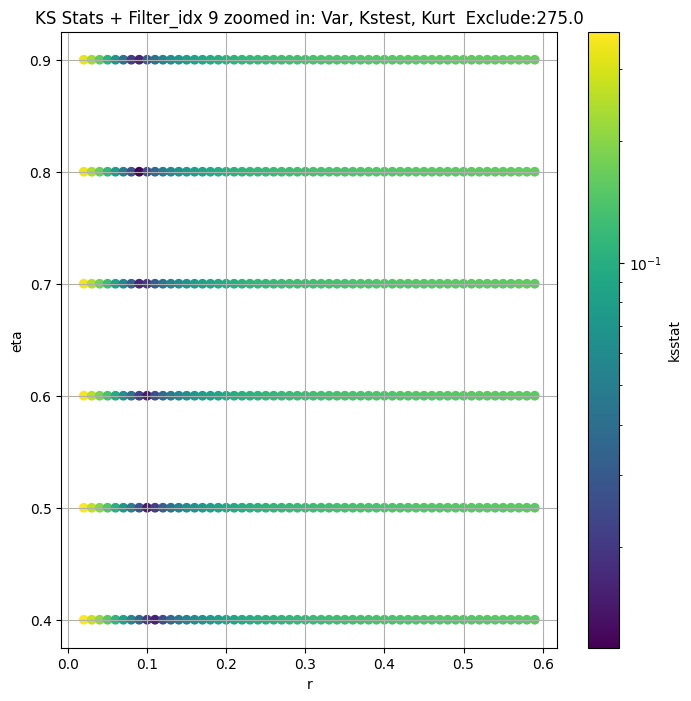

Filter_idx 10


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 100 = 300, ksstat: 0.005515707615016102, var: 18.353332523529595


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 75 = 275, ksstat: 0.00513497823695833, var: 18.745949232184095


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 50 = 250, ksstat: 0.004676527187511902, var: 19.175047028819762


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 25 = 225, ksstat: 0.004840724384900685, var: 19.648341578091454


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + 0 = 200, ksstat: 0.004616926637014962, var: 20.176316043728065


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -25 = 175, ksstat: 0.004646298807330085, var: 20.774259935168637


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -50 = 150, ksstat: 0.004549533969809172, var: 21.464758058295818


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -75 = 125, ksstat: 0.004875033139634333, var: 22.284434465107772


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 10, 200.0 + -100 = 100, ksstat: 0.005508667759077934, var: 23.298543216485637
Number of samples: 100000, Without approximation : 786432000.0


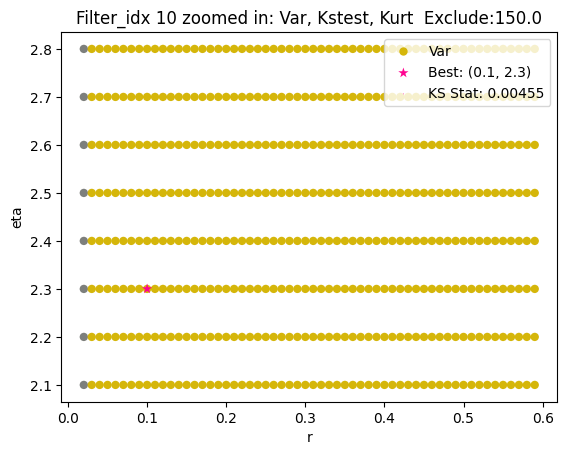

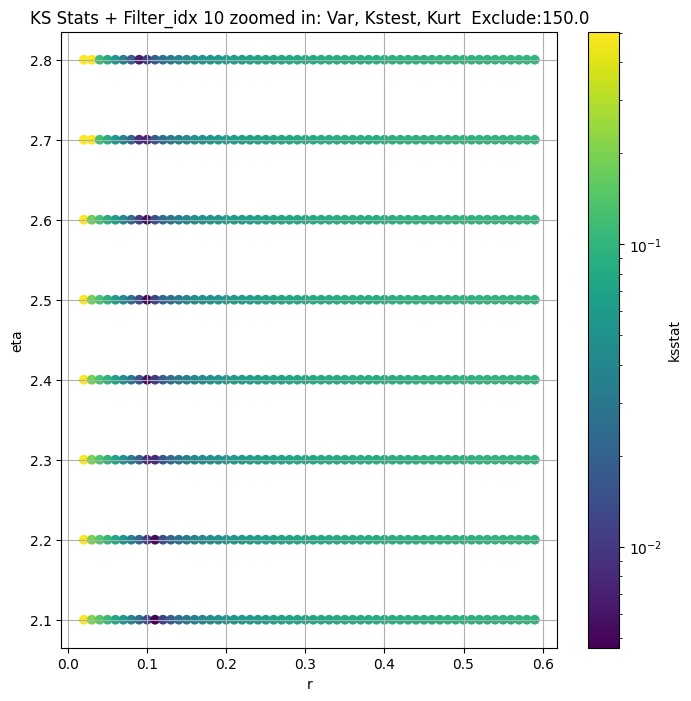

Filter_idx 11


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + 100 = 200, ksstat: 0.004934180148225331, var: 16.914191973299015


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + 75 = 175, ksstat: 0.004181486141362933, var: 17.408751748399034


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + 50 = 150, ksstat: 0.0035871101036281106, var: 17.982493405695884


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + 25 = 125, ksstat: 0.002953025771437967, var: 18.670324887232244


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + 0 = 100, ksstat: 0.0025007058625495793, var: 19.536994272808094


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + -25 = 75, ksstat: 0.0029540856499277734, var: 20.715842969763408


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + -50 = 50, ksstat: 0.00437656957947552, var: 22.524334885563036


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + -75 = 25, ksstat: 0.0063160758680484985, var: 25.901142752148722


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 11, 100.0 + -100 = 0, ksstat: 0.01848847733391379, var: 51.949739070721606
Number of samples: 100000, Without approximation : 786432000.0


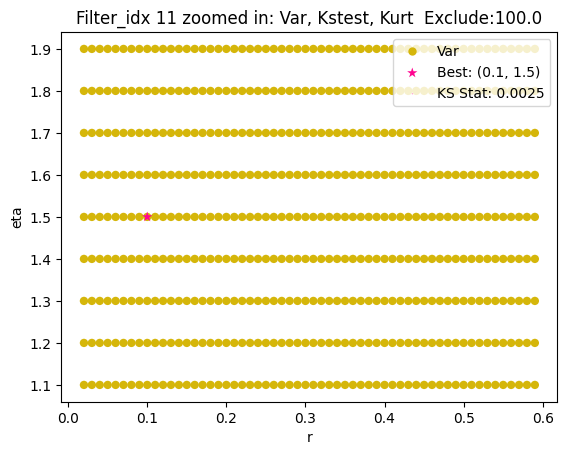

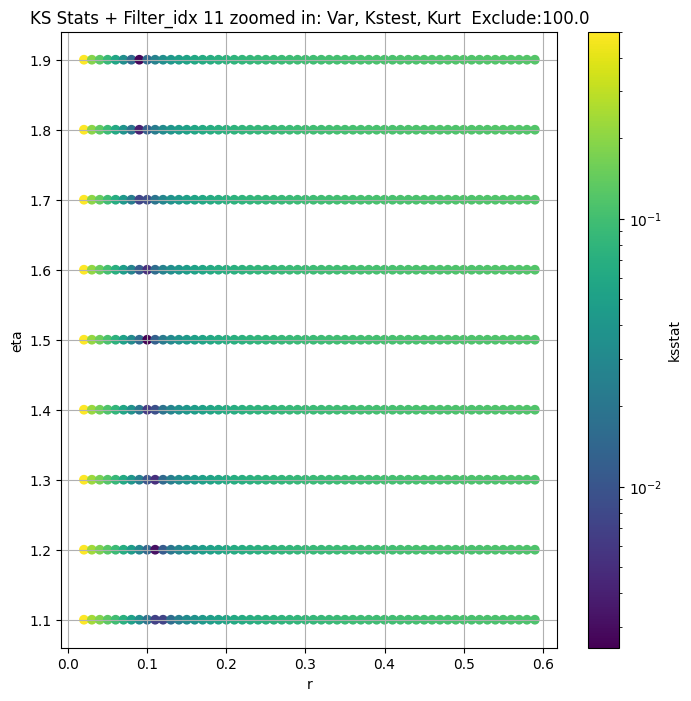

Filter_idx 12


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 100 = 300, ksstat: 0.0065271812096890924, var: 14.594236103330438


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 75 = 275, ksstat: 0.006202075759601855, var: 14.916216632921156


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 50 = 250, ksstat: 0.005845412854504239, var: 15.265587373392602


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 25 = 225, ksstat: 0.006384860609631227, var: 15.648022893986969


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + 0 = 200, ksstat: 0.006835949129778696, var: 16.071298067109094


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -25 = 175, ksstat: 0.006934142718467706, var: 16.54667045487136


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -50 = 150, ksstat: 0.0072168590619670625, var: 17.091537337945542


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -75 = 125, ksstat: 0.007993250810766184, var: 17.733986832705778


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 12, 200.0 + -100 = 100, ksstat: 0.008682209617398629, var: 18.525486125654783
Number of samples: 100000, Without approximation : 786432000.0


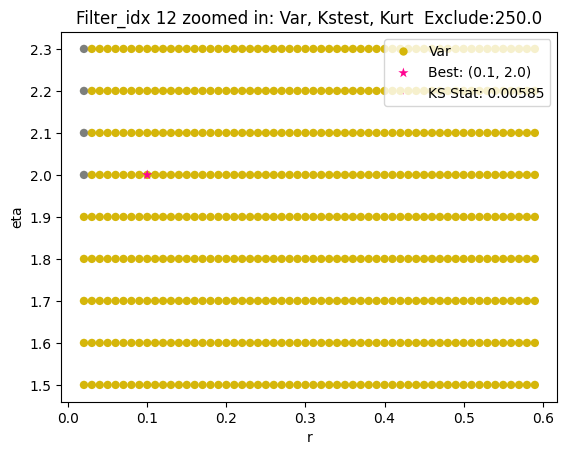

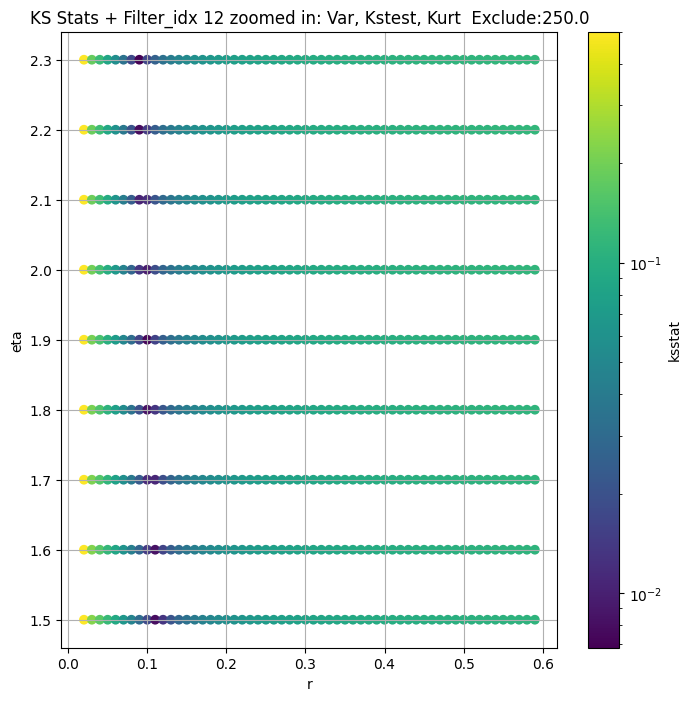

Filter_idx 13


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + 100 = 300, ksstat: 0.0050087212188304475, var: 20.3061432609422


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + 75 = 275, ksstat: 0.004615447997763589, var: 20.814364325690438


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + 50 = 250, ksstat: 0.004220897781845423, var: 21.376074443364956


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + 25 = 225, ksstat: 0.003954019785827434, var: 22.003382338040712


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + 0 = 200, ksstat: 0.004544245152459436, var: 22.712321323833752


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + -25 = 175, ksstat: 0.00506554665151232, var: 23.525535311901248


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + -50 = 150, ksstat: 0.005543959244337038, var: 24.476046204167215


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + -75 = 125, ksstat: 0.006545572595141991, var: 25.61349385097282


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 13, 200.0 + -100 = 100, ksstat: 0.007044677417298972, var: 27.01697157637875
Number of samples: 100000, Without approximation : 786432000.0


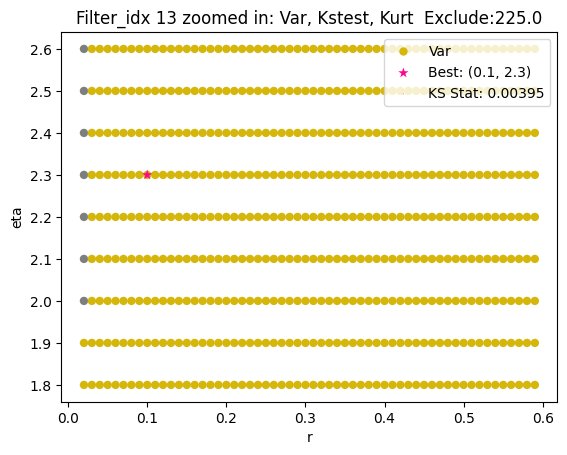

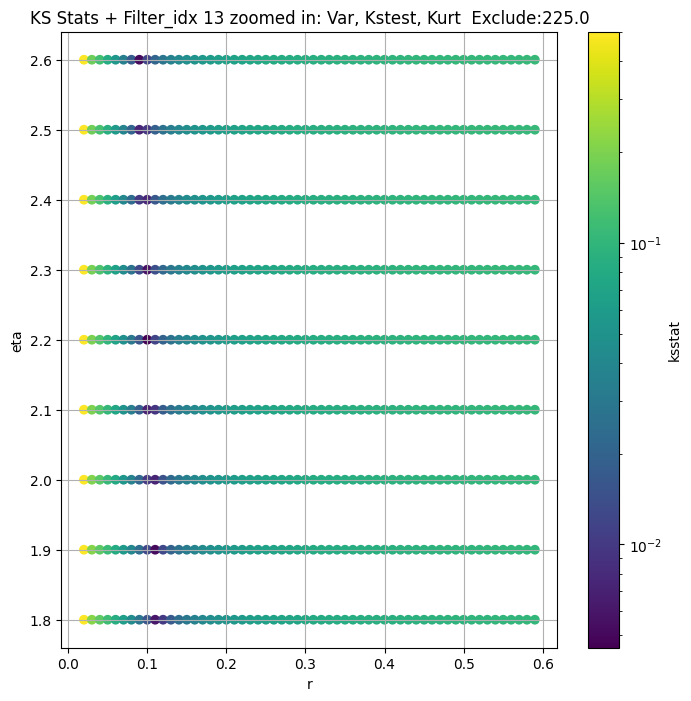

Filter_idx 14


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 14, 200.0 + 100 = 300, ksstat: 0.006274946631104974, var: 24.097313520909612


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 14, 200.0 + 75 = 275, ksstat: 0.005857500229501201, var: 24.631305025859792


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 14, 200.0 + 50 = 250, ksstat: 0.0054982712549718794, var: 25.213503508294625


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 14, 200.0 + 25 = 225, ksstat: 0.0050410996901273375, var: 25.854135635814362


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 14, 200.0 + 0 = 200, ksstat: 0.005065728222271582, var: 26.56730491237001


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 14, 200.0 + -25 = 175, ksstat: 0.005004672824753864, var: 27.372783122553756


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 14, 200.0 + -50 = 150, ksstat: 0.005009960687679893, var: 28.29983811329385


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 14, 200.0 + -75 = 125, ksstat: 0.004895494310488746, var: 29.393389557244802


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 14, 200.0 + -100 = 100, ksstat: 0.004935786289411104, var: 30.72851488208976
Number of samples: 100000, Without approximation : 786432000.0


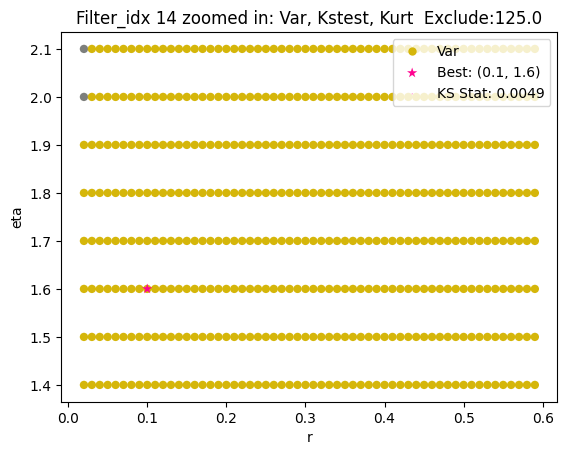

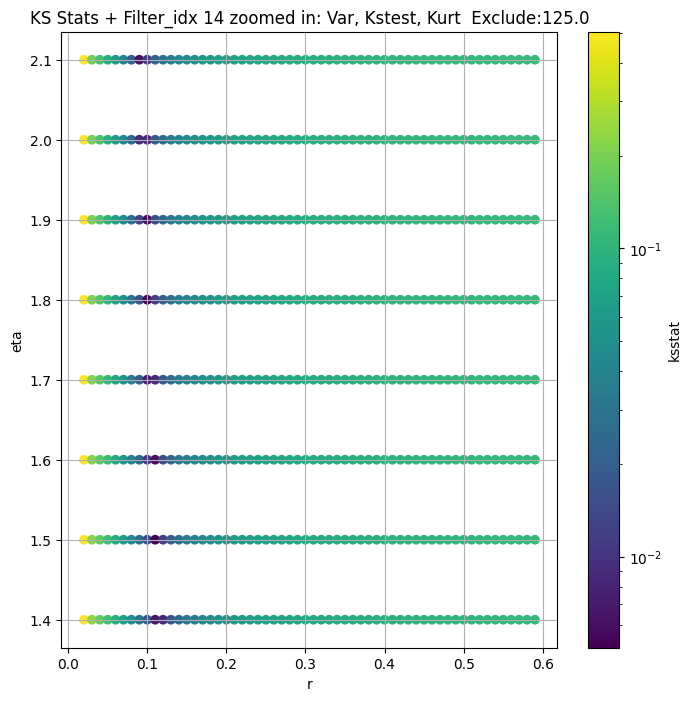

Filter_idx 15


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 100 = 300, ksstat: 0.005395640426959836, var: 23.878704633076488


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 75 = 275, ksstat: 0.005743202034591027, var: 24.29575160934617


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 50 = 250, ksstat: 0.006255830605455925, var: 24.767642325968012


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 25 = 225, ksstat: 0.006569316971821421, var: 25.308636428317396


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + 0 = 200, ksstat: 0.007132925082302011, var: 25.94207737900375


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -25 = 175, ksstat: 0.007954114798351397, var: 26.69897640218874


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -50 = 150, ksstat: 0.008710272797254004, var: 27.621531941230785


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -75 = 125, ksstat: 0.009748149026663072, var: 28.775579983612747


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 15, 200.0 + -100 = 100, ksstat: 0.011224340363186647, var: 30.263913821786485
Number of samples: 100000, Without approximation : 786432000.0


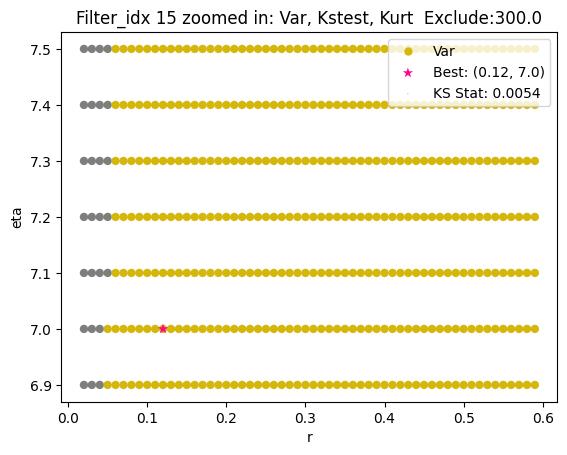

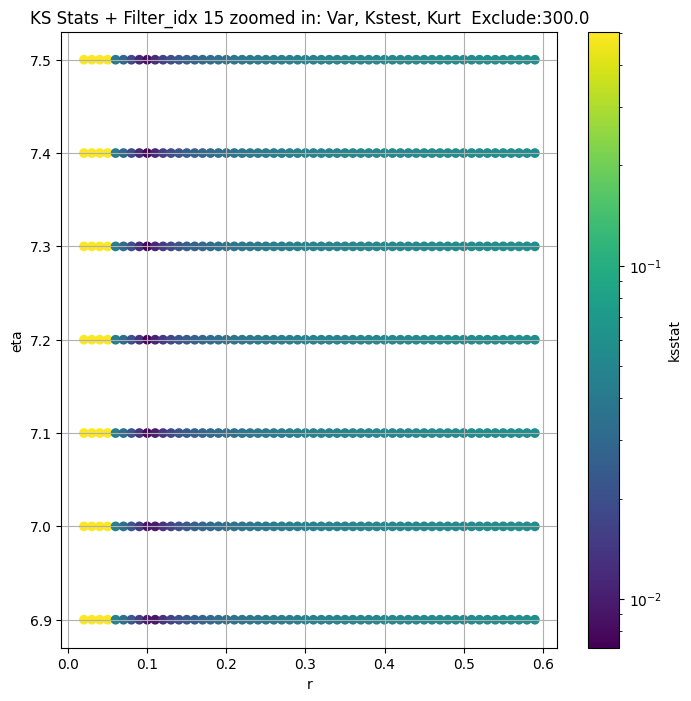

Filter_idx 16


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 100 = 300, ksstat: 0.0063029249435453336, var: 12.805592690742536


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 75 = 275, ksstat: 0.006216412636182167, var: 13.106365882904011


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 50 = 250, ksstat: 0.005777145449992749, var: 13.433090788644916


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 25 = 225, ksstat: 0.006143184841271354, var: 13.790911143323676


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + 0 = 200, ksstat: 0.007325690349450742, var: 14.18695963017607


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -25 = 175, ksstat: 0.007321558966168595, var: 14.631206797200907


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -50 = 150, ksstat: 0.007854302727740625, var: 15.138300542105778


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -75 = 125, ksstat: 0.0083266046303207, var: 15.731260909956266


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 16, 200.0 + -100 = 100, ksstat: 0.0091184356227631, var: 16.449059863658203
Number of samples: 100000, Without approximation : 786432000.0


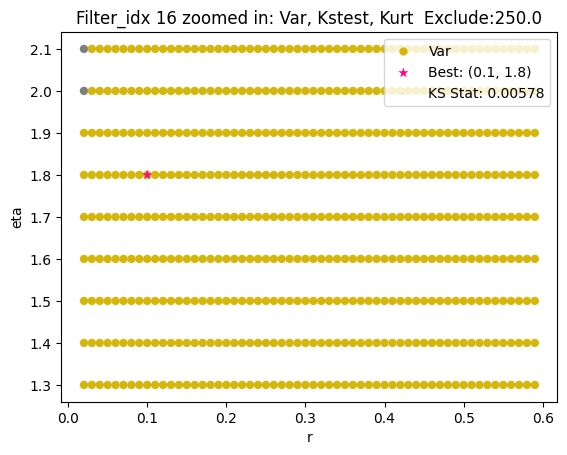

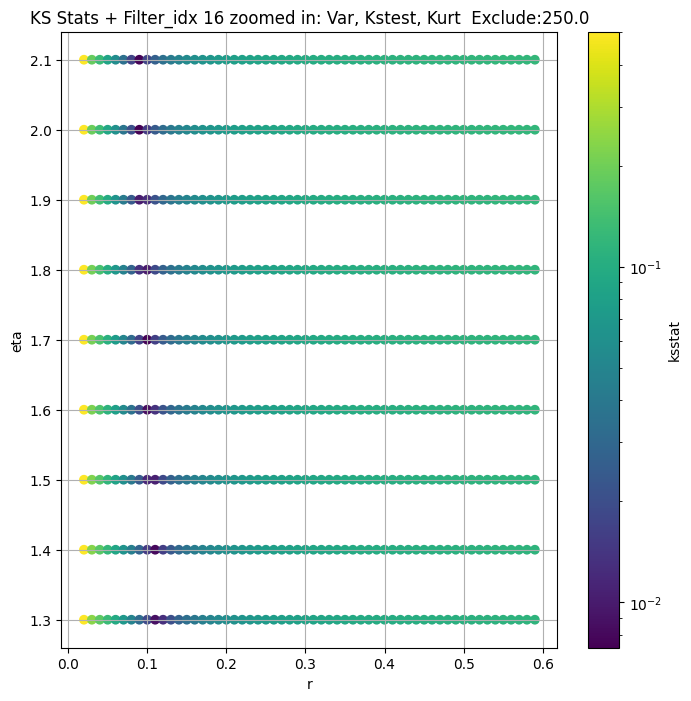

Filter_idx 17


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 17, 50.0 + 100 = 150, ksstat: 0.006287858876960373, var: 14.139373124328067


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 17, 50.0 + 75 = 125, ksstat: 0.006070665660997454, var: 14.711398895333028


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 17, 50.0 + 50 = 100, ksstat: 0.005872872491199221, var: 15.446796711073453


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 17, 50.0 + 25 = 75, ksstat: 0.005271107412034182, var: 16.472031531827742


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 17, 50.0 + 0 = 50, ksstat: 0.0053903009940696744, var: 18.082917919695774


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 17, 50.0 + -25 = 25, ksstat: 0.004977716700023116, var: 21.171870786824925


  0%|          | 0/1188 [00:00<?, ?it/s]

Finding Minimum after computing 1188 CDFs
filter_idx 17, 50.0 + -50 = 0, ksstat: 0.017498854189592516, var: 51.375847680329656
Number of samples: 100000, Without approximation : 786432000.0


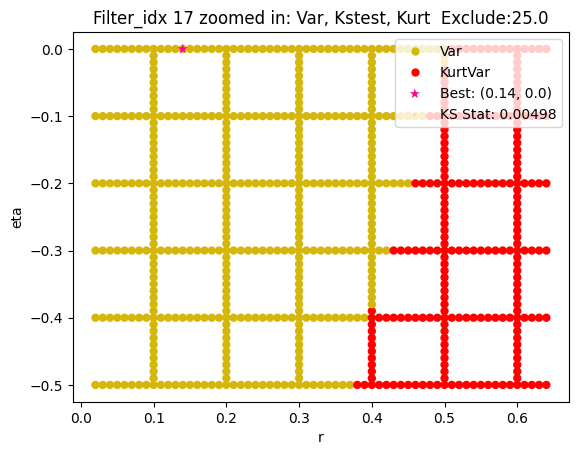

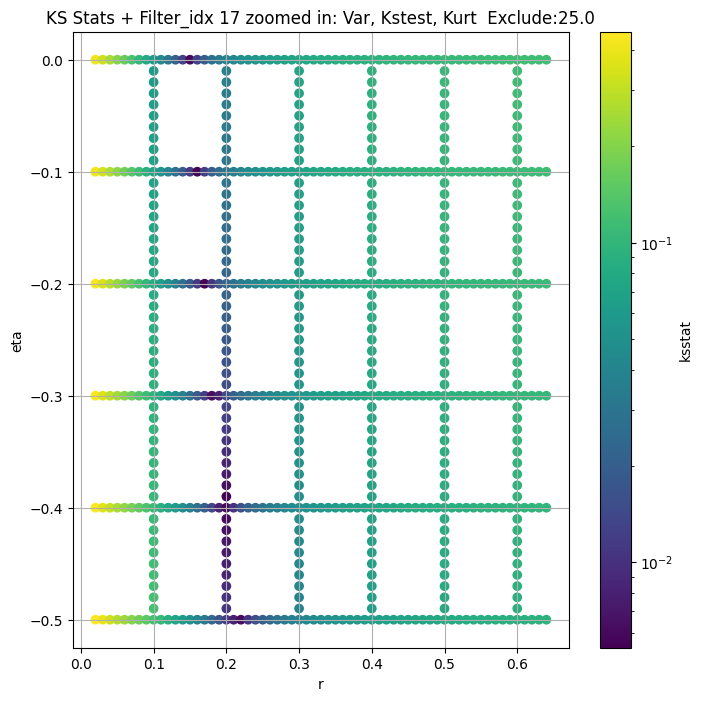

Filter_idx 18


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + 100 = 300, ksstat: 0.008411052925226425, var: 10.470162533015937


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + 75 = 275, ksstat: 0.00788173943349868, var: 10.712052668275657


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + 50 = 250, ksstat: 0.008795247296856656, var: 10.973588796306622


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + 25 = 225, ksstat: 0.00882213326603909, var: 11.258638028334696


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + 0 = 200, ksstat: 0.008991840149184638, var: 11.57250352262966


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + -25 = 175, ksstat: 0.0095737097585335, var: 11.922545600543845


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + -50 = 150, ksstat: 0.01034259256869885, var: 12.319948620867391


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + -75 = 125, ksstat: 0.01086215357403475, var: 12.78289731953945


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 18, 200.0 + -100 = 100, ksstat: 0.011122639358330022, var: 13.343051273826125
Number of samples: 100000, Without approximation : 786432000.0


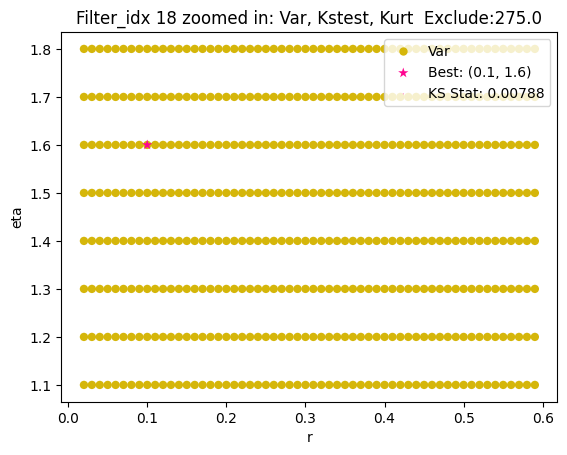

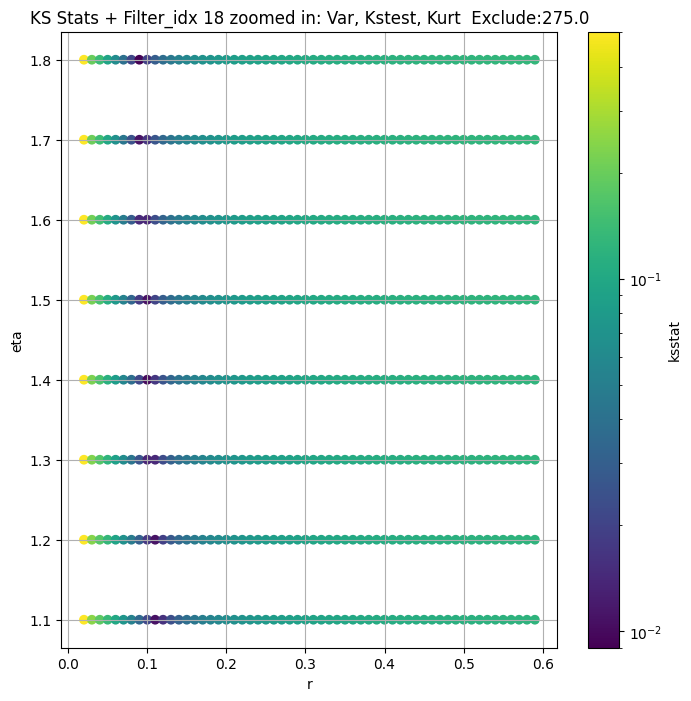

Filter_idx 19


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + 100 = 300, ksstat: 0.0168344947970821, var: 44.822012644488076


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + 75 = 275, ksstat: 0.01663027745041462, var: 45.66525153798855


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + 50 = 250, ksstat: 0.016326972821118058, var: 46.598364942768946


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + 25 = 225, ksstat: 0.01643254719820675, var: 47.64862998411866


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + 0 = 200, ksstat: 0.016223785561111925, var: 48.84674882998806


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + -25 = 175, ksstat: 0.016403387715983098, var: 50.26699066271638


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + -50 = 150, ksstat: 0.016111842266838705, var: 51.99199918241092


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + -75 = 125, ksstat: 0.01611545965552097, var: 54.149398749164845


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 19, 200.0 + -100 = 100, ksstat: 0.01634925459761477, var: 56.95761295843295
Number of samples: 100000, Without approximation : 786432000.0


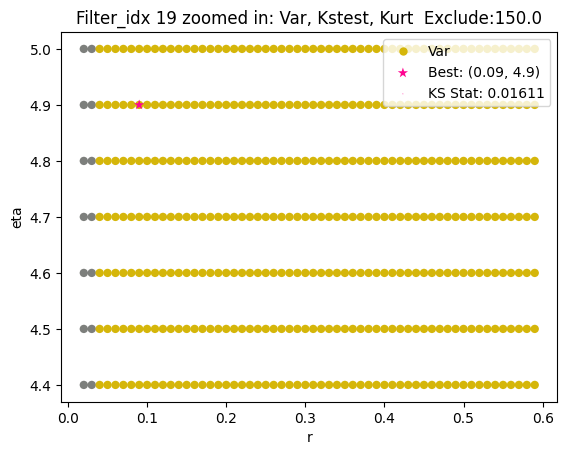

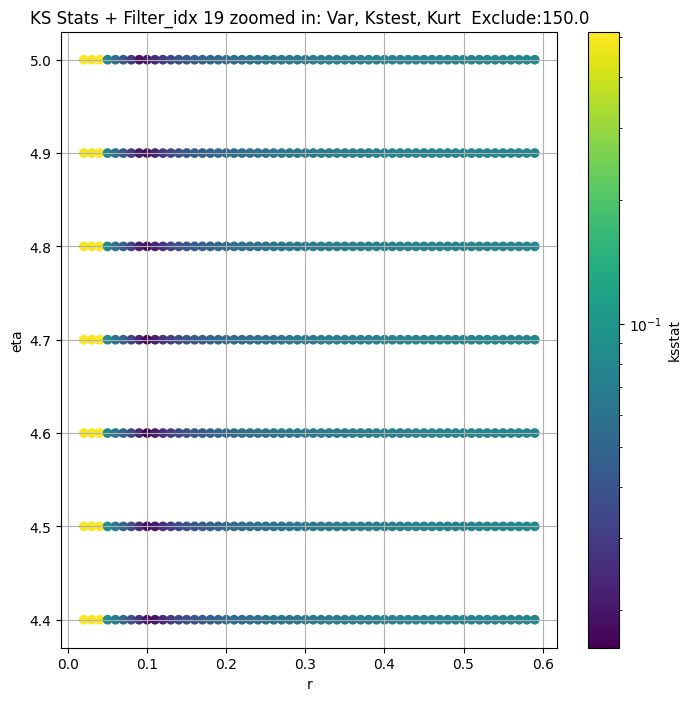

Filter_idx 20


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 20, 200.0 + 100 = 300, ksstat: 0.004514691501190096, var: 67.47220936720859


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 20, 200.0 + 75 = 275, ksstat: 0.004195341297939371, var: 68.8964595814116


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 20, 200.0 + 50 = 250, ksstat: 0.0038751485030047057, var: 70.4665849441147


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 20, 200.0 + 25 = 225, ksstat: 0.0035562051285481025, var: 72.21778678834305


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 20, 200.0 + 0 = 200, ksstat: 0.0032035511854187383, var: 74.1993536128733


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 20, 200.0 + -25 = 175, ksstat: 0.0037940825186203453, var: 76.48472711563603


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 20, 200.0 + -50 = 150, ksstat: 0.003986442885191732, var: 79.18493165657685


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 20, 200.0 + -75 = 125, ksstat: 0.005029983072528818, var: 82.47805198536223


  0%|          | 0/621 [00:00<?, ?it/s]

Finding Minimum after computing 621 CDFs
filter_idx 20, 200.0 + -100 = 100, ksstat: 0.006528654365301256, var: 86.66838985986297
Number of samples: 100000, Without approximation : 786432000.0


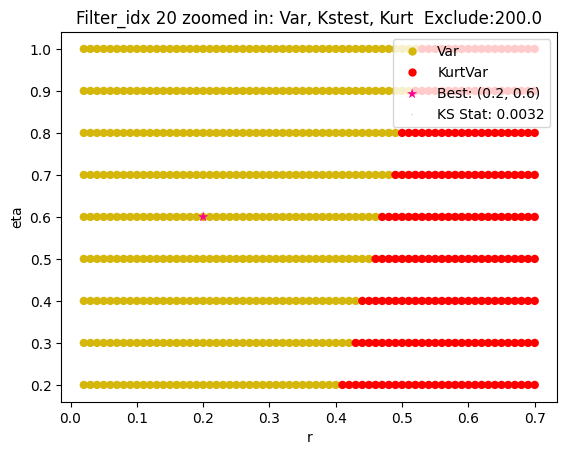

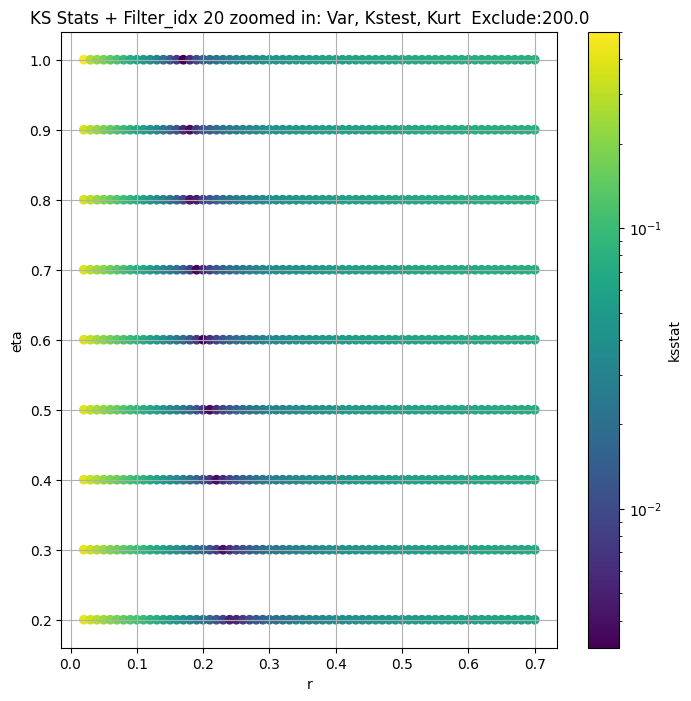

Filter_idx 21


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 200.0 + 100 = 300, ksstat: 0.030662036772224344, var: 130.97010505175575


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 200.0 + 75 = 275, ksstat: 0.030659922232902592, var: 133.53026863683763


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 200.0 + 50 = 250, ksstat: 0.03065874012605463, var: 136.39926568407148


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 200.0 + 25 = 225, ksstat: 0.030662082879555963, var: 139.62893307138106


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 200.0 + 0 = 200, ksstat: 0.030658741147748414, var: 143.36982461875687


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 200.0 + -25 = 175, ksstat: 0.030660105800071946, var: 147.79025525909432


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 200.0 + -50 = 150, ksstat: 0.03065888227231367, var: 153.11633037353178


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 200.0 + -75 = 125, ksstat: 0.03065931149000889, var: 159.65327943278953


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 21, 200.0 + -100 = 100, ksstat: 0.03065860530534803, var: 167.85740946455658
Number of samples: 100000, Without approximation : 786432000.0


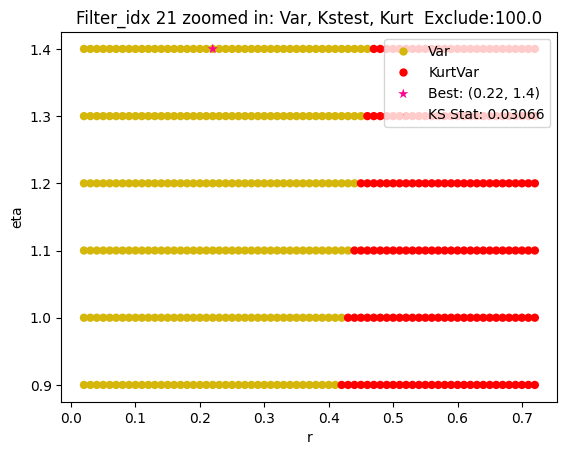

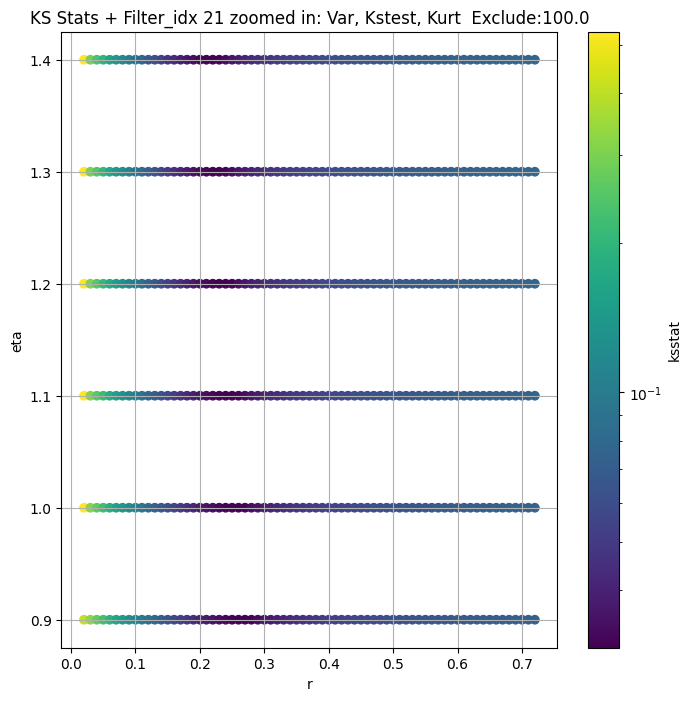

Filter_idx 22


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + 100 = 300, ksstat: 0.004810189323504242, var: 16.969134694959717


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + 75 = 275, ksstat: 0.004422337327581698, var: 17.48054340769487


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + 50 = 250, ksstat: 0.005128515069781958, var: 18.052500297512687


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + 25 = 225, ksstat: 0.0057197401968997474, var: 18.700047855057267


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + 0 = 200, ksstat: 0.00639122189048974, var: 19.444271592239705


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + -25 = 175, ksstat: 0.006958118620774223, var: 20.315468447449433


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + -50 = 150, ksstat: 0.0073704375391778765, var: 21.357077722166782


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + -75 = 125, ksstat: 0.008046707226634087, var: 22.6328104734916


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 22, 200.0 + -100 = 100, ksstat: 0.010306207138378043, var: 24.238805616154625
Number of samples: 100000, Without approximation : 786432000.0


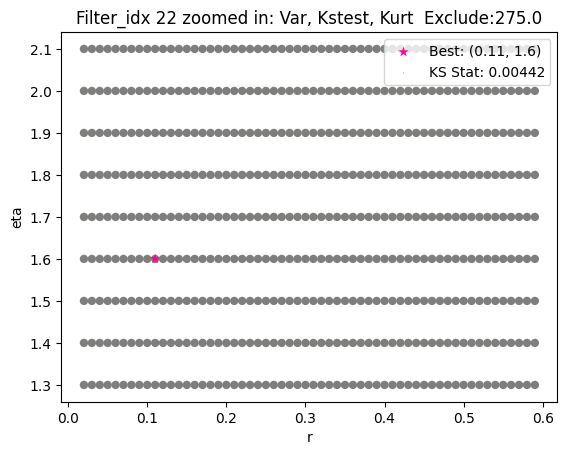

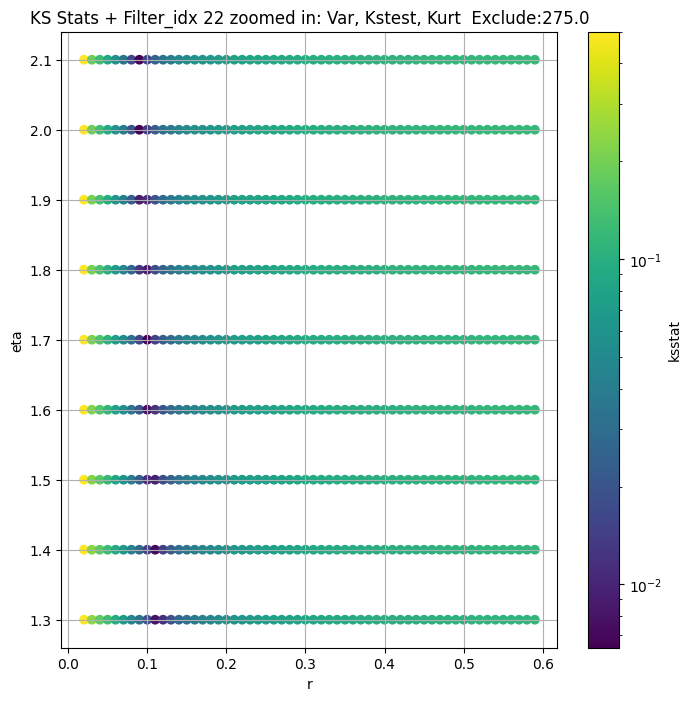

Filter_idx 23


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 100.0 + 100 = 200, ksstat: 0.005320774497645009, var: 29.996217025276714


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 100.0 + 75 = 175, ksstat: 0.004736600174230499, var: 30.980427050986847


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 100.0 + 50 = 150, ksstat: 0.00447925389625492, var: 32.16501479428114


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 100.0 + 25 = 125, ksstat: 0.004526380770334348, var: 33.6710219081954


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 100.0 + 0 = 100, ksstat: 0.005293092879111505, var: 35.74420196668687


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 100.0 + -25 = 75, ksstat: 0.006750514654869533, var: 38.92871435583646


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 100.0 + -50 = 50, ksstat: 0.00832873962759667, var: 44.39115100471943


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 100.0 + -75 = 25, ksstat: 0.010476325065711778, var: 55.20484793027165


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 23, 100.0 + -100 = 0, ksstat: 0.022679011471790578, var: 117.53452822376494
Number of samples: 100000, Without approximation : 786432000.0


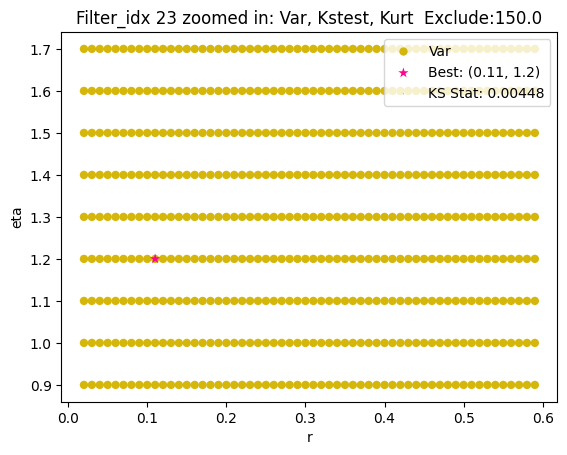

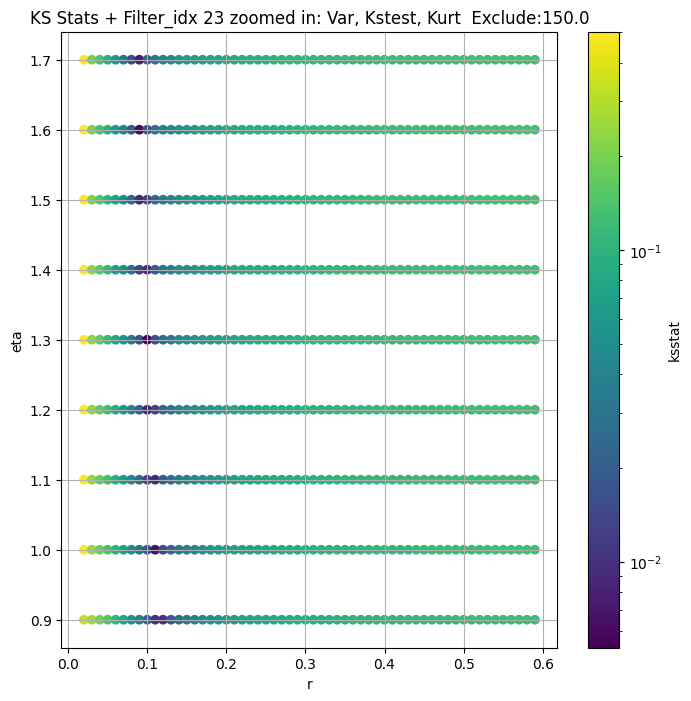

Filter_idx 24


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 100 = 300, ksstat: 0.010217865985687108, var: 18.131665389037636


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 75 = 275, ksstat: 0.01111172651920711, var: 18.646243254852802


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 50 = 250, ksstat: 0.009969880310329082, var: 19.220731021093464


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 25 = 225, ksstat: 0.011468440543336844, var: 19.871756079540578


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + 0 = 200, ksstat: 0.011237020073678522, var: 20.62244499549186


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -25 = 175, ksstat: 0.012230225112237259, var: 21.507837751458215


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -50 = 150, ksstat: 0.013907876852817747, var: 22.580390877728217


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -75 = 125, ksstat: 0.01309716281213491, var: 23.922493618974887


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 24, 200.0 + -100 = 100, ksstat: 0.01389675625122, var: 25.66307074574034
Number of samples: 100000, Without approximation : 786432000.0


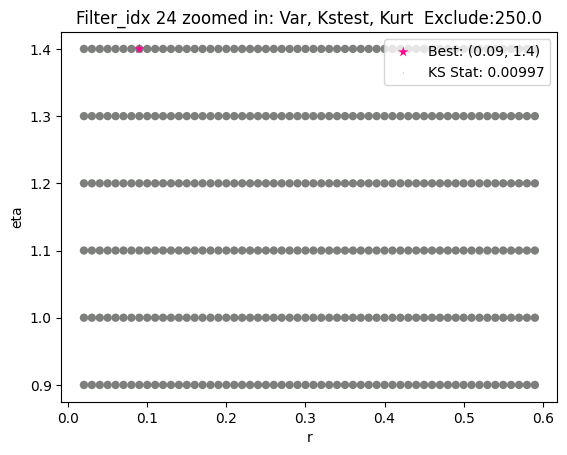

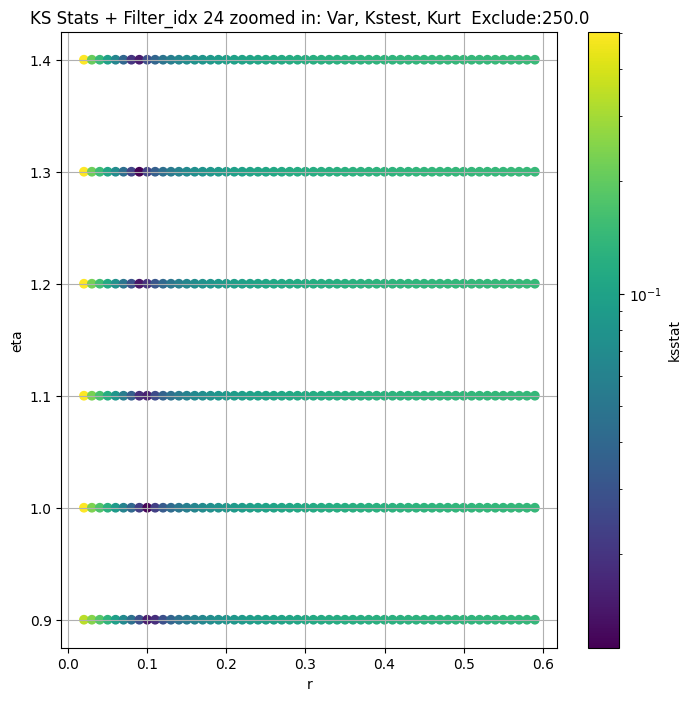

Filter_idx 25


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 100 = 300, ksstat: 0.006675635398754487, var: 5.516677386101535


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 75 = 275, ksstat: 0.00650097174833264, var: 5.70025611112514


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 50 = 250, ksstat: 0.007894085911225812, var: 5.9050216070464066


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 25 = 225, ksstat: 0.007559519832244788, var: 6.135448437115443


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + 0 = 200, ksstat: 0.008359308568289425, var: 6.397225975967124


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -25 = 175, ksstat: 0.009476902688666633, var: 6.698018987633436


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -50 = 150, ksstat: 0.010433516423174916, var: 7.048524583570971


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -75 = 125, ksstat: 0.010550620280992407, var: 7.464070927914397


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 25, 200.0 + -100 = 100, ksstat: 0.012278178944948981, var: 7.968234403626827
Number of samples: 100000, Without approximation : 786432000.0


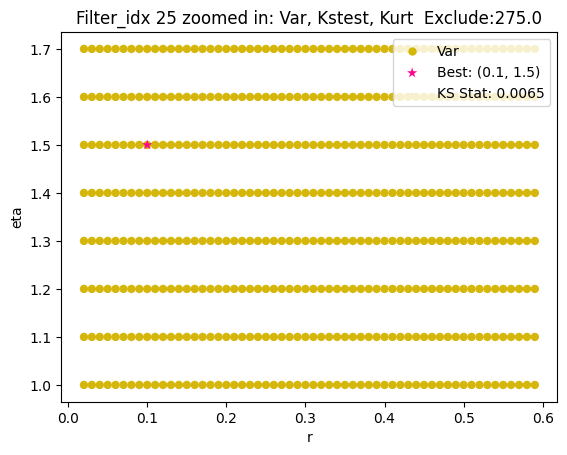

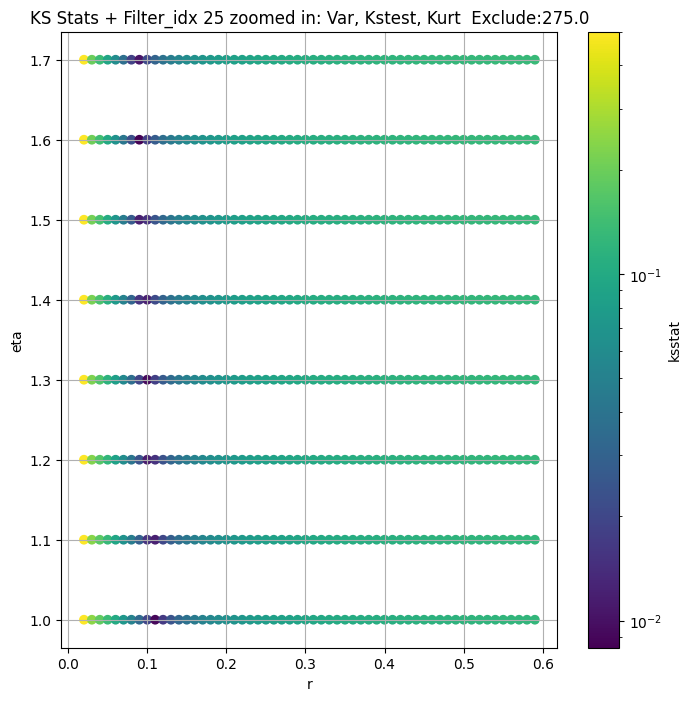

Filter_idx 26


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + 100 = 300, ksstat: 0.0067875522645871045, var: 14.64054656626451


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + 75 = 275, ksstat: 0.006748405320421869, var: 14.924878407865641


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + 50 = 250, ksstat: 0.00672783846643954, var: 15.236326134326154


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + 25 = 225, ksstat: 0.006791090003291478, var: 15.581253667000237


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + 0 = 200, ksstat: 0.006745698295894886, var: 15.968500444760334


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + -25 = 175, ksstat: 0.006752770372879746, var: 16.41089060232043


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + -50 = 150, ksstat: 0.006788734586664513, var: 16.929056995174967


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + -75 = 125, ksstat: 0.006767592086602547, var: 17.557196738591283


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 26, 200.0 + -100 = 100, ksstat: 0.00674172499089809, var: 18.359772493288403
Number of samples: 100000, Without approximation : 786432000.0


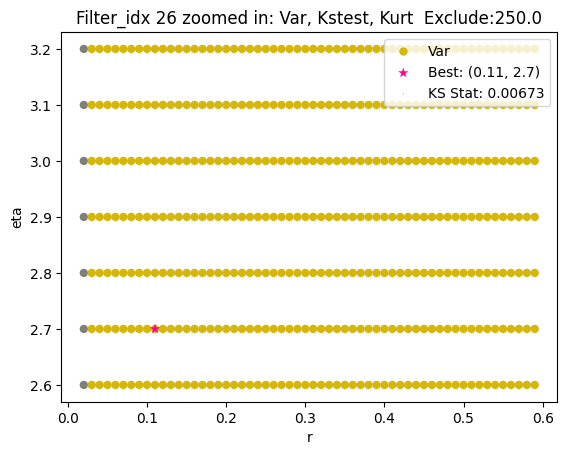

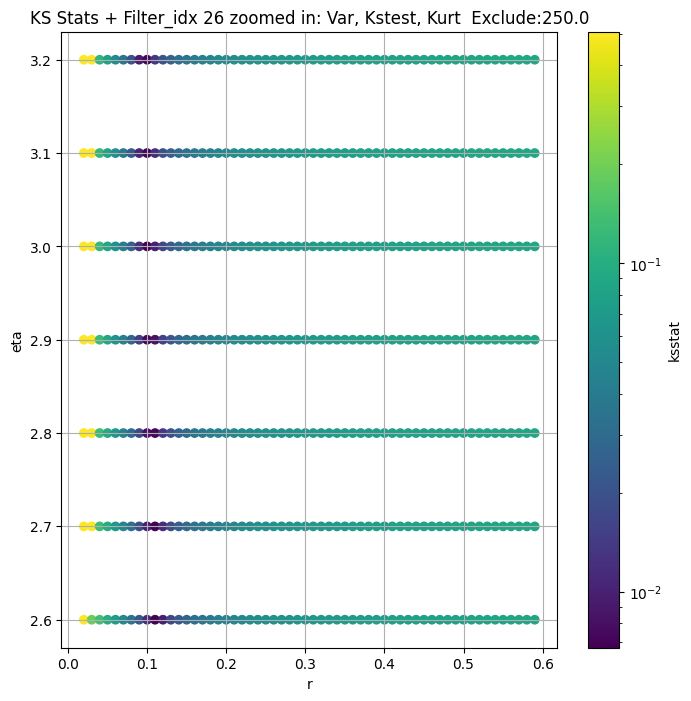

Filter_idx 27


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + 100 = 300, ksstat: 0.012284562348299222, var: 4.606484082515083


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + 75 = 275, ksstat: 0.01196688125331527, var: 4.730299725242226


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + 50 = 250, ksstat: 0.013823444246607697, var: 4.865243082896891


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + 25 = 225, ksstat: 0.012966827411027726, var: 5.013747223974461


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + 0 = 200, ksstat: 0.012970458444610922, var: 5.179114556912315


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + -25 = 175, ksstat: 0.014809289167595774, var: 5.366101306589433


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + -50 = 150, ksstat: 0.01393112517183498, var: 5.581933255826612


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + -75 = 125, ksstat: 0.014516308426833102, var: 5.838134036647657


  0%|          | 0/567 [00:00<?, ?it/s]

Finding Minimum after computing 567 CDFs
filter_idx 27, 200.0 + -100 = 100, ksstat: 0.015439460503863356, var: 6.15501654494234
Number of samples: 100000, Without approximation : 786432000.0


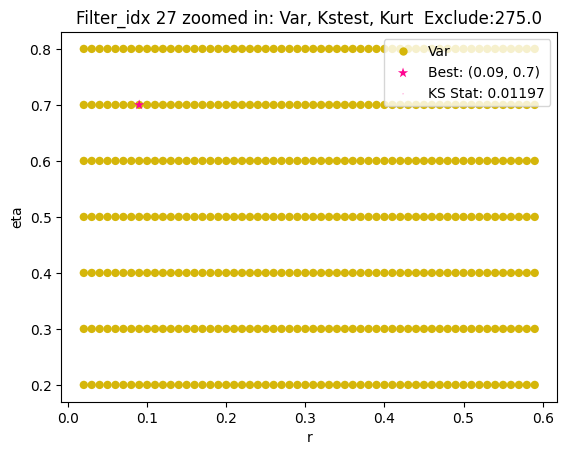

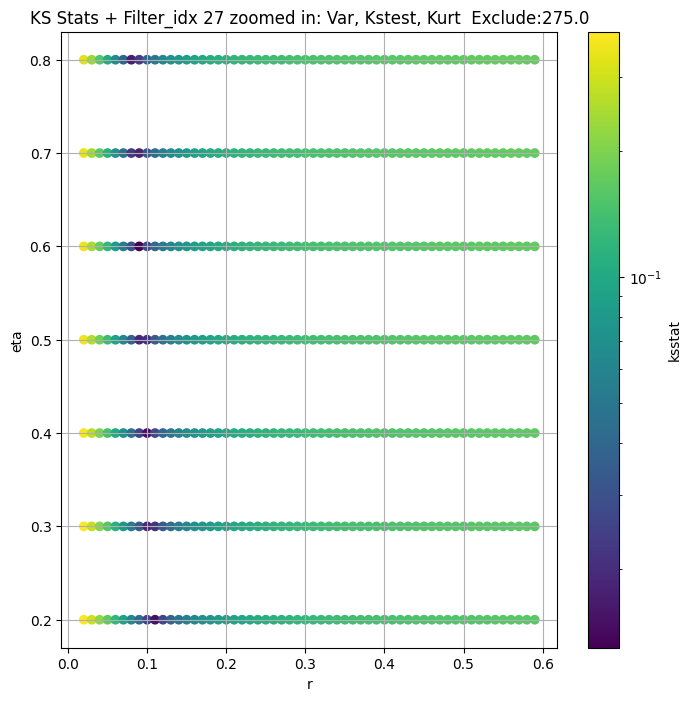

Filter_idx 28


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 28, 200.0 + 100 = 300, ksstat: 0.010481425046488635, var: 22.870259678996135


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 28, 200.0 + 75 = 275, ksstat: 0.009444355183874209, var: 23.539761337824736


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 28, 200.0 + 50 = 250, ksstat: 0.01077401604438502, var: 24.289740958382446


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 28, 200.0 + 25 = 225, ksstat: 0.01035638525744903, var: 25.142735671162818


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 28, 200.0 + 0 = 200, ksstat: 0.011572493878530321, var: 26.13089588747634


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 28, 200.0 + -25 = 175, ksstat: 0.012378786679462267, var: 27.301369386967632


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 28, 200.0 + -50 = 150, ksstat: 0.011995413364456753, var: 28.7259131542145


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 28, 200.0 + -75 = 125, ksstat: 0.01341210422390815, var: 30.517564585988925


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 28, 200.0 + -100 = 100, ksstat: 0.014701762437626664, var: 32.85758265038139
Number of samples: 100000, Without approximation : 786432000.0


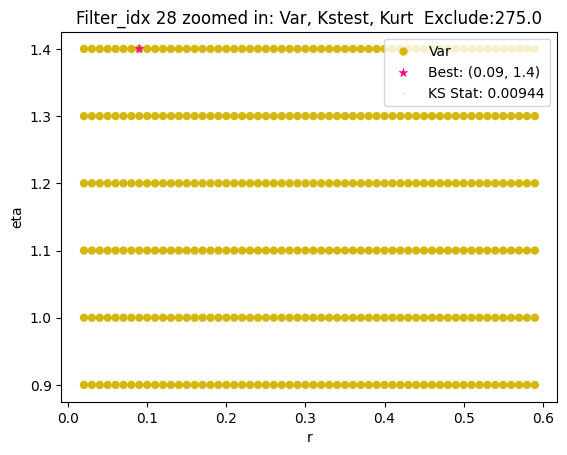

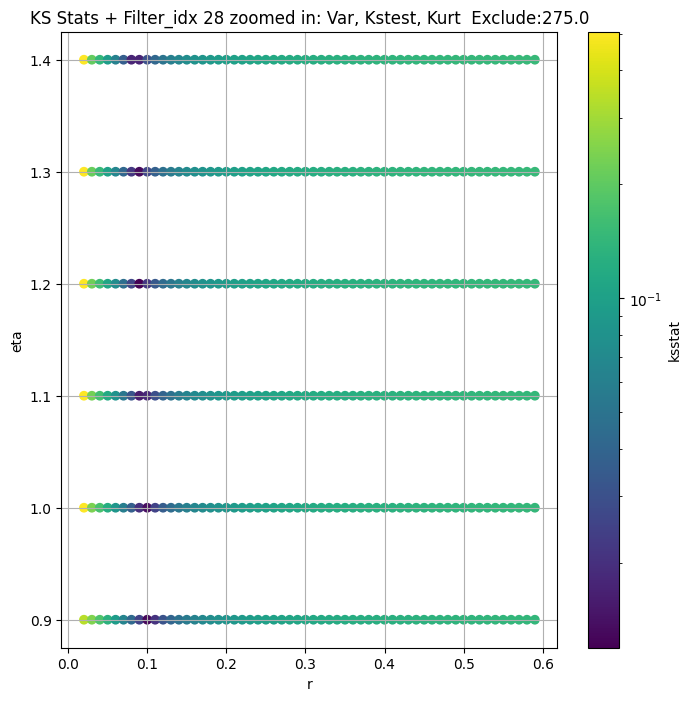

Filter_idx 29


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 100 = 300, ksstat: 0.009584698766718969, var: 18.530580916509834


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 75 = 275, ksstat: 0.008605223937474801, var: 18.991084785157284


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 50 = 250, ksstat: 0.008062953217409324, var: 19.494729241647725


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 25 = 225, ksstat: 0.007994544964546824, var: 20.051053251334483


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + 0 = 200, ksstat: 0.008305172131329419, var: 20.673992702744265


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -25 = 175, ksstat: 0.008139261149927579, var: 21.383986119063756


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -50 = 150, ksstat: 0.008756107051233641, var: 22.21374538794066


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -75 = 125, ksstat: 0.008306673543676535, var: 23.22051036373712


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 29, 200.0 + -100 = 100, ksstat: 0.008891560711188129, var: 24.51001374711341
Number of samples: 100000, Without approximation : 786432000.0


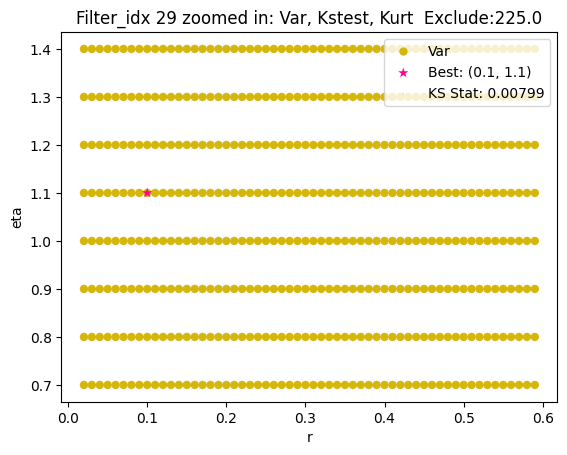

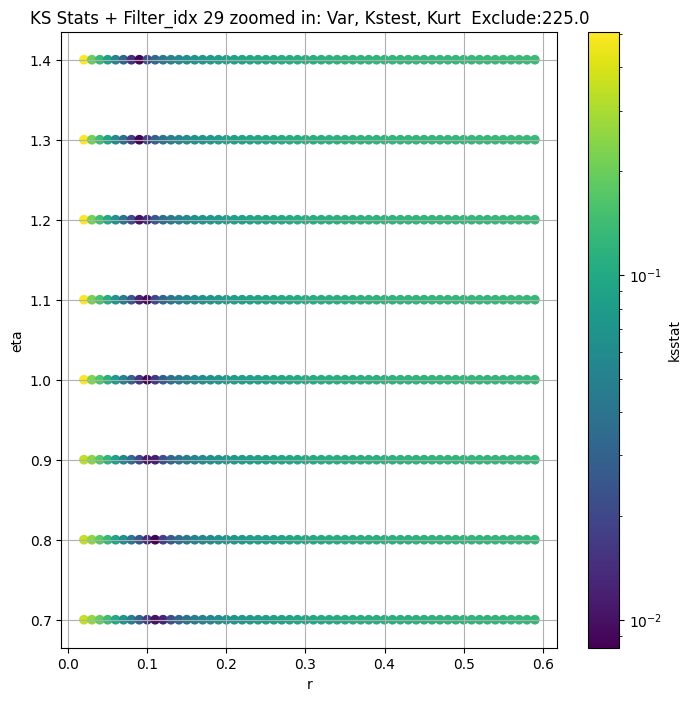

Filter_idx 30


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 200.0 + 100 = 300, ksstat: 0.008094206855152157, var: 16.01584684438292


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 200.0 + 75 = 275, ksstat: 0.008002831577900715, var: 16.47543055501054


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 200.0 + 50 = 250, ksstat: 0.007916961632777109, var: 16.98348406934967


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 200.0 + 25 = 225, ksstat: 0.007983096159792369, var: 17.551870066391874


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 200.0 + 0 = 200, ksstat: 0.009067719806384766, var: 18.19748793398733


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 200.0 + -25 = 175, ksstat: 0.009018276809347747, var: 18.94561113256768


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 200.0 + -50 = 150, ksstat: 0.009893849424467194, var: 19.83519612269899


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 200.0 + -75 = 125, ksstat: 0.00960955043411238, var: 20.932004037371293


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 30, 200.0 + -100 = 100, ksstat: 0.00991506119572938, var: 22.352798073379642
Number of samples: 100000, Without approximation : 786432000.0


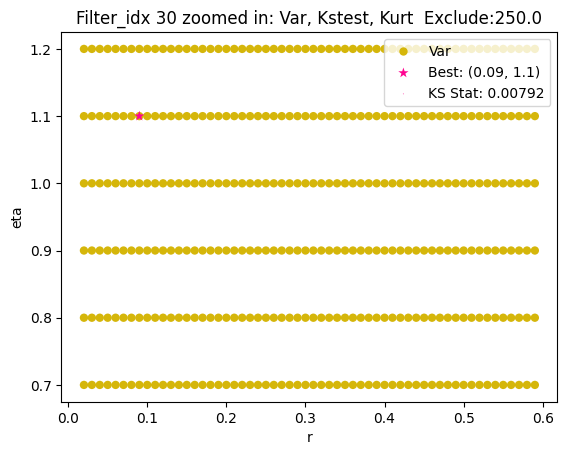

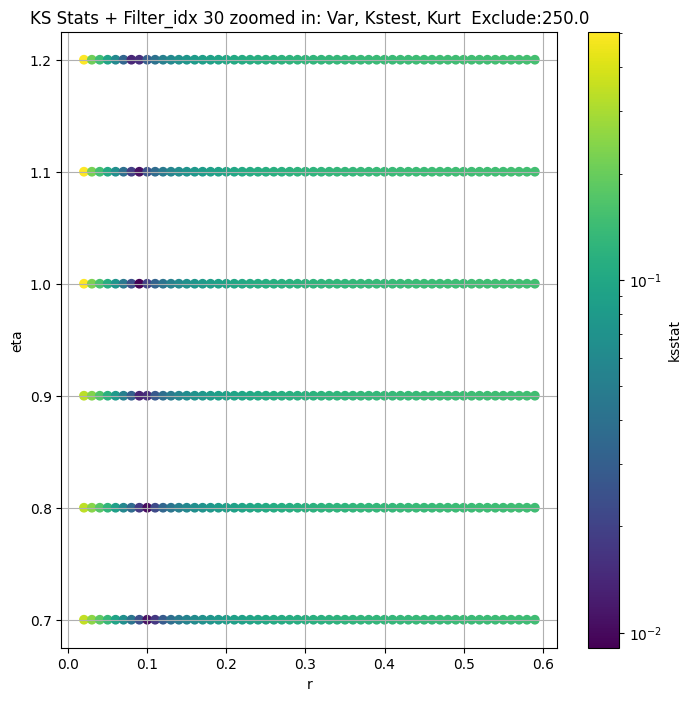

Filter_idx 31


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 200.0 + 100 = 300, ksstat: 0.018277879452802015, var: 24.99776641200749


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 200.0 + 75 = 275, ksstat: 0.018279705832436766, var: 25.486343507578717


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 200.0 + 50 = 250, ksstat: 0.01829080935265831, var: 26.021847750969616


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 200.0 + 25 = 225, ksstat: 0.018277899562884115, var: 26.61655612765737


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 200.0 + 0 = 200, ksstat: 0.018278220510467347, var: 27.28798144842038


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 200.0 + -25 = 175, ksstat: 0.018301766906677897, var: 28.06405848871355


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 200.0 + -50 = 150, ksstat: 0.018307459923817104, var: 28.98945240863488


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 200.0 + -75 = 125, ksstat: 0.018290149178614823, var: 30.141431965515615


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 31, 200.0 + -100 = 100, ksstat: 0.018279791375882648, var: 31.666257381355123
Number of samples: 100000, Without approximation : 786432000.0


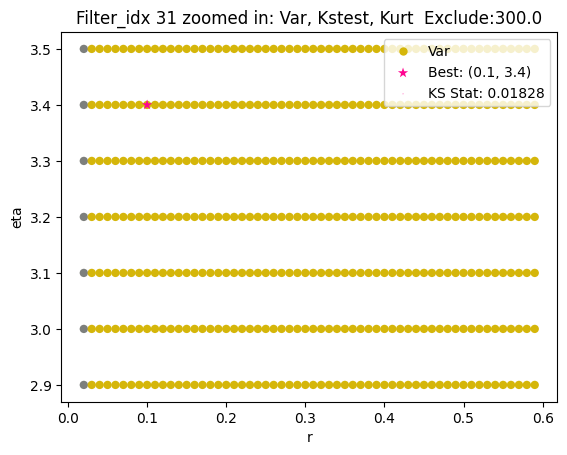

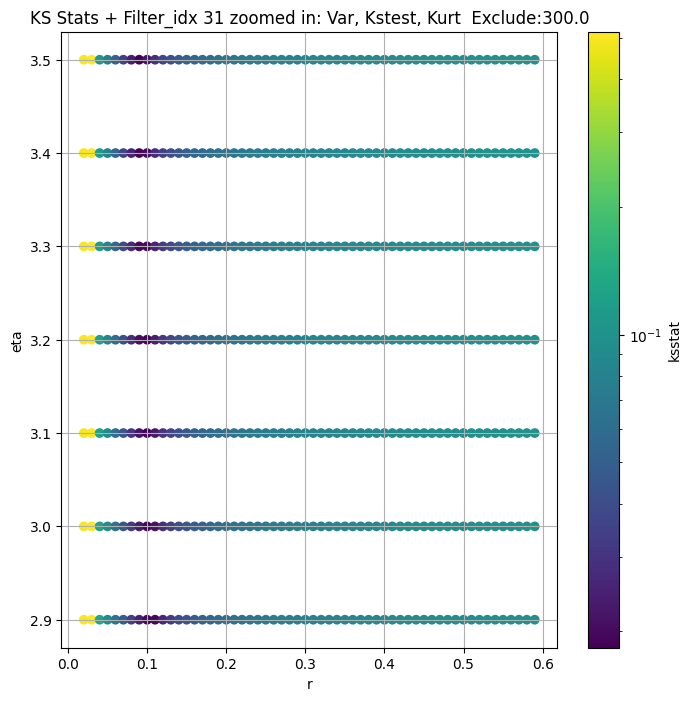

Filter_idx 32


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + 100 = 300, ksstat: 0.007508202913901932, var: 25.054353090947703


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + 75 = 275, ksstat: 0.006753126939228769, var: 25.599360409123836


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + 50 = 250, ksstat: 0.006407682210136545, var: 26.197868027191817


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + 25 = 225, ksstat: 0.005864257012611576, var: 26.863203073289387


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + 0 = 200, ksstat: 0.005111190892444439, var: 27.615445139508022


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + -25 = 175, ksstat: 0.004341654601381036, var: 28.486819394343307


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + -50 = 150, ksstat: 0.004472253037410279, var: 29.531272768353208


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + -75 = 125, ksstat: 0.004937764658219712, var: 30.84530062043588


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 32, 200.0 + -100 = 100, ksstat: 0.005055608976874404, var: 32.61604738549685
Number of samples: 100000, Without approximation : 786432000.0


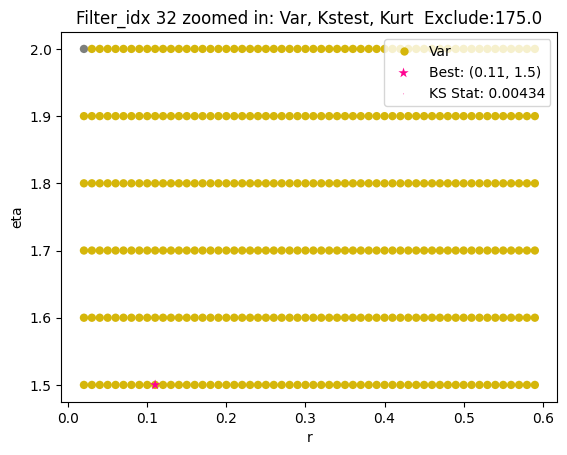

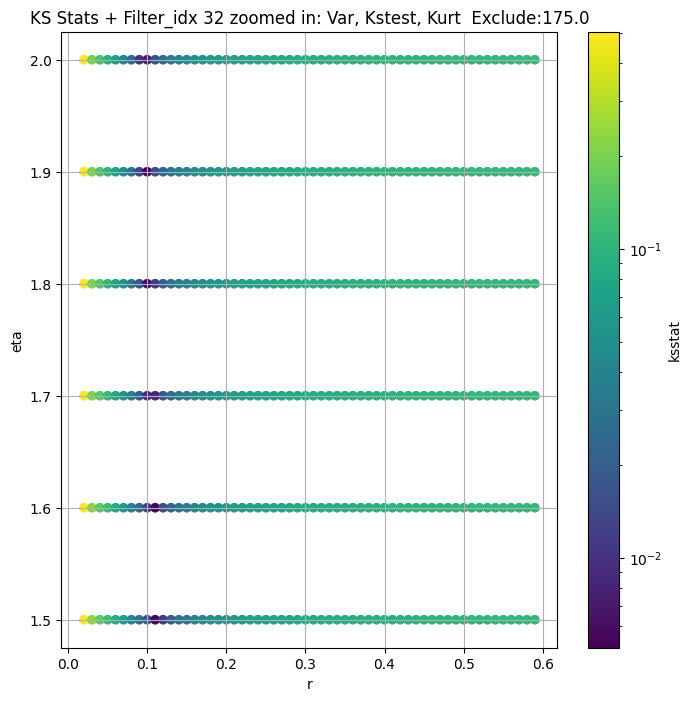

Filter_idx 33


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 100 = 300, ksstat: 0.008713740145576132, var: 6.26730875307373


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 75 = 275, ksstat: 0.00781708652112061, var: 6.412841952149854


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 50 = 250, ksstat: 0.007863295695611477, var: 6.570250556756754


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 25 = 225, ksstat: 0.008930042631175028, var: 6.741933226787887


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + 0 = 200, ksstat: 0.008713911727250195, var: 6.9312090934442


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -25 = 175, ksstat: 0.01004371338682164, var: 7.14287161446684


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -50 = 150, ksstat: 0.010102790202594386, var: 7.384293250003629


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -75 = 125, ksstat: 0.01051897540469593, var: 7.667611922412392


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 33, 200.0 + -100 = 100, ksstat: 0.010761819238199744, var: 8.014939443824746
Number of samples: 100000, Without approximation : 786432000.0


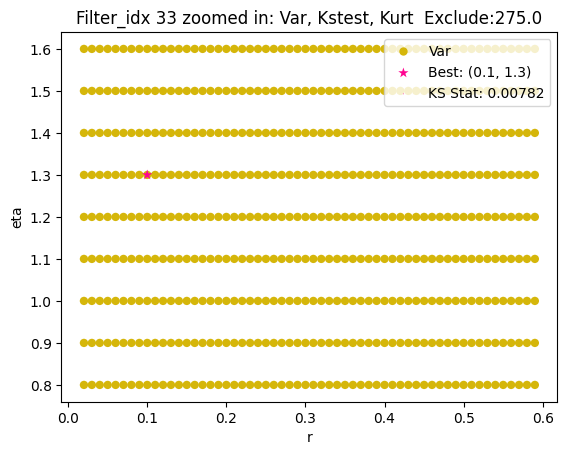

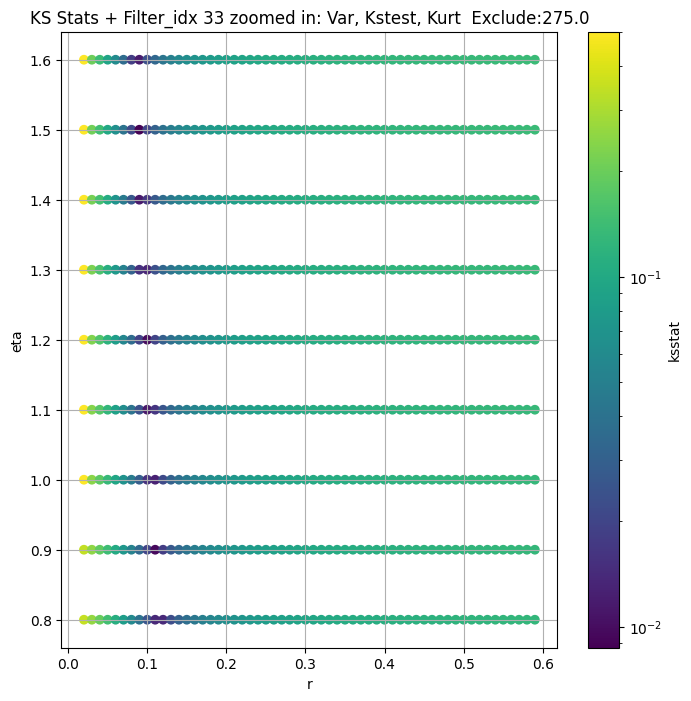

Filter_idx 34


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 100 = 300, ksstat: 0.007878071745992199, var: 17.519289803519758


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 75 = 275, ksstat: 0.008196344394363786, var: 17.99521923700683


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 50 = 250, ksstat: 0.008718693318851778, var: 18.522067854665693


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 25 = 225, ksstat: 0.008219551133484992, var: 19.112380623978225


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + 0 = 200, ksstat: 0.009373548678970667, var: 19.78407982157889


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -25 = 175, ksstat: 0.00960532028122213, var: 20.56302421335654


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -50 = 150, ksstat: 0.009575763183207298, var: 21.48836782919298


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -75 = 125, ksstat: 0.01120152117959805, var: 22.62469371099187


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 34, 200.0 + -100 = 100, ksstat: 0.01030865703254702, var: 24.09007487153377
Number of samples: 100000, Without approximation : 786432000.0


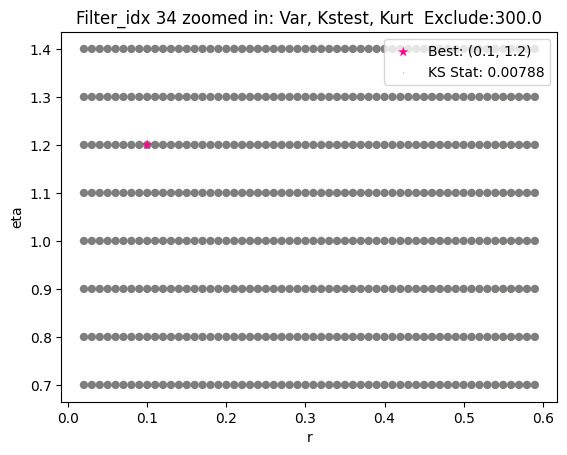

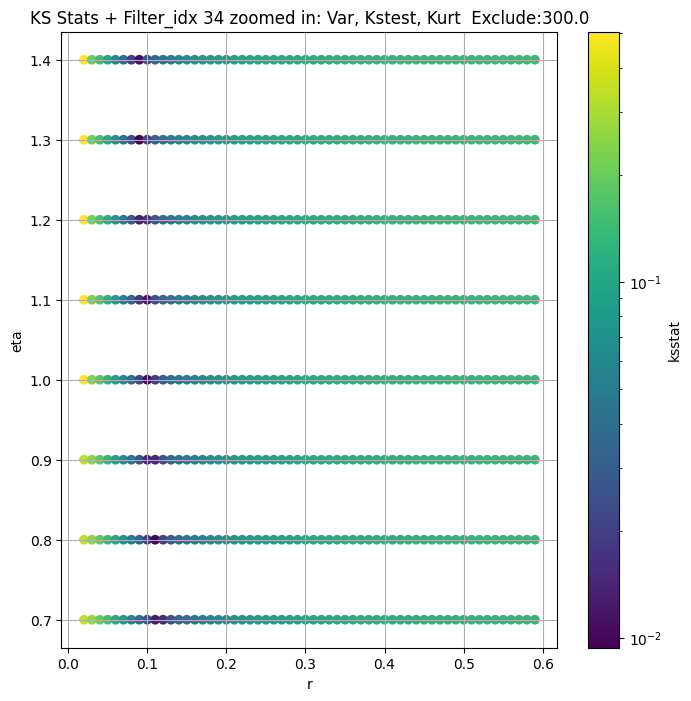

Filter_idx 35


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 200.0 + 100 = 300, ksstat: 0.03156509642927713, var: 84.4082256035084


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 200.0 + 75 = 275, ksstat: 0.03156412779394441, var: 86.17383053777941


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 200.0 + 50 = 250, ksstat: 0.03156364840176362, var: 88.15938861470714


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 200.0 + 25 = 225, ksstat: 0.03156349889178989, var: 90.45916042408993


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 200.0 + 0 = 200, ksstat: 0.031565543067907986, var: 93.16853230957283


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 200.0 + -25 = 175, ksstat: 0.03157236335553926, var: 96.40114420411724


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 200.0 + -50 = 150, ksstat: 0.031564010523367936, var: 100.23287790790015


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 200.0 + -75 = 125, ksstat: 0.031564180809251774, var: 104.92004827068914


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 35, 200.0 + -100 = 100, ksstat: 0.03156461654984005, var: 110.77477570232665
Number of samples: 100000, Without approximation : 786432000.0


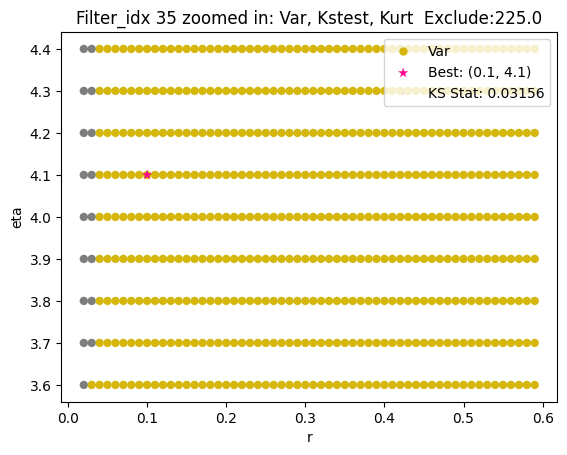

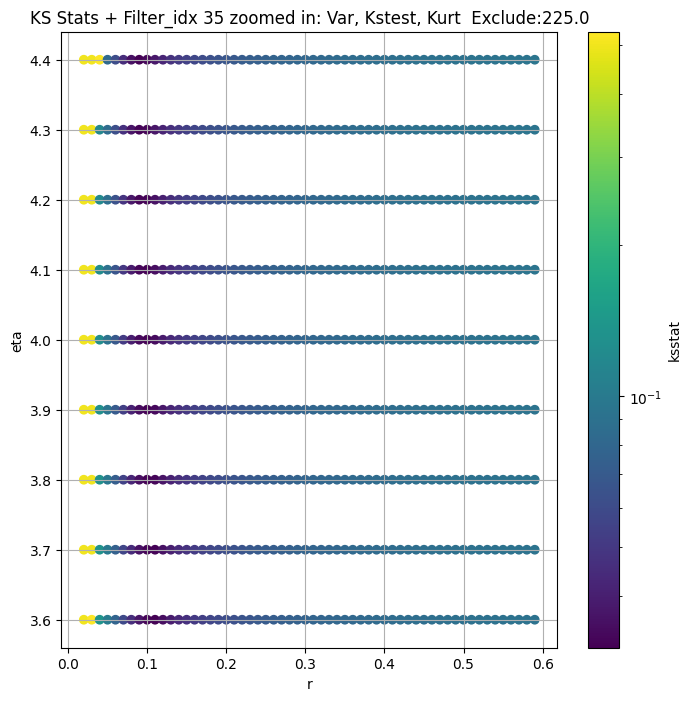

Filter_idx 37


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 37, 100.0 + 100 = 200, ksstat: 0.02874980626773993, var: 141.76445783010524


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 37, 100.0 + 75 = 175, ksstat: 0.028749659358679347, var: 146.14943339894936


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 37, 100.0 + 50 = 150, ksstat: 0.02874964375846678, var: 151.3849335222573


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 37, 100.0 + 25 = 125, ksstat: 0.028749682142553912, var: 157.77551270447609


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 37, 100.0 + 0 = 100, ksstat: 0.028749660773943975, var: 165.85113745950818


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 37, 100.0 + -25 = 75, ksstat: 0.028852747298122983, var: 176.75117628152387


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 37, 100.0 + -50 = 50, ksstat: 0.029076374760558632, var: 192.71808415330992


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 37, 100.0 + -75 = 25, ksstat: 0.030268423503118647, var: 220.00875212622086


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 37, 100.0 + -100 = 0, ksstat: 0.03906063997235093, var: 346.7015064887285
Number of samples: 100000, Without approximation : 786432000.0


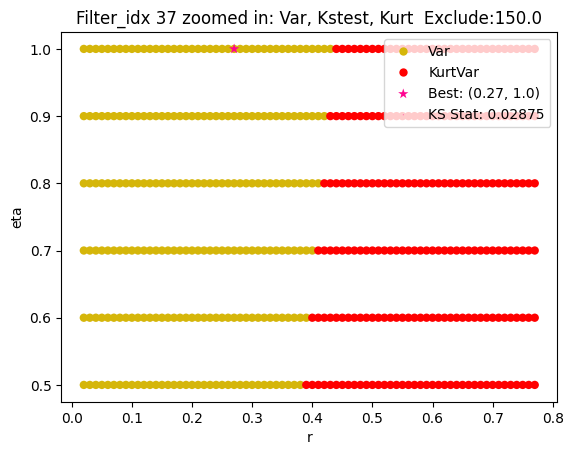

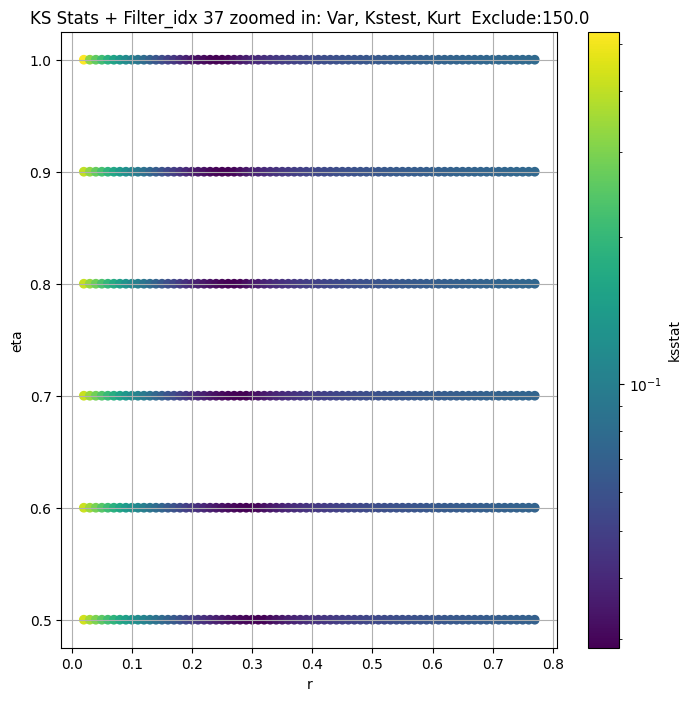

Filter_idx 38


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 100 = 200, ksstat: 0.003010854658479301, var: 34.78398905170788


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 75 = 175, ksstat: 0.0025694606259124876, var: 35.82724423758333


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 50 = 150, ksstat: 0.002243006728317898, var: 37.06689594108996


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 25 = 125, ksstat: 0.0022076511882096472, var: 38.5854990373884


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + 0 = 100, ksstat: 0.0026933213821351693, var: 40.52359351588062


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -25 = 75, ksstat: 0.0038690027663166038, var: 43.14757450289528


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -50 = 50, ksstat: 0.005757102194198005, var: 47.04820714596129


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -75 = 25, ksstat: 0.009388999178887122, var: 54.020078188870606


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 38, 100.0 + -100 = 0, ksstat: 0.020861557935058617, var: 97.3616978858935
Number of samples: 100000, Without approximation : 786432000.0


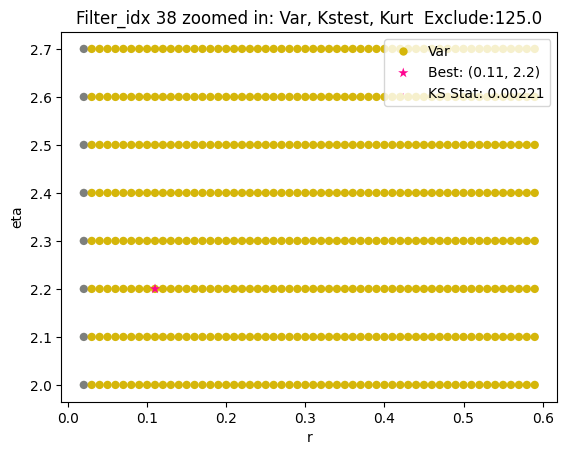

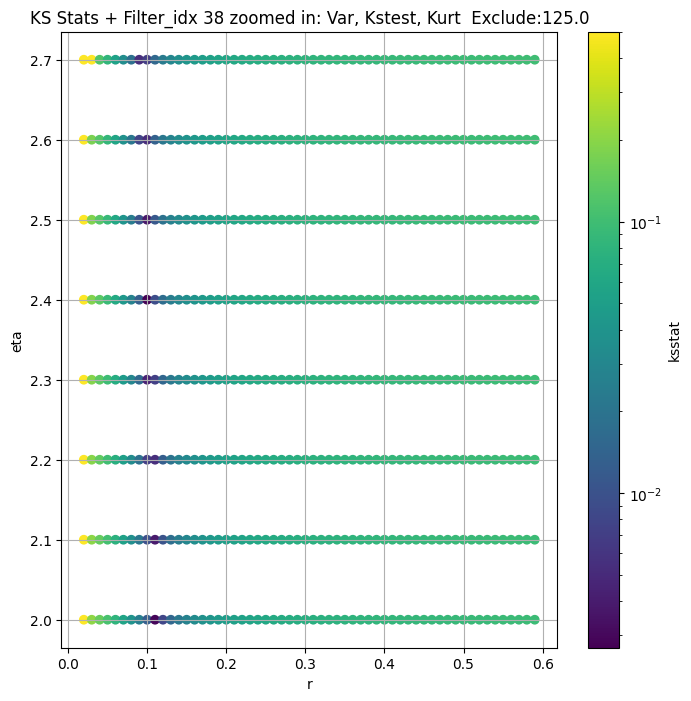

Filter_idx 39


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 100.0 + 100 = 200, ksstat: 0.021312335898447943, var: 32.79884513874081


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 100.0 + 75 = 175, ksstat: 0.02131714301897314, var: 33.77363270309937


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 100.0 + 50 = 150, ksstat: 0.021336149536273274, var: 34.93183426326275


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 100.0 + 25 = 125, ksstat: 0.021330706576876524, var: 36.372713991238136


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 100.0 + 0 = 100, ksstat: 0.021311385777564973, var: 38.28108111732041


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 100.0 + -25 = 75, ksstat: 0.021473509940410473, var: 41.00846474193043


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 100.0 + -50 = 50, ksstat: 0.021917327125835273, var: 45.268459952738226


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 100.0 + -75 = 25, ksstat: 0.023392084001858715, var: 53.01599151485902


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 39, 100.0 + -100 = 0, ksstat: 0.030879770039817192, var: 92.99726287600075
Number of samples: 100000, Without approximation : 786432000.0


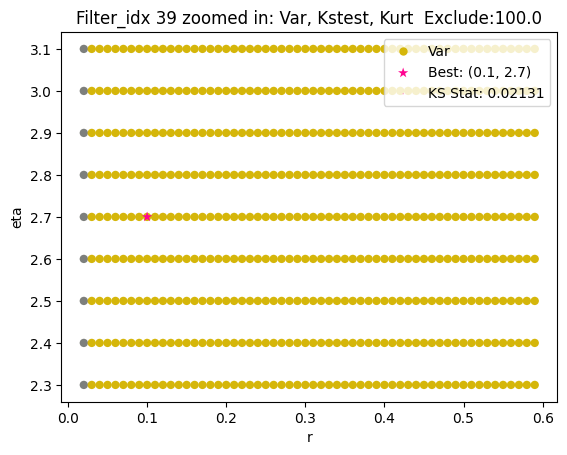

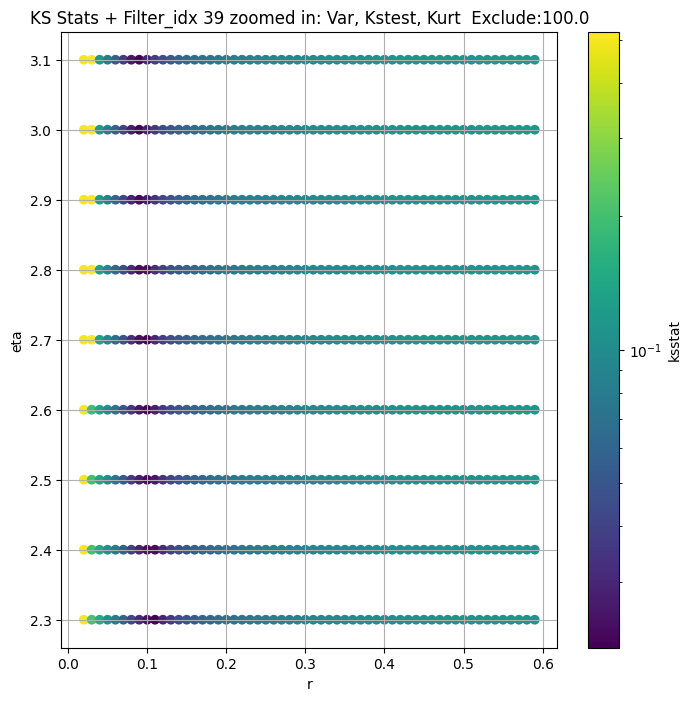

Filter_idx 40


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 100 = 300, ksstat: 0.008587453607287188, var: 25.527545482453817


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 75 = 275, ksstat: 0.008585285818249133, var: 25.964934715306473


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 50 = 250, ksstat: 0.008634001995929785, var: 26.449102505912343


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 25 = 225, ksstat: 0.008899905586319423, var: 27.000378594910174


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + 0 = 200, ksstat: 0.009334465916074453, var: 27.639523525539214


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -25 = 175, ksstat: 0.0102519891672882, var: 28.39623781022728


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -50 = 150, ksstat: 0.01068314120607905, var: 29.310714125026955


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -75 = 125, ksstat: 0.01193726275404755, var: 30.45242055481089


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 40, 200.0 + -100 = 100, ksstat: 0.01288432290311714, var: 31.900558912520882
Number of samples: 100000, Without approximation : 786432000.0


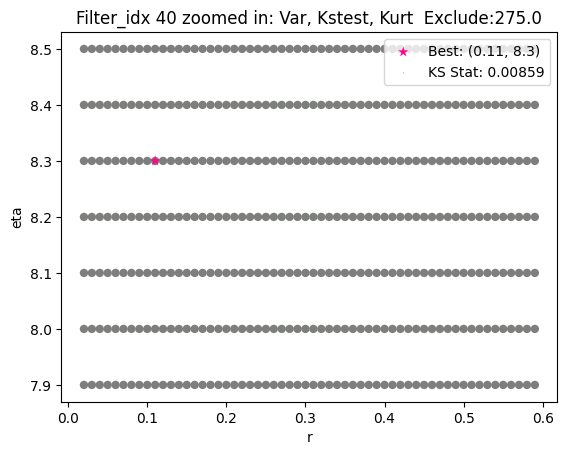

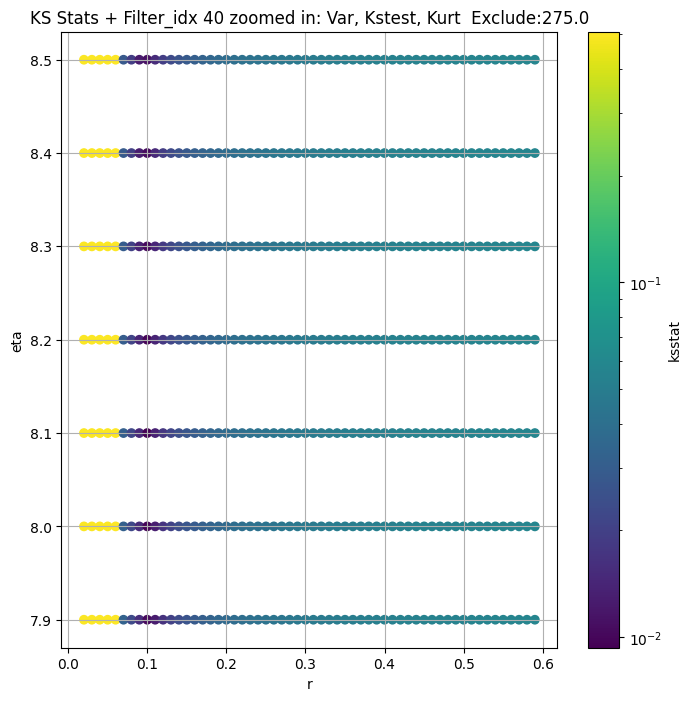

Filter_idx 41


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 100 = 300, ksstat: 0.006685644177038652, var: 11.989717622895766


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 75 = 275, ksstat: 0.00636943021321057, var: 12.259387238216673


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 50 = 250, ksstat: 0.006002098240547538, var: 12.551842909493834


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 25 = 225, ksstat: 0.005835244560375763, var: 12.871851979280098


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + 0 = 200, ksstat: 0.007086122082788693, var: 13.225834705872938


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -25 = 175, ksstat: 0.0068895074950729995, var: 13.623088632415365


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -50 = 150, ksstat: 0.007313434375408101, var: 14.0776150843615


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -75 = 125, ksstat: 0.007797994759599636, var: 14.612245077047557


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 41, 200.0 + -100 = 100, ksstat: 0.00866756637916044, var: 15.267777949669501
Number of samples: 100000, Without approximation : 786432000.0


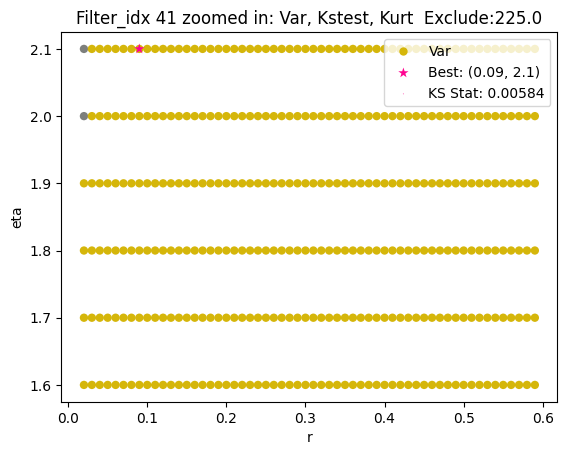

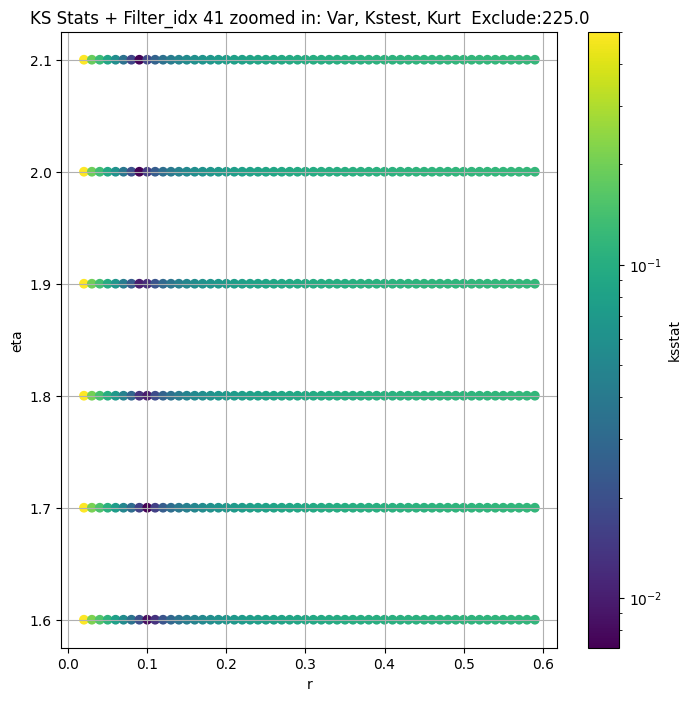

Filter_idx 42


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + 100 = 200, ksstat: 0.002913810358450593, var: 40.578674690326906


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + 75 = 175, ksstat: 0.002433393120476912, var: 41.69591479099498


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + 50 = 150, ksstat: 0.002085199921901996, var: 43.0160568519734


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + 25 = 125, ksstat: 0.0017928327281734962, var: 44.62888086933519


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + 0 = 100, ksstat: 0.002070465109701769, var: 46.69382309607271


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + -25 = 75, ksstat: 0.003881425756993684, var: 49.52076048773871


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + -50 = 50, ksstat: 0.005749141728718543, var: 53.819600343005526


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + -75 = 25, ksstat: 0.008723725182448794, var: 61.67845443390025


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 42, 100.0 + -100 = 0, ksstat: 0.02193069944477366, var: 122.86762645260158
Number of samples: 100000, Without approximation : 786432000.0


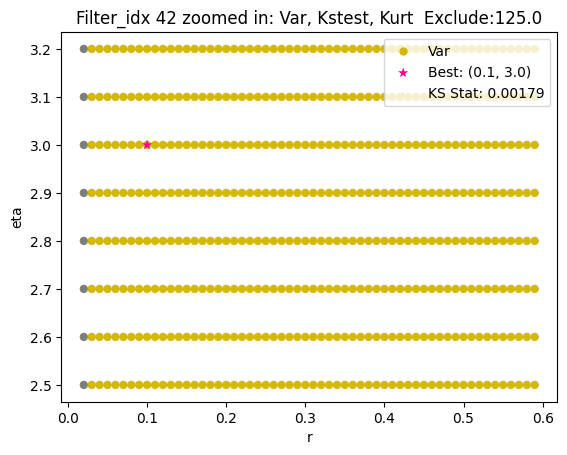

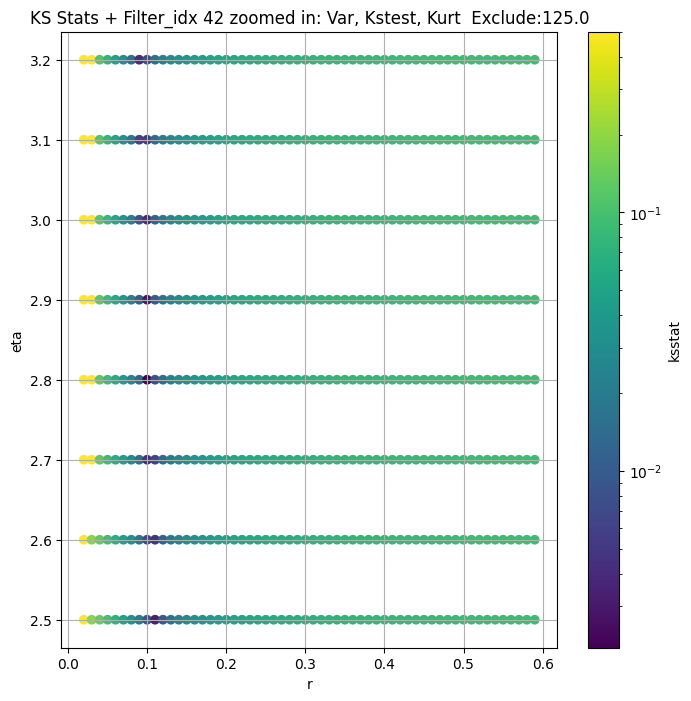

Filter_idx 43


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + 100 = 200, ksstat: 0.00459847966631044, var: 14.6182522286494


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + 75 = 175, ksstat: 0.003990718133521254, var: 15.012118739988578


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + 50 = 150, ksstat: 0.0034204441788877604, var: 15.469900353744503


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + 25 = 125, ksstat: 0.0031194167007900786, var: 16.019612810168997


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + 0 = 100, ksstat: 0.0030114577669281273, var: 16.71229838930892


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + -25 = 75, ksstat: 0.003701545089659586, var: 17.656113394134263


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + -50 = 50, ksstat: 0.005167564302416272, var: 19.121343045646032


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + -75 = 25, ksstat: 0.007214678116048867, var: 21.95341347859126


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 43, 100.0 + -100 = 0, ksstat: 0.01888821192491067, var: 42.07373496727608
Number of samples: 100000, Without approximation : 786432000.0


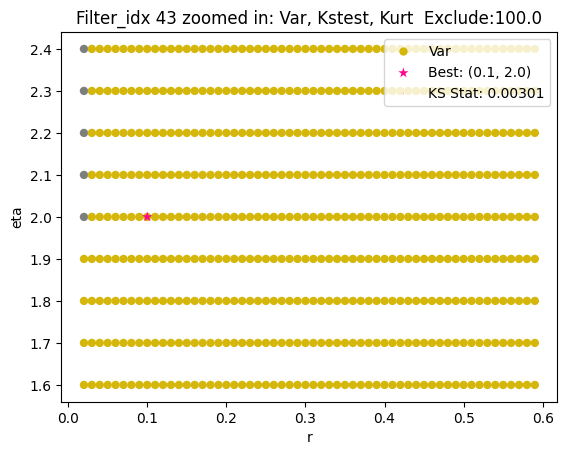

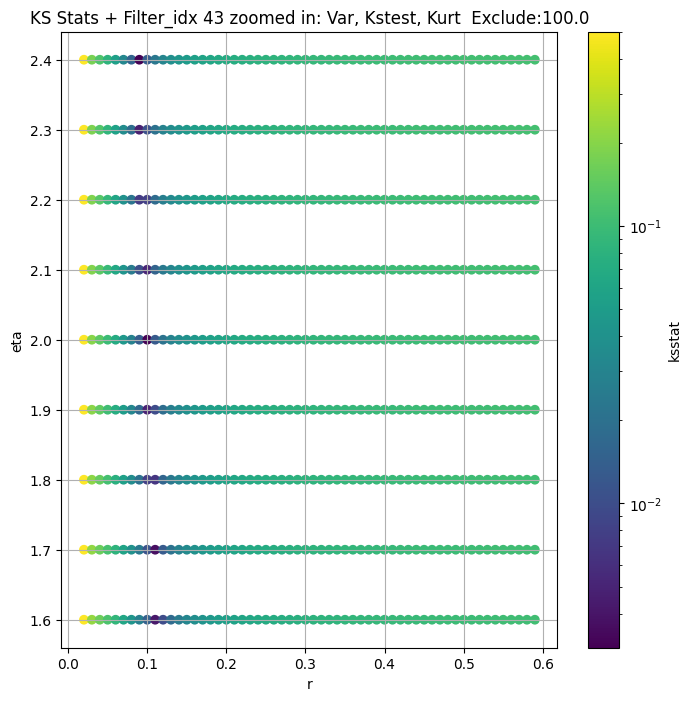

Filter_idx 44


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 44, 100.0 + 100 = 200, ksstat: 0.003933504839340393, var: 50.102586927146724


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 44, 100.0 + 75 = 175, ksstat: 0.0032647937258961993, var: 51.55147606362121


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 44, 100.0 + 50 = 150, ksstat: 0.0025528331627072826, var: 53.28241352096733


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 44, 100.0 + 25 = 125, ksstat: 0.0016989806265289287, var: 55.41777425209468


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 44, 100.0 + 0 = 100, ksstat: 0.0013232240348707291, var: 58.16300887848578


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 44, 100.0 + -25 = 75, ksstat: 0.002271583367509919, var: 61.90134022169853


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 44, 100.0 + -50 = 50, ksstat: 0.004121327630271843, var: 67.44550022318028


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 44, 100.0 + -75 = 25, ksstat: 0.006910510790772539, var: 77.11678603889084


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 44, 100.0 + -100 = 0, ksstat: 0.017545159536374144, var: 129.22281369823193
Number of samples: 100000, Without approximation : 786432000.0


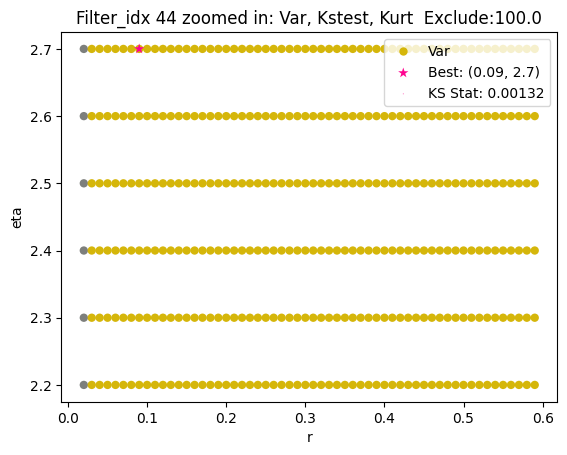

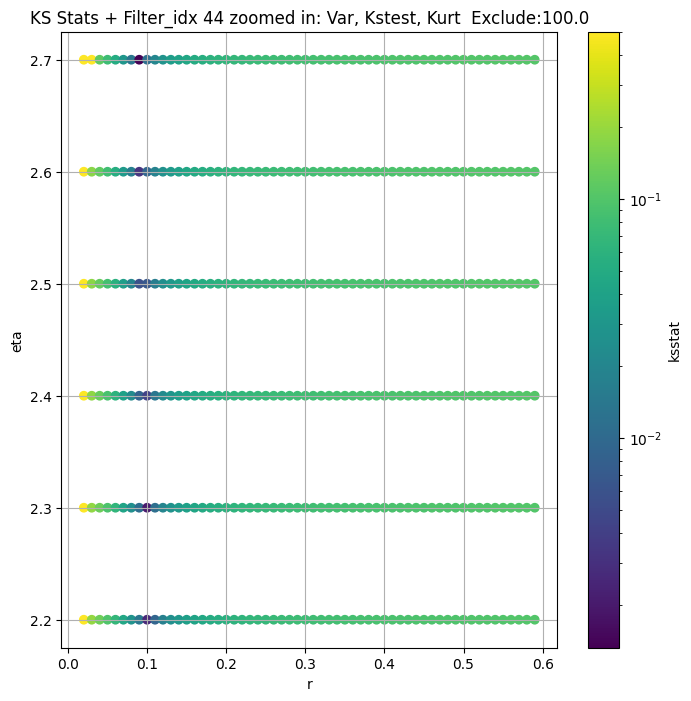

Filter_idx 45


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 200.0 + 100 = 300, ksstat: 0.006658264574548323, var: 21.402556699678506


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 200.0 + 75 = 275, ksstat: 0.006232373784109901, var: 21.830960632595765


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 200.0 + 50 = 250, ksstat: 0.0057500115688575715, var: 22.300897044734462


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 200.0 + 25 = 225, ksstat: 0.005236980569701011, var: 22.823002848864444


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 200.0 + 0 = 200, ksstat: 0.004688460720469911, var: 23.412529676480904


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 200.0 + -25 = 175, ksstat: 0.004147745419810445, var: 24.093518871161134


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 200.0 + -50 = 150, ksstat: 0.0035798311823570517, var: 24.904517449931483


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 200.0 + -75 = 125, ksstat: 0.004181206340385879, var: 25.91338684703516


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 45, 200.0 + -100 = 100, ksstat: 0.005132506921906255, var: 27.246376435317217
Number of samples: 100000, Without approximation : 786432000.0


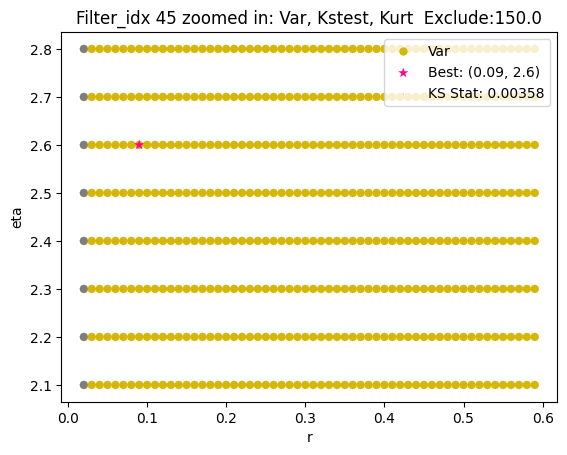

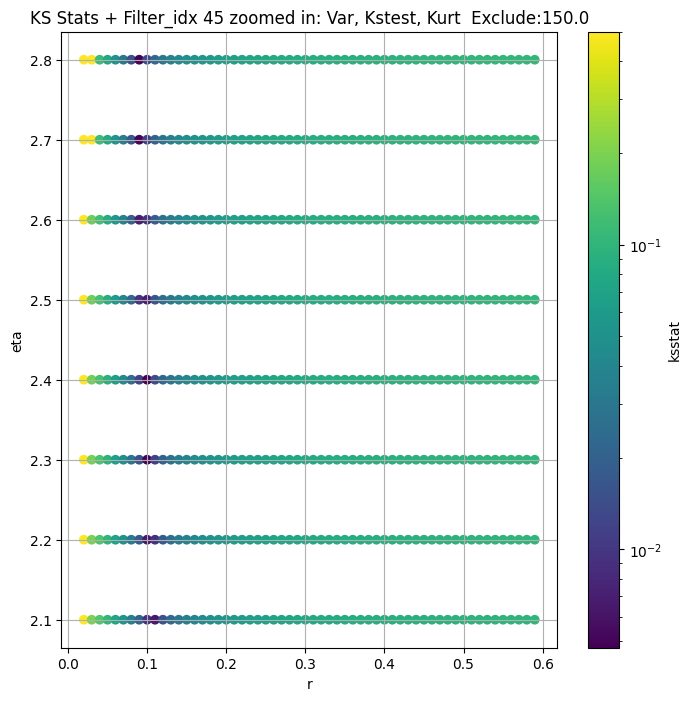

Filter_idx 46


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 100 = 300, ksstat: 0.013456354885557964, var: 13.067345034103559


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 75 = 275, ksstat: 0.013432157538900924, var: 13.313448861257891


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 50 = 250, ksstat: 0.013580982050243828, var: 13.586772897357529


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 25 = 225, ksstat: 0.013442162774293664, var: 13.894244444278785


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + 0 = 200, ksstat: 0.013479376496550732, var: 14.246562635723775


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -25 = 175, ksstat: 0.013459868969090405, var: 14.658511891688773


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -50 = 150, ksstat: 0.013443016680462716, var: 15.151846669128021


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -75 = 125, ksstat: 0.013383465700271657, var: 15.763576298554087


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 46, 200.0 + -100 = 100, ksstat: 0.013678399451744205, var: 16.555427635790334
Number of samples: 100000, Without approximation : 786432000.0


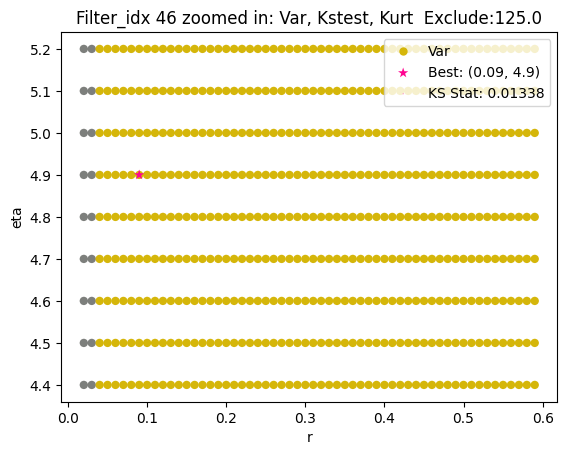

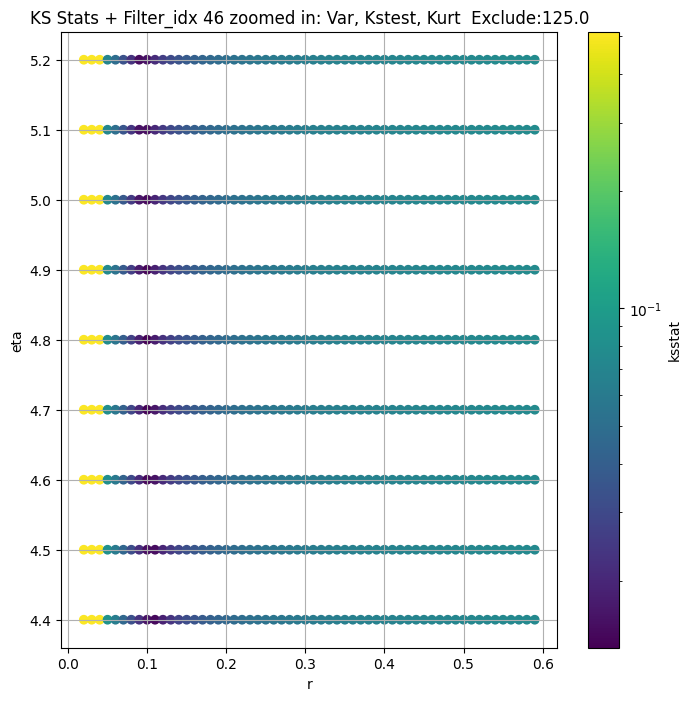

Filter_idx 47


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + 100 = 200, ksstat: 0.003815286843424026, var: 17.540739992436777


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + 75 = 175, ksstat: 0.0032207955361424068, var: 18.10966813979269


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + 50 = 150, ksstat: 0.002858115520052107, var: 18.78332741613956


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + 25 = 125, ksstat: 0.0027600411943520253, var: 19.60309679721814


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + 0 = 100, ksstat: 0.002716561349833446, var: 20.639943504793028


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + -25 = 75, ksstat: 0.0024805803280162214, var: 22.025322333499762


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + -50 = 50, ksstat: 0.004410152894842201, var: 24.05117683912482


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + -75 = 25, ksstat: 0.008089632112883272, var: 27.61918463643451


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 47, 100.0 + -100 = 0, ksstat: 0.019666094371882478, var: 51.103251617939364
Number of samples: 100000, Without approximation : 786432000.0


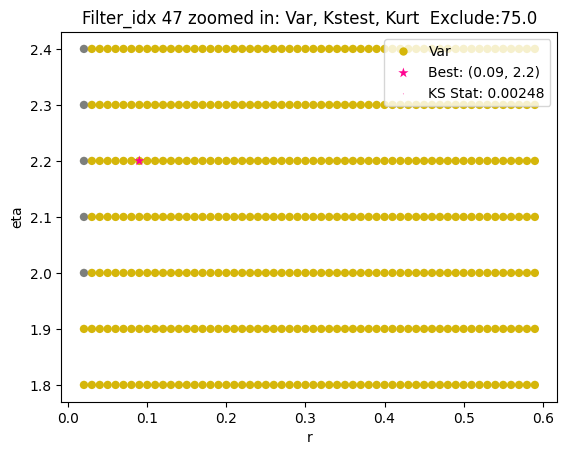

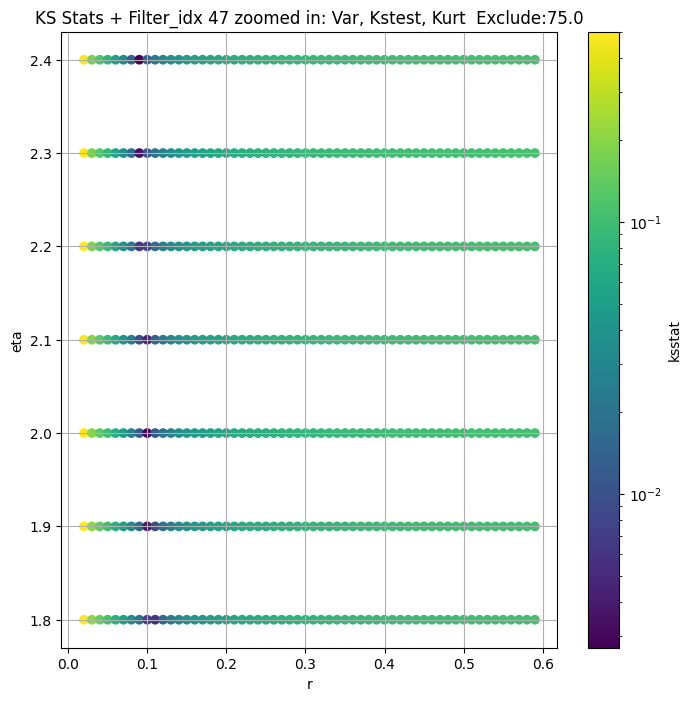

Filter_idx 48


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + 100 = 300, ksstat: 0.006550803702817465, var: 12.326342002092826


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + 75 = 275, ksstat: 0.007007404224705527, var: 12.648712129426976


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + 50 = 250, ksstat: 0.0067217549742388805, var: 13.003096599335558


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + 25 = 225, ksstat: 0.0068843674124083876, var: 13.396267177085273


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + 0 = 200, ksstat: 0.007200280761601535, var: 13.837379690607387


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + -25 = 175, ksstat: 0.007236506799741971, var: 14.339530713991545


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + -50 = 150, ksstat: 0.0073168437158193655, var: 14.921906922520101


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + -75 = 125, ksstat: 0.007716647268331739, var: 15.613943961501583


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 48, 200.0 + -100 = 100, ksstat: 0.007882398039805616, var: 16.464510756708137
Number of samples: 100000, Without approximation : 786432000.0


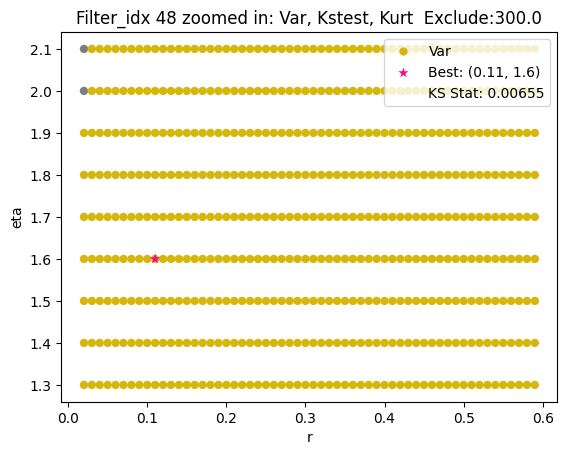

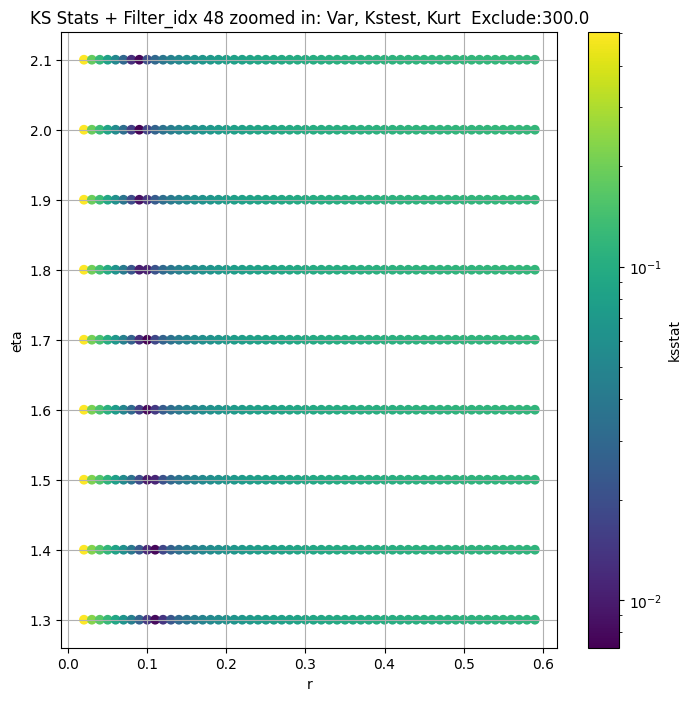

Filter_idx 49


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 49, 100.0 + 100 = 200, ksstat: 0.004151360781224855, var: 48.80672015587818


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 49, 100.0 + 75 = 175, ksstat: 0.003528505609279746, var: 50.05735672690036


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 49, 100.0 + 50 = 150, ksstat: 0.002987938756922267, var: 51.51999044510891


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 49, 100.0 + 25 = 125, ksstat: 0.002269754581304715, var: 53.29544153662601


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 49, 100.0 + 0 = 100, ksstat: 0.002463066838689132, var: 55.57433613503895


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 49, 100.0 + -25 = 75, ksstat: 0.0026740586074311817, var: 58.74269074389909


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 49, 100.0 + -50 = 50, ksstat: 0.0047710717990157026, var: 63.65726978321403


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 49, 100.0 + -75 = 25, ksstat: 0.006986531124530515, var: 72.76559362164114


  0%|          | 0/580 [00:00<?, ?it/s]

Finding Minimum after computing 580 CDFs
filter_idx 49, 100.0 + -100 = 0, ksstat: 0.017628199325217753, var: 127.86488372385871
Number of samples: 100000, Without approximation : 786432000.0


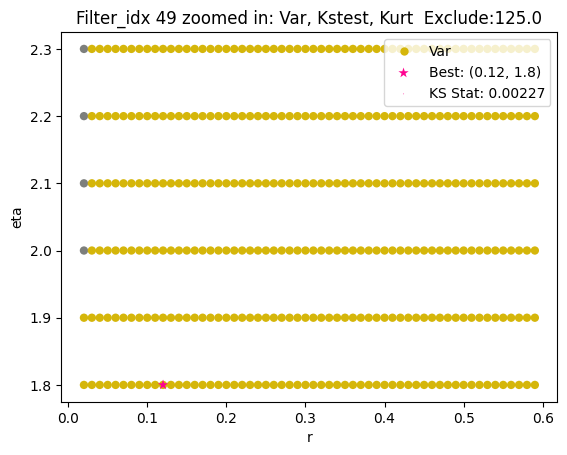

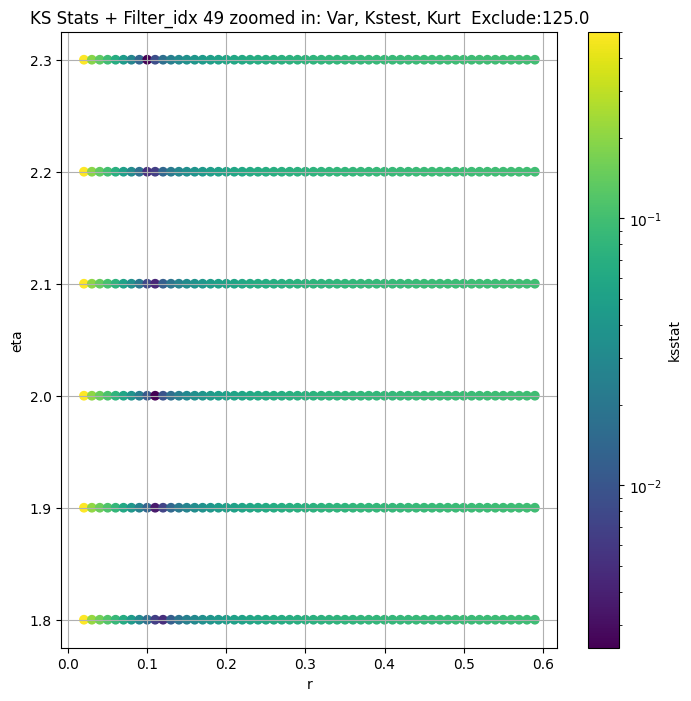

Filter_idx 50


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 100.0 + 100 = 200, ksstat: 0.004889384822473697, var: 22.243735446195927


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 100.0 + 75 = 175, ksstat: 0.004878788685630964, var: 22.86919558339378


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 100.0 + 50 = 150, ksstat: 0.00490744375740082, var: 23.594800002993303


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 100.0 + 25 = 125, ksstat: 0.00489322629465333, var: 24.465940750714946


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 100.0 + 0 = 100, ksstat: 0.00487475637364615, var: 25.570455009011273


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 100.0 + -25 = 75, ksstat: 0.005238064790379693, var: 27.09244507582493


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 100.0 + -50 = 50, ksstat: 0.006180506047720025, var: 29.451941685960396


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 100.0 + -75 = 25, ksstat: 0.008472426562925128, var: 33.87662534198722


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 50, 100.0 + -100 = 0, ksstat: 0.020592574341735337, var: 65.95109188413258
Number of samples: 100000, Without approximation : 786432000.0


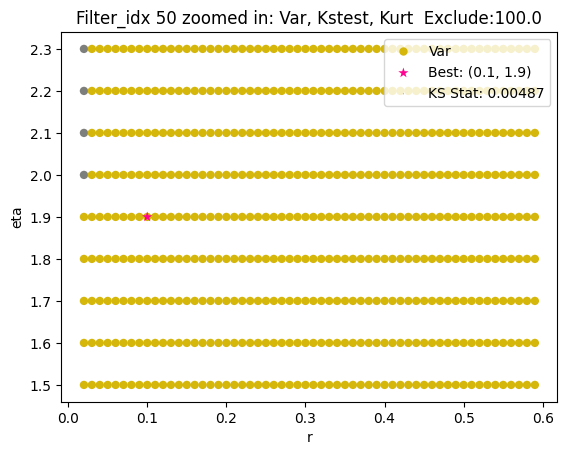

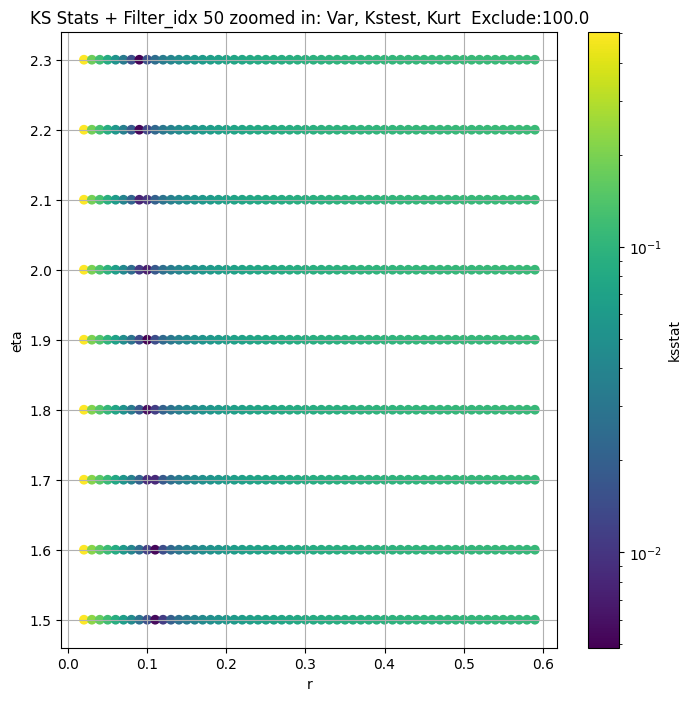

Filter_idx 52


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 100 = 300, ksstat: 0.006879160014690355, var: 26.101606579516634


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 75 = 275, ksstat: 0.007195149182925631, var: 26.5579281855937


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 50 = 250, ksstat: 0.007660396224725585, var: 27.06924517776555


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 25 = 225, ksstat: 0.008000711157057, var: 27.65109961909933


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + 0 = 200, ksstat: 0.008328746055784667, var: 28.324950424559876


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -25 = 175, ksstat: 0.00905655154330176, var: 29.11924449690286


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -50 = 150, ksstat: 0.00997886140786075, var: 30.080038757640725


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -75 = 125, ksstat: 0.01095523437778205, var: 31.27117399287993


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 52, 200.0 + -100 = 100, ksstat: 0.012044587981414556, var: 32.808175415526335
Number of samples: 100000, Without approximation : 786432000.0


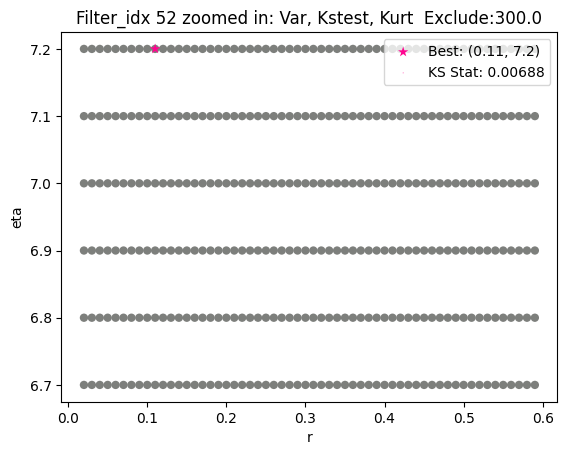

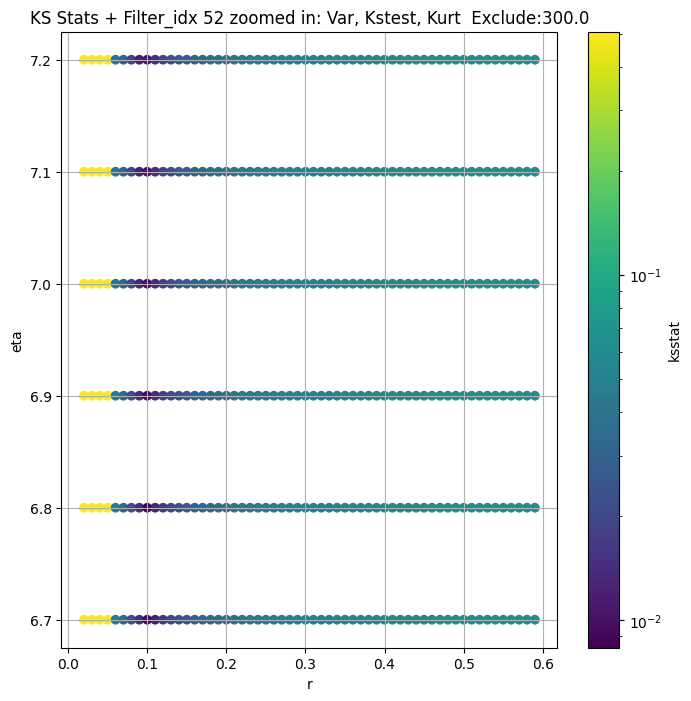

Filter_idx 54


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + 100 = 300, ksstat: 0.005437966669000843, var: 3.6258734144334333


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + 75 = 275, ksstat: 0.006272506314082993, var: 3.747009754050908


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + 50 = 250, ksstat: 0.007723554459291293, var: 3.8837871870646943


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + 25 = 225, ksstat: 0.006991595296022002, var: 4.040065085665341


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + 0 = 200, ksstat: 0.008017995331872418, var: 4.221179762426768


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + -25 = 175, ksstat: 0.00889584217992441, var: 4.43427124350342


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + -50 = 150, ksstat: 0.009784333585805854, var: 4.689288097336487


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + -75 = 125, ksstat: 0.01050014630291761, var: 5.000563859047521


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 54, 200.0 + -100 = 100, ksstat: 0.012485504211183523, var: 5.389885470482396
Number of samples: 100000, Without approximation : 786432000.0


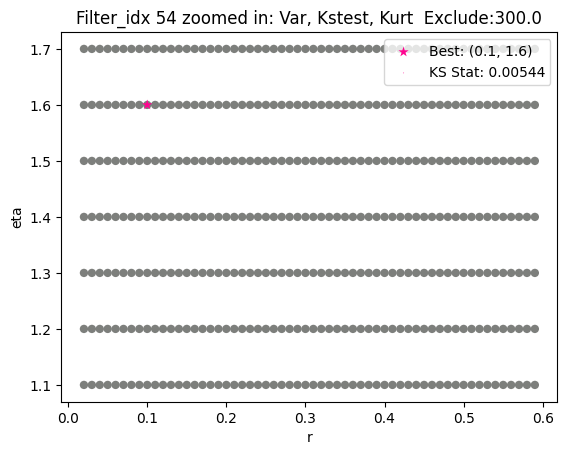

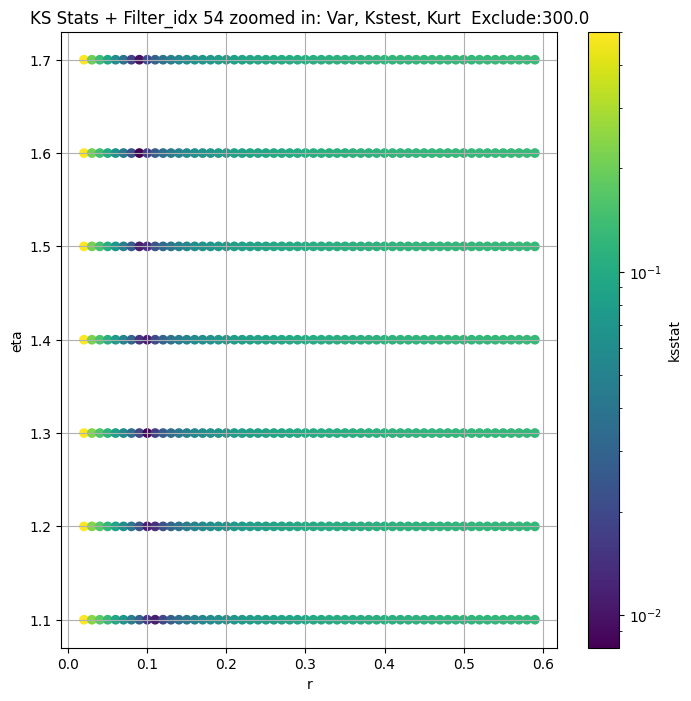

Filter_idx 55


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + 100 = 300, ksstat: 0.005582453575667036, var: 15.064554851790835


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + 75 = 275, ksstat: 0.005164386258558718, var: 15.390861596361448


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + 50 = 250, ksstat: 0.004771267029931548, var: 15.747965198892024


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + 25 = 225, ksstat: 0.004327157100962202, var: 16.142673178236358


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + 0 = 200, ksstat: 0.003913297486088849, var: 16.584547809915186


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + -25 = 175, ksstat: 0.00387760313104224, var: 17.087423215508426


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + -50 = 150, ksstat: 0.004600667928714303, var: 17.671892227404136


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + -75 = 125, ksstat: 0.004959961095054033, var: 18.371521782766244


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 55, 200.0 + -100 = 100, ksstat: 0.0066138247091503954, var: 19.2442265873234
Number of samples: 100000, Without approximation : 786432000.0


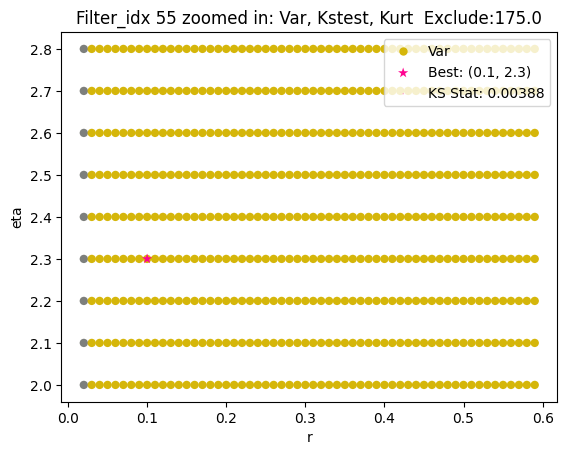

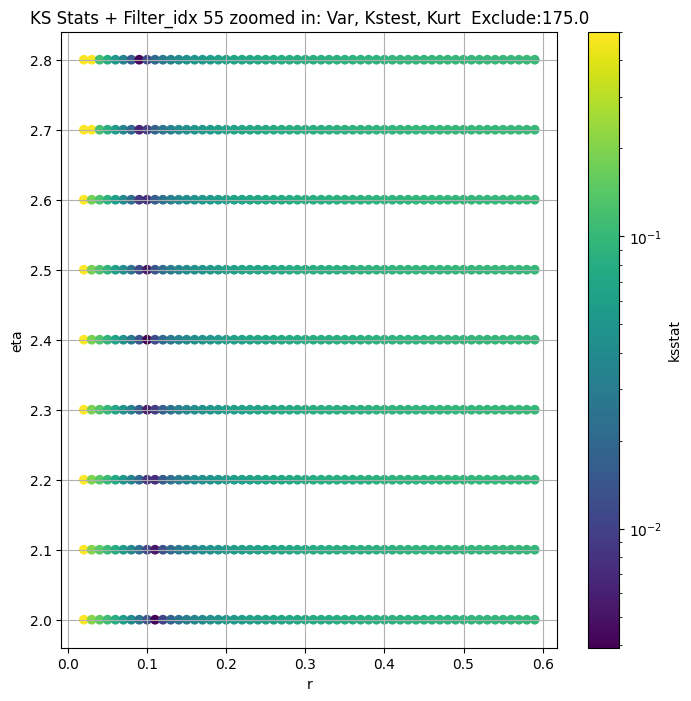

Filter_idx 56


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 50.0 + 100 = 150, ksstat: 0.006959480046247468, var: 28.994034043889293


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 50.0 + 75 = 125, ksstat: 0.005697852650372592, var: 30.15350719498165


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 50.0 + 50 = 100, ksstat: 0.004735464897051567, var: 31.624292402179606


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 50.0 + 25 = 75, ksstat: 0.004007852336473827, var: 33.611613016817095


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 50.0 + 0 = 50, ksstat: 0.00318109514710474, var: 36.604603638022695


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 50.0 + -25 = 25, ksstat: 0.0036819911967894137, var: 42.19500468610759


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 56, 50.0 + -50 = 0, ksstat: 0.01458036193863009, var: 80.94409186083045
Number of samples: 100000, Without approximation : 786432000.0


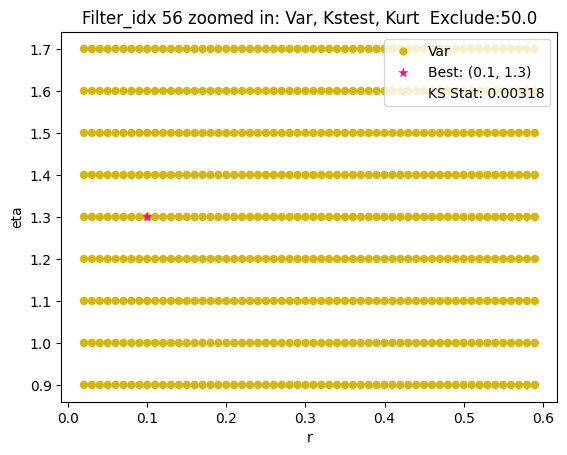

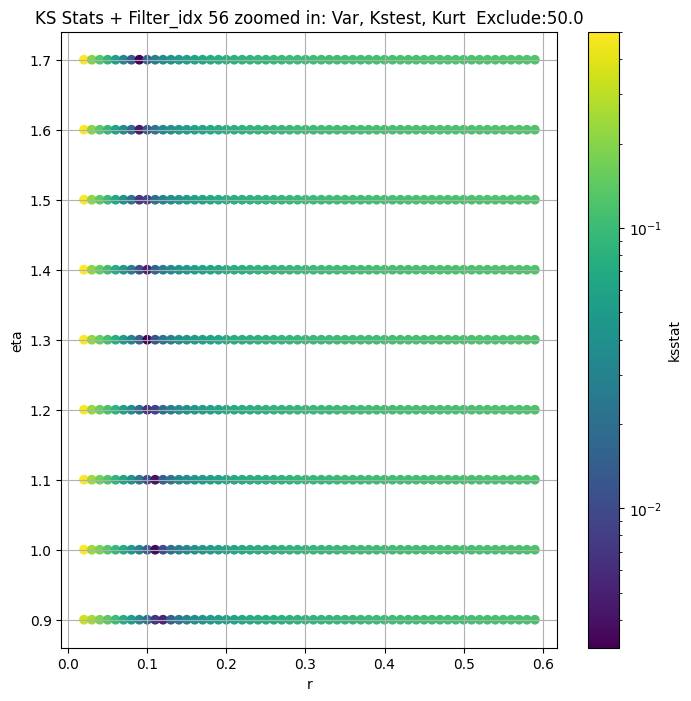

Filter_idx 57


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + 100 = 300, ksstat: 0.005760635011665571, var: 18.018295452755037


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + 75 = 275, ksstat: 0.005340904890571263, var: 18.37403116214398


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + 50 = 250, ksstat: 0.004948473529809316, var: 18.76120422555282


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + 25 = 225, ksstat: 0.004502422930779848, var: 19.18678589489362


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + 0 = 200, ksstat: 0.004083421466257731, var: 19.66077560086873


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + -25 = 175, ksstat: 0.0039677644112736665, var: 20.19784561560499


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + -50 = 150, ksstat: 0.004186439131894315, var: 20.8208108704321


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + -75 = 125, ksstat: 0.005082604232563237, var: 21.568116021933548


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 57, 200.0 + -100 = 100, ksstat: 0.00570988616381557, var: 22.51019487155128
Number of samples: 100000, Without approximation : 786432000.0


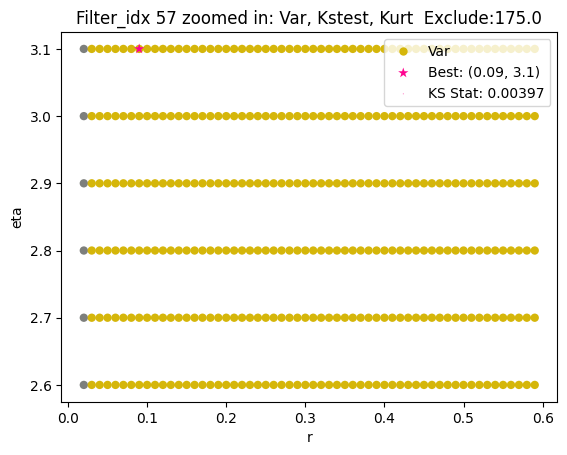

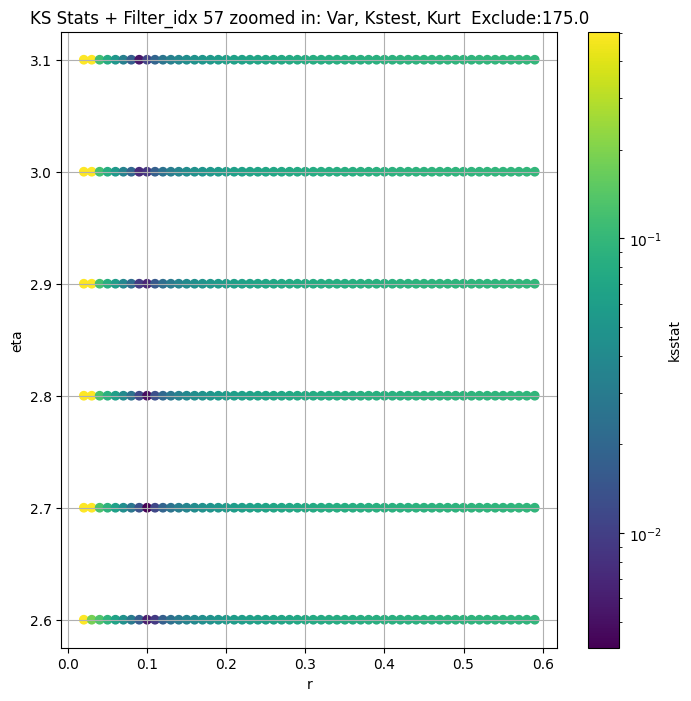

Filter_idx 58


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + 100 = 300, ksstat: 0.011492034198715806, var: 15.427639514563634


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + 75 = 275, ksstat: 0.01161868281878542, var: 15.686843846128133


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + 50 = 250, ksstat: 0.011830454664382595, var: 15.974945854020188


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + 25 = 225, ksstat: 0.011931045713923394, var: 16.301231197433957


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + 0 = 200, ksstat: 0.012357239517666097, var: 16.680156179255277


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + -25 = 175, ksstat: 0.012545923560665195, var: 17.13327985874651


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + -50 = 150, ksstat: 0.012910276057969017, var: 17.688207707936694


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + -75 = 125, ksstat: 0.013726209274393608, var: 18.37476858479346


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 58, 200.0 + -100 = 100, ksstat: 0.014212074225974536, var: 19.25573640764299
Number of samples: 100000, Without approximation : 786432000.0


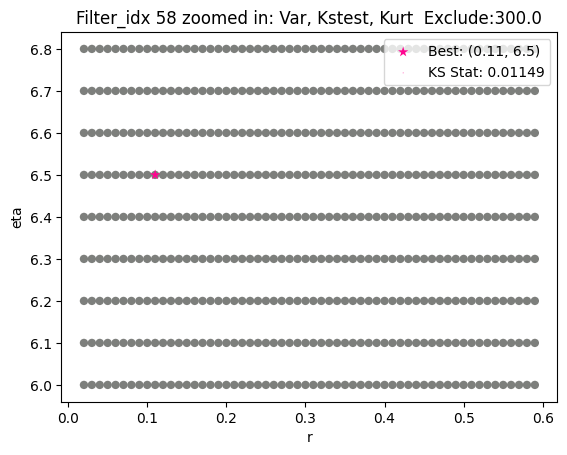

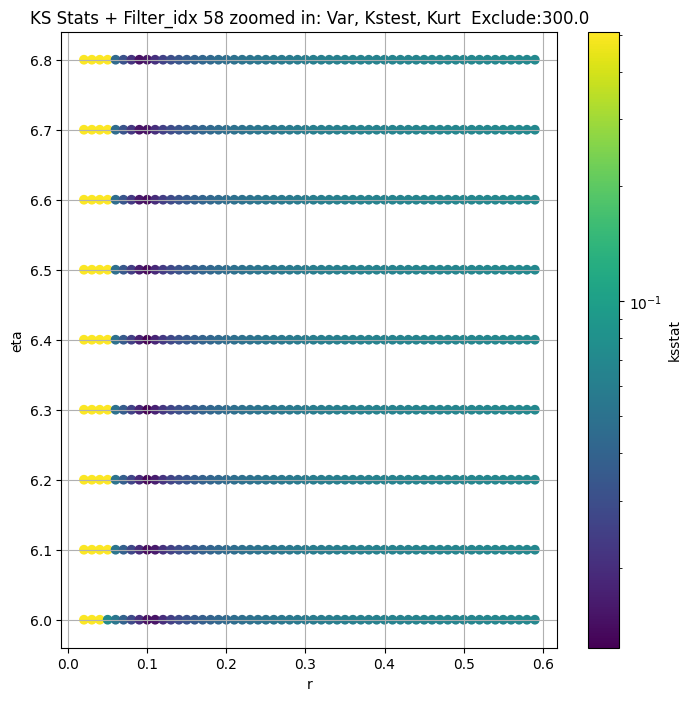

Filter_idx 59


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 59, 100.0 + 100 = 200, ksstat: 0.0033343456542471728, var: 28.987559489945752


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 59, 100.0 + 75 = 175, ksstat: 0.0026240742906273873, var: 29.776234440453237


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 59, 100.0 + 50 = 150, ksstat: 0.0020677212988599036, var: 30.712746404925873


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 59, 100.0 + 25 = 125, ksstat: 0.001996836573329719, var: 31.86430537005222


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 59, 100.0 + 0 = 100, ksstat: 0.0015651374483259262, var: 33.35019965587266


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 59, 100.0 + -25 = 75, ksstat: 0.0025923392355415575, var: 35.403214131700466


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 59, 100.0 + -50 = 50, ksstat: 0.004441750293038282, var: 38.558463226735434


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 59, 100.0 + -75 = 25, ksstat: 0.00810670495513538, var: 44.53868418241345


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 59, 100.0 + -100 = 0, ksstat: 0.02294313639078778, var: 98.21557298868706
Number of samples: 100000, Without approximation : 786432000.0


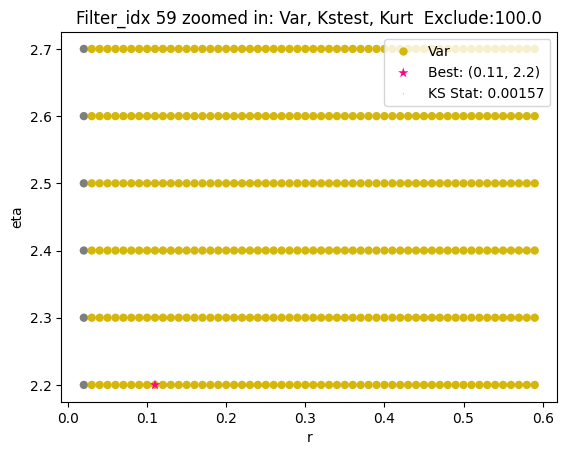

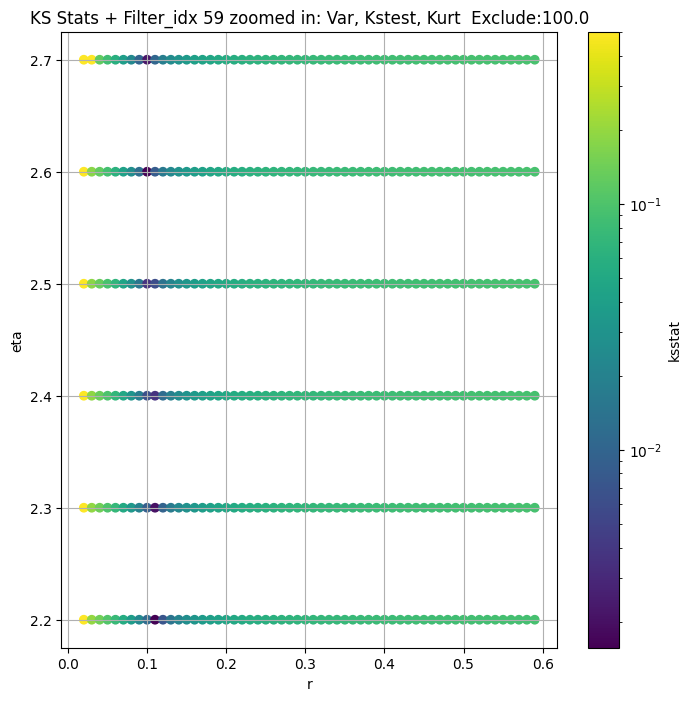

Filter_idx 60


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 100 = 300, ksstat: 0.014943565136653736, var: 1.64138583231176


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 75 = 275, ksstat: 0.014915774713920471, var: 1.6793499018442744


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 50 = 250, ksstat: 0.014950750522559009, var: 1.7211231156062916


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 25 = 225, ksstat: 0.015154149927358723, var: 1.767504601572113


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + 0 = 200, ksstat: 0.015348988890806714, var: 1.8195571497476375


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -25 = 175, ksstat: 0.015458555731181267, var: 1.8791109917219628


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -50 = 150, ksstat: 0.01607678773127541, var: 1.948715918936565


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -75 = 125, ksstat: 0.01666927698420717, var: 2.0325198854626847


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 60, 200.0 + -100 = 100, ksstat: 0.01699259424668631, var: 2.1377710227404005
Number of samples: 100000, Without approximation : 786432000.0


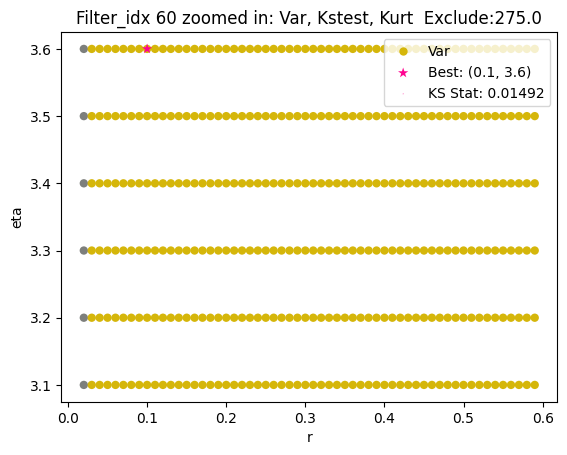

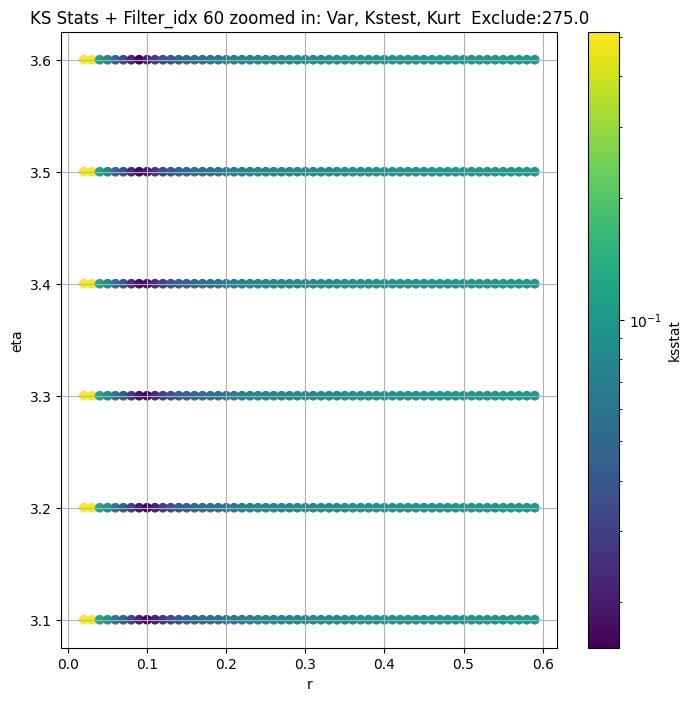

Filter_idx 61


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 61, 200.0 + 100 = 300, ksstat: 0.005396254064381822, var: 13.621304187090782


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 61, 200.0 + 75 = 275, ksstat: 0.004969011324034933, var: 13.938461497901459


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 61, 200.0 + 50 = 250, ksstat: 0.004533716622305395, var: 14.286000240067539


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 61, 200.0 + 25 = 225, ksstat: 0.004134356057391209, var: 14.670524917627066


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 61, 200.0 + 0 = 200, ksstat: 0.0036903462430113443, var: 15.10109018073086


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 61, 200.0 + -25 = 175, ksstat: 0.0033194618565398626, var: 15.59025068705526


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 61, 200.0 + -50 = 150, ksstat: 0.0035405610229035656, var: 16.156458554893067


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 61, 200.0 + -75 = 125, ksstat: 0.004533426456370893, var: 16.82865733450426


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 61, 200.0 + -100 = 100, ksstat: 0.0053117063290967215, var: 17.654236741836712
Number of samples: 100000, Without approximation : 786432000.0


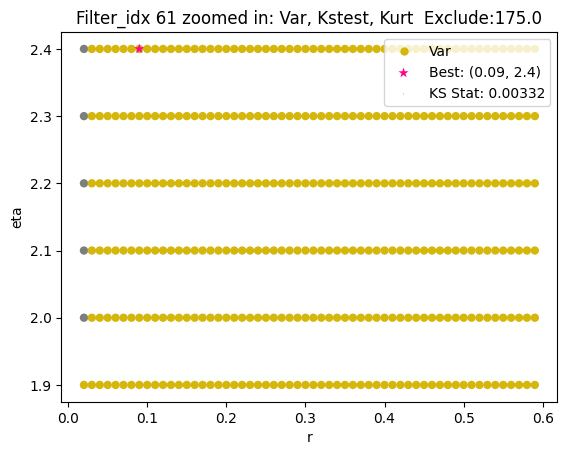

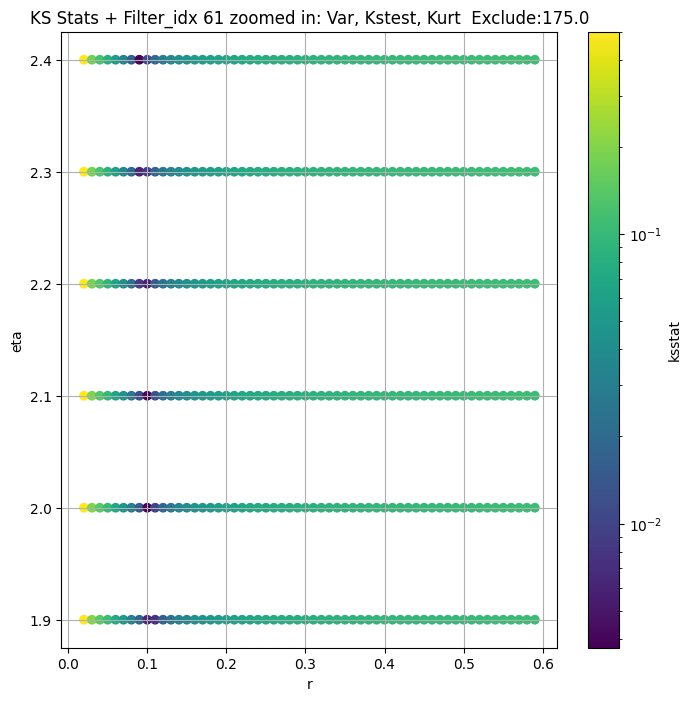

Filter_idx 62


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 200.0 + 100 = 300, ksstat: 0.006286983208865782, var: 15.80970164006054


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 200.0 + 75 = 275, ksstat: 0.005748993535954372, var: 16.141374774713068


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 200.0 + 50 = 250, ksstat: 0.005554121275209045, var: 16.507587999858252


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 200.0 + 25 = 225, ksstat: 0.004883305776152036, var: 16.91672359111083


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 200.0 + 0 = 200, ksstat: 0.004242667948270107, var: 17.380491371664693


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 200.0 + -25 = 175, ksstat: 0.0040348197601662306, var: 17.915694763656337


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 200.0 + -50 = 150, ksstat: 0.004001242581673559, var: 18.548347867788213


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 200.0 + -75 = 125, ksstat: 0.0040555081163518025, var: 19.32201805974471


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 62, 200.0 + -100 = 100, ksstat: 0.004096118171006746, var: 20.311188179250713
Number of samples: 100000, Without approximation : 786432000.0


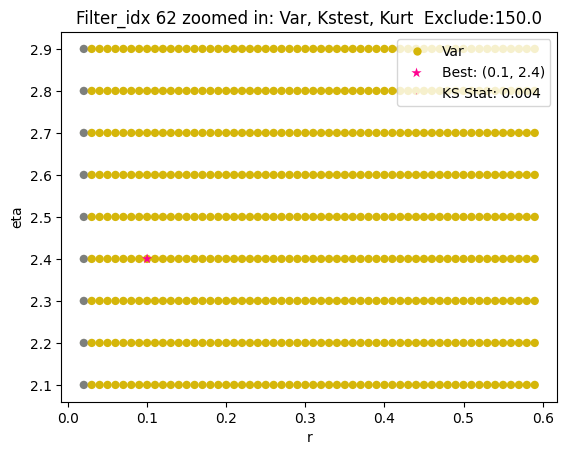

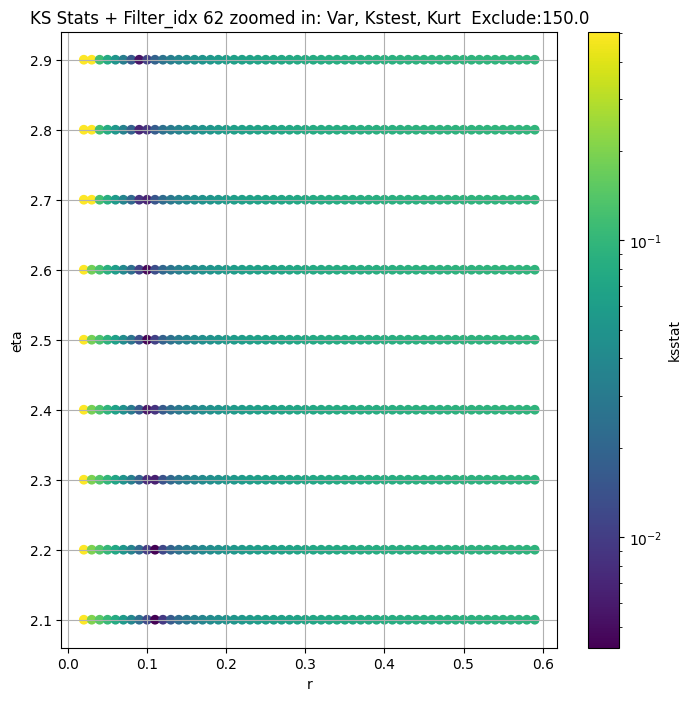

Filter_idx 63


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + 100 = 300, ksstat: 0.006372473112614463, var: 5.214399484794399


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + 75 = 275, ksstat: 0.006697044360242432, var: 5.342139620075943


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + 50 = 250, ksstat: 0.006142305305008922, var: 5.481511263169276


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + 25 = 225, ksstat: 0.006300404144272687, var: 5.634966912310925


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + 0 = 200, ksstat: 0.007499708586901577, var: 5.805831317995545


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + -25 = 175, ksstat: 0.007634314251856789, var: 5.998707772592242


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + -50 = 150, ksstat: 0.008456578953901062, var: 6.220538997115904


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + -75 = 125, ksstat: 0.008928765321785104, var: 6.482244924525735


  0%|          | 0/522 [00:00<?, ?it/s]

Finding Minimum after computing 522 CDFs
filter_idx 63, 200.0 + -100 = 100, ksstat: 0.009014730033842955, var: 6.802578077439762
Number of samples: 100000, Without approximation : 786432000.0


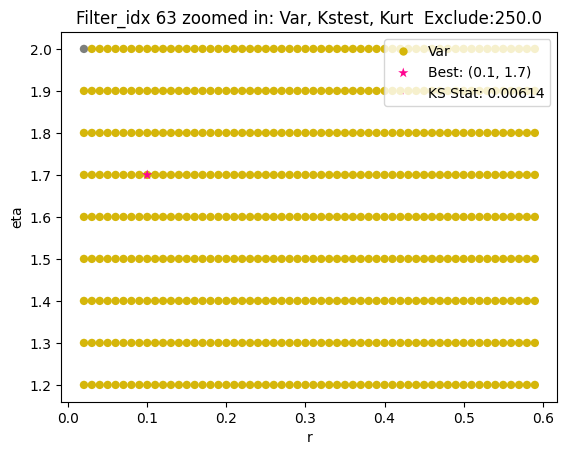

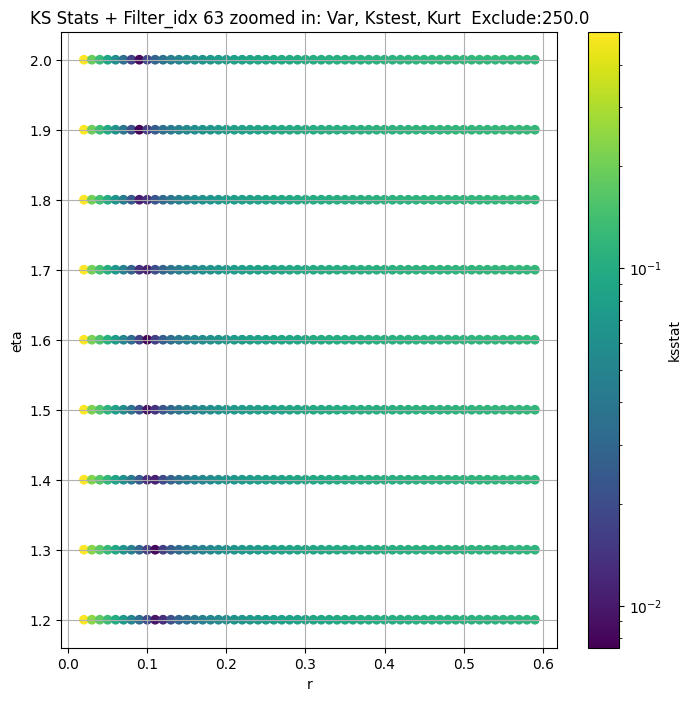

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,102.855110,34.849758,997.697198,1502.615755,7.320611,862.964342,786432000.0,dual_color,0.003532,0.1,...,3.000261e-16,200.0,41.302411,0.000048,0.002853,0.09,3.4,8.055507e-19,150.0,216000
2,139.086423,48.057759,1221.082277,1361.038621,5.617098,888.334774,786432000.0,dual_color,0.002496,0.1,...,8.541342e-16,100.0,64.243680,0.000048,0.002104,0.09,3.1,2.382352e-18,75.0,432000
3,59.225396,17.890088,677.785535,4588.658273,14.044662,919.821907,786432000.0,single_edge,0.006372,0.1,...,3.801138e-15,200.0,18.323851,0.000048,0.004367,0.11,1.7,2.846842e-13,275.0,96000
4,147.182613,50.443288,1229.274555,1431.721726,6.789153,824.932666,786432000.0,dual_color,0.002543,0.1,...,1.368008e-14,50.0,67.311362,0.000048,0.001342,0.12,1.4,6.359973e-11,75.0,1037968
5,61.703786,18.847785,682.077717,2256.644242,8.930134,918.159627,786432000.0,dual_color,0.004665,0.1,...,1.053687e-15,100.0,22.780789,0.000048,0.004578,0.11,2.3,8.790894e-14,150.0,91125
6,53.870009,16.817911,754.619495,3445.876441,7.006285,909.048889,786432000.0,single_edge,0.003904,0.1,...,2.724337e-16,200.0,20.437651,0.000048,0.003397,0.09,3.2,6.092242e-19,150.0,162000
7,73.311829,24.301443,517.953978,864.939042,6.691776,794.740489,786432000.0,inside_out,0.018666,0.2,...,8.498883e-06,200.0,25.498733,0.000048,0.018660,0.23,1.8,1.493361e-04,250.0,5062
8,2.374744,0.544201,65.257886,9343.251562,9.472070,970.760321,786432000.0,misc,0.017402,0.1,...,2.550898e-17,200.0,0.548827,0.000048,0.016641,0.10,2.7,1.183639e-17,300.0,6750
9,21.870066,3.657099,637.020372,13315.085018,13.594812,969.358189,786432000.0,multi_edge,0.014395,0.1,...,5.970165e-14,200.0,3.962029,0.000048,0.010499,0.09,0.9,8.725517e-17,275.0,17085


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group} zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

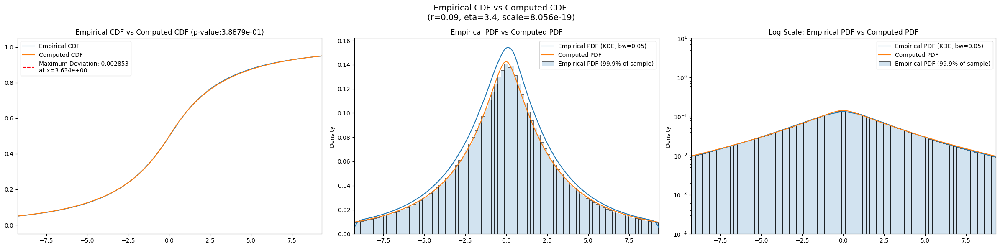

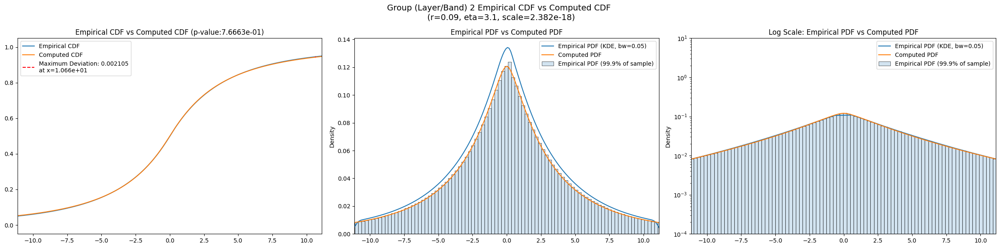

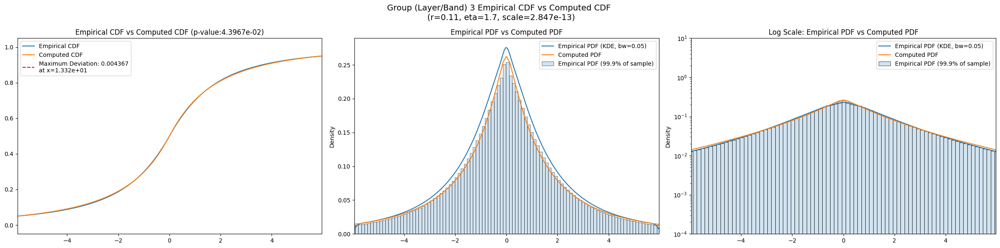

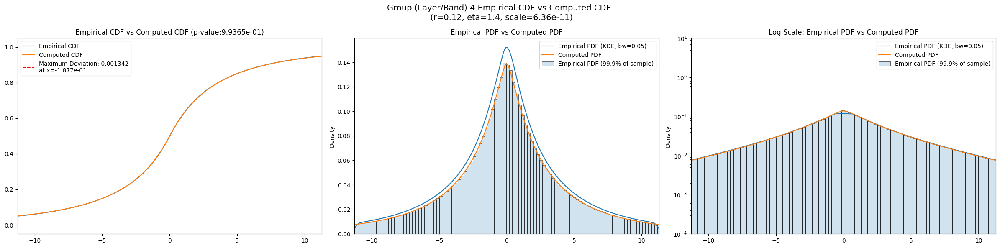

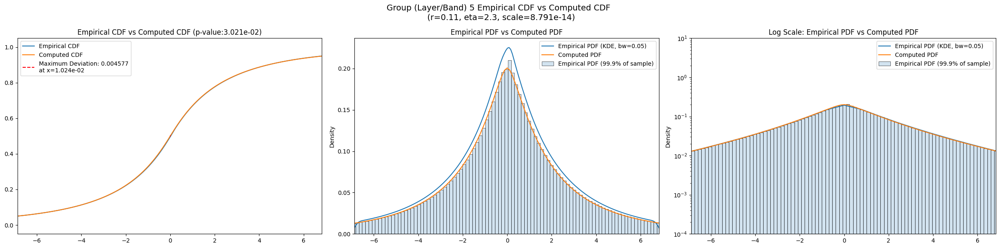

...

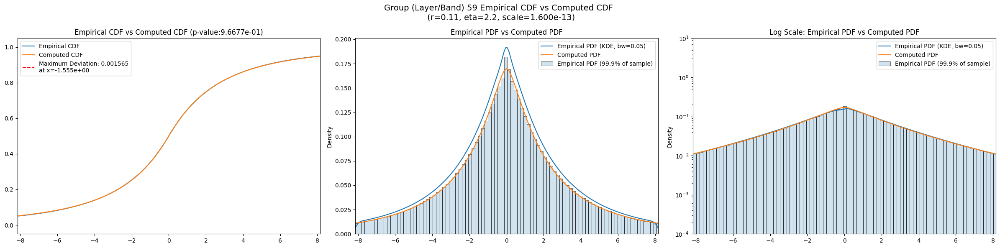

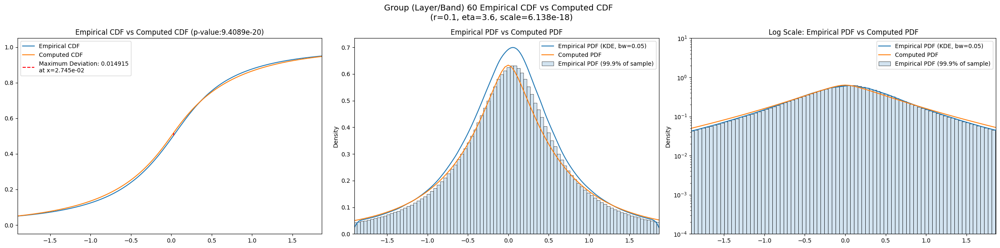

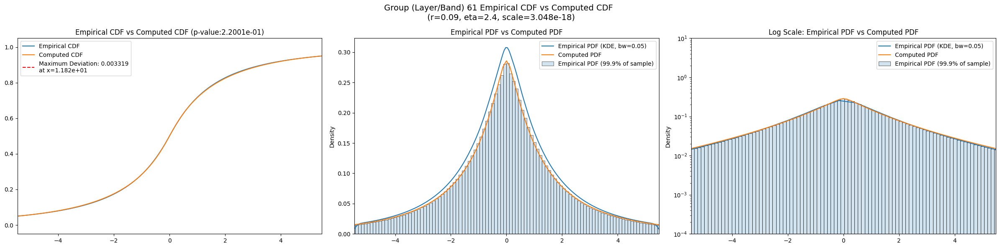

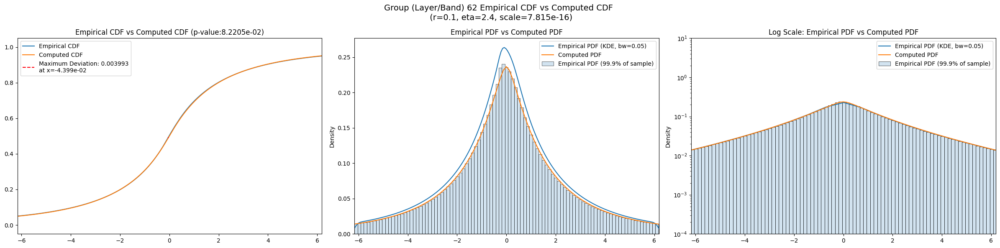

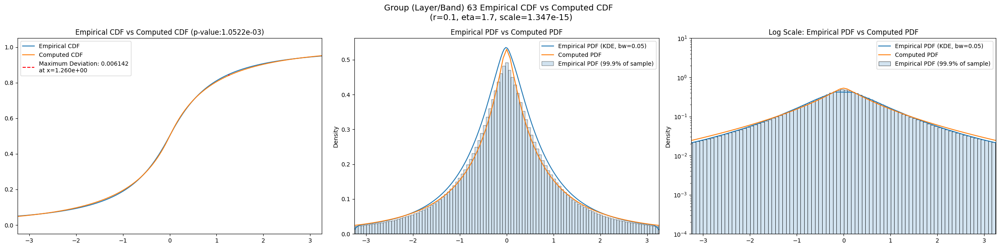

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = group)
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,102.855110,34.849758,997.697198,1502.615755,7.320611,862.964342,786432000.0,dual_color,0.003532,0.1,...,4.086760,0.039914,0.0,3.605530,0.014107,0.0,2.894760,0.011404,0.0,0.0
2,139.086423,48.057759,1221.082277,1361.038621,5.617098,888.334774,786432000.0,dual_color,0.002496,0.1,...,4.938300,0.039463,0.0,4.355070,0.012521,0.0,3.488340,0.013013,0.0,0.0
3,59.225396,17.890088,677.785535,4588.658273,14.044662,919.821907,786432000.0,single_edge,0.006372,0.1,...,2.476600,0.043847,0.0,2.202680,0.018783,0.0,1.736870,0.014477,0.0,0.0
4,147.182613,50.443288,1229.274555,1431.721726,6.789153,824.932666,786432000.0,dual_color,0.002543,0.1,...,4.671120,0.045741,0.0,4.107910,0.018353,0.0,3.285920,0.018878,0.0,0.0
5,61.703786,18.847785,682.077717,2256.644242,8.930134,918.159627,786432000.0,dual_color,0.004665,0.1,...,2.960340,0.042078,0.0,2.608440,0.014937,0.0,2.085900,0.015856,0.0,0.0
6,53.870009,16.817911,754.619495,3445.876441,7.006285,909.048889,786432000.0,single_edge,0.003904,0.1,...,2.834370,0.041484,0.0,2.507310,0.015277,0.0,1.990180,0.013507,0.0,0.0
7,73.311829,24.301443,517.953978,864.939042,6.691776,794.740489,786432000.0,inside_out,0.018666,0.2,...,3.667910,0.033066,0.0,3.502640,0.020605,0.0,2.739980,0.018660,0.0,0.0
8,2.374744,0.544201,65.257886,9343.251562,9.472070,970.760321,786432000.0,misc,0.017402,0.1,...,0.436999,0.048692,0.0,0.388594,0.022912,0.0,0.305048,0.019614,0.0,0.0
9,21.870066,3.657099,637.020372,13315.085018,13.594812,969.358189,786432000.0,multi_edge,0.014395,0.1,...,0.824328,0.061473,0.0,0.742230,0.037779,0.0,0.577973,0.031467,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.003532,0.000048,0.002853,0.039914,0.014107,0.011404
2,0.002496,0.000048,0.002104,0.039463,0.012521,0.013013
3,0.006372,0.000048,0.004367,0.043847,0.018783,0.014477
4,0.002543,0.000048,0.001342,0.045741,0.018353,0.018878
5,0.004665,0.000048,0.004578,0.042078,0.014937,0.015856
6,0.003904,0.000048,0.003397,0.041484,0.015277,0.013507
7,0.018666,0.000048,0.018660,0.033066,0.020605,0.018660
8,0.017402,0.000048,0.016641,0.048692,0.022912,0.019614
9,0.014395,0.000048,0.010499,0.061473,0.037779,0.031467


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,41.302411,0.002853,0.09,3.4,8.055507e-19,150.0
2,64.243680,0.002104,0.09,3.1,2.382352e-18,75.0
3,18.323851,0.004367,0.11,1.7,2.846842e-13,275.0
4,67.311362,0.001342,0.12,1.4,6.359973e-11,75.0
5,22.780789,0.004578,0.11,2.3,8.790894e-14,150.0
6,20.437651,0.003397,0.09,3.2,6.092242e-19,150.0
7,25.498733,0.018660,0.23,1.8,1.493361e-04,250.0
8,0.548827,0.016641,0.10,2.7,1.183639e-17,300.0
9,3.962029,0.010499,0.09,0.9,8.725517e-17,275.0
